<h1>
    <p>
    <br style ="font-family:UCL-SoM-Outline;color:#EA7600"> UCL </br> 
    <br style="font-family:UCL-SoM-Solid; color:#002147;"> School of </br> 
    <br style="font-family:UCL-SoM-Solid; color:#002147;"> Management </br> 
    </p>
</h1>

<h1>   
<p style="font-size:16pt",  align="center" >MSC BUSINESS ANALYTICS (WITH SPECIALISATION IN MANAGEMENT SCIENCE)</p>
<p style="font-size:16pt">CONSULTANCY PROJECT/DISSERTATION 2018-2019</p>
</h1> 
    
<h1>
    <p style="font-size:22pt", align="center"> SOCIAL NETWORK ANALYSIS OF CO-INNOVATION NETWORK OF THE UNITED KINGDOM </p> 
</h1>
    
<br>
<img src="./content/som_ft.png" width="70%"  align="right">


<h4>
<p style="font-size:16pt">WALTER HERNANDEZ</p>
</h4>

# 0. Environment

Before running this Jupyter notebook, please run the following bash script in Sherlock/Faculty or other linux server where this notebook is being executed. If the operating system is Windows or Mac OS, the commands would be the same in anaconda prompt.

The script does the following:
- Install all the necessary libraries for the correct execution of the code that followed after this section.

<br># Install libraries for geospatial visualisations
<br>conda install -c conda-forge geopandas
<br>conda install -c conda-forge folium
<br>pip install --upgrade fiona
<br>pip install shapely
<br>pip install geopy
<br>
<br># Installing the necessary libraries
<br>pip install missingno
<br>pip install tqdm
<br>pip install dill
<br>conda install -c pyviz holoviews bokeh
<br>conda install -c pyviz hvplot
<br>pip install pydot
<br>
<br># To render hvplots to png
<br>conda install -c conda-forge phantomjs
<br>conda install -c conda-forge selenium
<br>
<br># Install libraries needed for graph bundling (the edges) and datashading
<br>pip install xarray
<br>pip install datashader
<br>
<br># Install library for ForceAtlas2 layout
<br>pip install fa2
<br>
<br># To install altair and vega to get the D3 in python
<br>conda install -c conda-forge altair vega_datasets vega
<br>
<br># For other graphing of networks
<br>conda install -c conda-forge nxviz
<br>
<br># Sankey diagram using D3 as back end
<br>conda install -c conda-forge floweaver
<br>conda install -c conda-forge ipysankeywidget
<br>jupyter nbextension enable --py --sys-prefix ipysankeywidget
<br>jupyter nbextension enable --py --sys-prefix widgetsnbextension
<br>
<br># Library for community detection with Louvain algorithm
<br>pip install python-louvain
<br>
<br># Libraries needed for Natural Language Processing
<br>pip install wordcloud
<br>pip install pyLDAvis

# 1. Business Problem Framing

The Co-Innovation Mapping Pipeline, based in the Innovation Mapping pipeline of Nesta, defines the following questions to answer in this project:
- Where and when is co-innovation happening?
- Who are the co-innovator partners?
- How are the co-innovator partners connected?

# 2. Exploratory Data Analysis

In [9]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

## 2.1 Load dataset

In [312]:
#To create folder that will contain working files
!mkdir content 

Loads dataset made available by Innovate UK:

In [508]:
#Import required libraries
import pandas as pd

#Localtion of dataset
file = "https://assets.publishing.service.gov.uk/government/uploads/system/uploads/attachment_data/file/814391/Innovate_UK_funded_projects_between_2004_and_3_July_2019.xlsx"

#Load dataset
df = pd.read_excel(file)

Get view of first 5 rows in the dataset:

In [149]:
df.head()

,Competition Reference,Competition Title,Programme Title,Sector,Application Number,Project Number,Project Title,Public Description,Competition Year,Innovate UK Product Type,...,Total Costs (£),Actual Spend to Date (£),Participant Withdrawn From Project,Project Status,Enterprise Size,Postcode,Address Region,Address LEP,In Multiple LEPs,Industrial Strategy Challenge Fund (ISCF)
0,1811_FS_OLS_SMEIMT_R3,SME Support to Evaluate Innovative Medical Tec...,SME Support to Evaluate Innovative Medical Tec...,"Ageing Society, Health & Nutrition",30188,105334,MyVytalCare - Enabling Patients to Effectively...,"MyVytalCare is a comprehensive, multilingual, ...",2019/20,Collaborative R&D,...,NaN,NaN,Active,Offer Letter Sent,Micro/Small,W3 7DA,London,London,No,No
1,1811_FS_OLS_SMEIMT_R3,SME Support to Evaluate Innovative Medical Tec...,SME Support to Evaluate Innovative Medical Tec...,"Ageing Society, Health & Nutrition",30166,105335,Quantitative Magnetic Resonance Imaging in Bil...,Biliary diseases are hard to diagnose and moni...,2019/20,Collaborative R&D,...,"£227,782",£0,Active,Live,Medium,OX1 1BY,South East,Oxfordshire,No,No
2,1811_FS_OLS_SMEIMT_R3,SME Support to Evaluate Innovative Medical Tec...,SME Support to Evaluate Innovative Medical Tec...,"Ageing Society, Health & Nutrition",30160,105336,Home based digital urinalysis in antenatal pat...,Healthy.io will be testing smartphone-based ho...,2019/20,Collaborative R&D,...,"£201,000",£0,Active,Live,Micro/Small,N12 0DR,London,London,No,No
3,1811_FS_OLS_SMEIMT_R3,SME Support to Evaluate Innovative Medical Tec...,SME Support to Evaluate Innovative Medical Tec...,"Ageing Society, Health & Nutrition",29649,105337,Evaluation of an enhanced version of GDm-Healt...,This project will evaluate a new way to improv...,2019/20,Collaborative R&D,...,NaN,NaN,Active,Offer Letter Sent,Micro/Small,OX4 4GE,South East,Oxfordshire,No,No
4,1811_FS_OLS_SMEIMT_R3,SME Support to Evaluate Innovative Medical Tec...,SME Support to Evaluate Innovative Medical Tec...,"Ageing Society, Health & Nutrition",29649,105337,Evaluation of an enhanced version of GDm-Healt...,This project will evaluate a new way to improv...,2019/20,Collaborative R&D,...,NaN,NaN,Active,Offer Letter Sent,Academic,WC2R 2LS,London,London,No,No


Examine last 5 rows in dataset:

In [11]:
df.tail()

,Competition Reference,Competition Title,Programme Title,Sector,Application Number,Project Number,Project Title,Public Description,Competition Year,Innovate UK Product Type,...,Total Costs (£),Actual Spend to Date (£),Participant Withdrawn From Project,Project Status,Enterprise Size,Postcode,Address Region,Address LEP,In Multiple LEPs,Industrial Strategy Challenge Fund (ISCF)
36408,Apr-03,Legacy - CR&D,Legacy - CR&D,"Manufacturing, Materials & Mobility",EL394,210029,Towards Zero Emissions of NOx and Mercury from...,No abstract available.,2003/04,Collaborative R&D,...,954101.0,238794.48,Active,Closed,Large,PA4 8DJ,Scotland,NaN,No,No
36409,Apr-03,Legacy - CR&D,Legacy - CR&D,"Manufacturing, Materials & Mobility",EL394,210029,Towards Zero Emissions of NOx and Mercury from...,No abstract available.,2003/04,Collaborative R&D,...,0.0,0.00,Active,Closed,Large,CV4 8LG,West Midlands,Coventry and Warwickshire,No,No
36410,Apr-03,Legacy - CR&D,Legacy - CR&D,"Manufacturing, Materials & Mobility",EL394,210029,Towards Zero Emissions of NOx and Mercury from...,No abstract available.,2003/04,Collaborative R&D,...,0.0,0.00,Active,Closed,Academic,SW7 2AZ,London,London,No,No
36411,Apr-03,Legacy - CR&D,Legacy - CR&D,"Manufacturing, Materials & Mobility",EL394,210029,Towards Zero Emissions of NOx and Mercury from...,No abstract available.,2003/04,Collaborative R&D,...,0.0,0.00,Active,Closed,Small,BR5 3HP,London,London,No,No
36412,Apr-03,Legacy - CR&D,Legacy - CR&D,"Manufacturing, Materials & Mobility",EL394,210029,Towards Zero Emissions of NOx and Mercury from...,No abstract available.,2003/04,Collaborative R&D,...,0.0,0.00,Active,Closed,Academic,NG7 2RD,East Midlands,"Derby, Derbyshire, Nottingham and Nottinghamshire",No,No


Examine the data types of each column:

In [187]:
df.dtypes #Find out the types of the data

Competition Reference                        object
Competition Title                            object
Programme Title                              object
Sector                                       object
Application Number                           object
Project Number                                int64
Project Title                                object
Public Description                           object
Competition Year                             object
Innovate UK Product Type                     object
Participant Name                             object
Is Lead Participant                          object
CRN                                          object
Project Start Date                           object
Project End Date                             object
Grant Offered (£)                            object
Total Costs (£)                              object
Actual Spend to Date (£)                     object
Participant Withdrawn From Project           object
Project Stat

Examine the naming of the columns:

In [188]:
df.columns

Index(['Competition Reference', 'Competition Title', 'Programme Title',
       'Sector', 'Application Number', 'Project Number', 'Project Title',
       'Public Description', 'Competition Year', 'Innovate UK Product Type',
       'Participant Name', 'Is Lead Participant', 'CRN', 'Project Start Date',
       'Project End Date', 'Grant Offered (£)', 'Total Costs (£)',
       'Actual Spend to Date (£)', 'Participant Withdrawn From Project',
       'Project Status', 'Enterprise Size', 'Postcode', 'Address Region',
       'Address LEP', 'In Multiple LEPs',
       'Industrial Strategy Challenge Fund (ISCF)'],
      dtype='object')

Remove special characters and replace spaces for '_' between the words of each columns:

In [509]:
# Remove "(£)"  and other initials within parentheses
# while removing any trailing whitespace with .strip:
df.columns = df.columns.str.replace(r"\(.*?\)", '').str.strip()

# Remove white spaces in column names for "_"
df.columns = df.columns.str.replace(' ', '_')

Column names after making the changes above:

In [40]:
df.columns

Index(['Competition_Reference', 'Competition_Title', 'Programme_Title',
       'Sector', 'Application_Number', 'Project_Number', 'Project_Title',
       'Public_Description', 'Competition_Year', 'Innovate_UK_Product_Type',
       'Participant_Name', 'Is_Lead_Participant', 'CRN', 'Project_Start_Date',
       'Project_End_Date', 'Grant_Offered', 'Total_Costs',
       'Actual_Spend_to_Date', 'Participant_Withdrawn_From_Project',
       'Project_Status', 'Enterprise_Size', 'Postcode', 'Address_Region',
       'Address_LEP', 'In_Multiple_LEPs',
       'Industrial_Strategy_Challenge_Fund'],
      dtype='object')

Change the data type of the columns Is_Lead_Participant and Industrial_Strategy_Challenge_Fund to binary:

In [510]:
# Use .str to find the "Yes" and convert it to binary = 1
df["Is_Lead_Participant"] = df["Is_Lead_Participant"].str.contains('Yes').astype(int)

# Use .str to find the "Yes" and convert it to binary = 1
df["Industrial_Strategy_Challenge_Fund"] = df["Industrial_Strategy_Challenge_Fund"].str.contains('Yes').astype(int)

See the changes performed in the data types of the two columns above:

In [42]:
df.dtypes #Find out the types of the data

Competition_Reference                 object
Competition_Title                     object
Programme_Title                       object
Sector                                object
Application_Number                    object
Project_Number                         int64
Project_Title                         object
Public_Description                    object
Competition_Year                      object
Innovate_UK_Product_Type              object
Participant_Name                      object
Is_Lead_Participant                    int64
CRN                                   object
Project_Start_Date                    object
Project_End_Date                      object
Grant_Offered                         object
Total_Costs                           object
Actual_Spend_to_Date                  object
Participant_Withdrawn_From_Project    object
Project_Status                        object
Enterprise_Size                       object
Postcode                              object
Address_Re

## 2.2 Summary statistics

Look at the composition, distribution, and other factors of the dataset:

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fb7585548d0>,
      dtype=object)

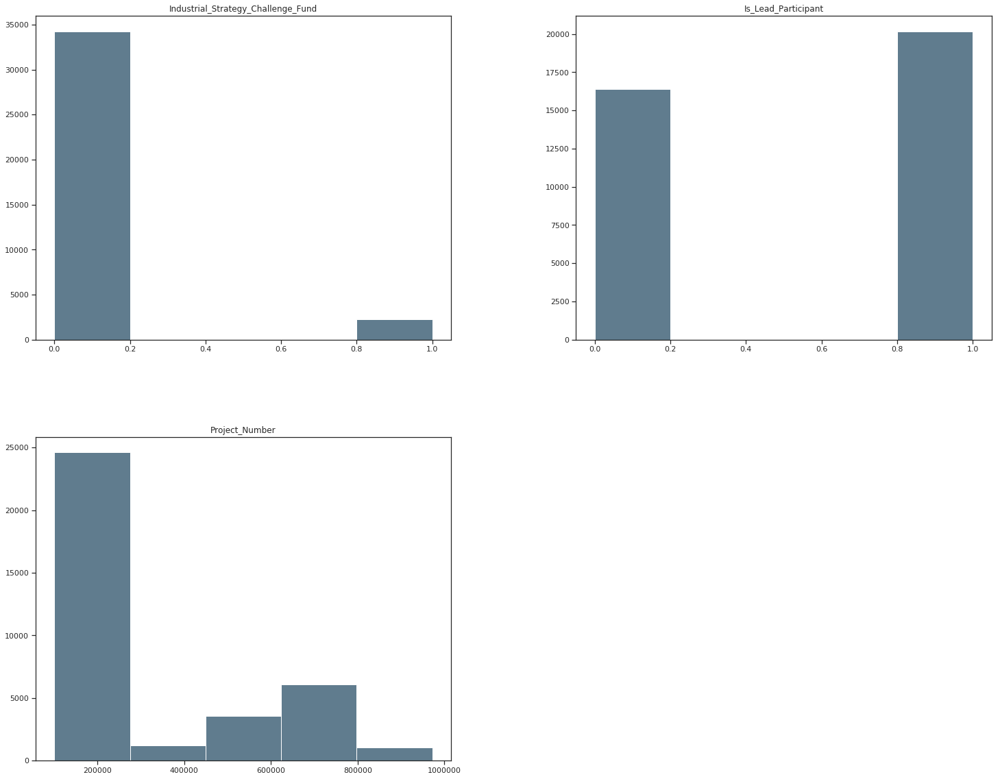

In [155]:
df.hist(bins=5, grid=False, figsize=(25,20), color='#607c8e', zorder=2, rwidth=3)

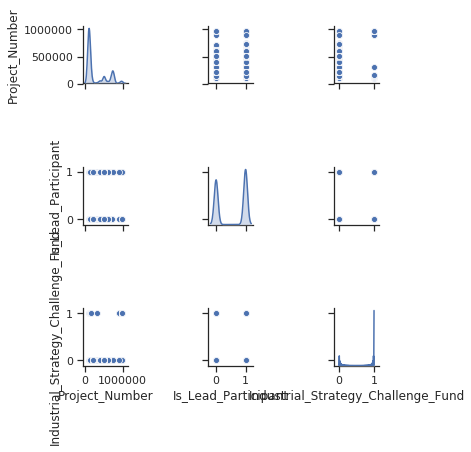

In [245]:
sns.set(style="ticks")
sns.pairplot(df, height = 2 ,kind ='scatter',diag_kind='kde')
plt.show()

## 2.3 Descriptive statistics

In [32]:
# Create directory to save descriptive graphs
!mkdir -p content/descriptive_graphs

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas

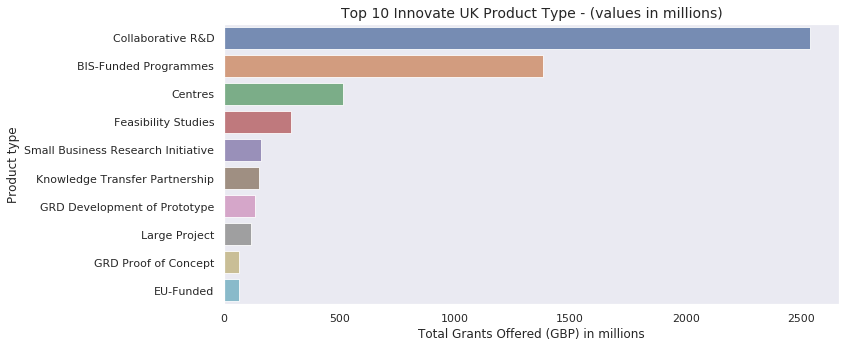

In [511]:
#Drop NaN
InnovateUKproducts=df.dropna()

#Convert values to float
InnovateUKproducts['Grant_Offered'] = [x.replace("£","") for x in InnovateUKproducts['Grant_Offered']]
InnovateUKproducts['Grant_Offered'] = [float(x.replace(",","")) for x in InnovateUKproducts['Grant_Offered']]
InnovateUKproducts['Grant_Offered'] = pd.to_numeric(InnovateUKproducts['Grant_Offered'])

#Grouping by type of Innovate UK Products
InnovateUKproducts = InnovateUKproducts.groupby(['Innovate_UK_Product_Type']).Grant_Offered.sum().reset_index(name='Total_Grant_Offered_GBP')
InnovateUKproducts = InnovateUKproducts.sort_values(by=['Total_Grant_Offered_GBP'], ascending=False)

#Filtering the top 10 Innovate UK Type Products
InnovateUKproducts = InnovateUKproducts.iloc[:10,]

# Convert totals to equivalent in millions
InnovateUKproducts['Total_Grant_Offered_GBP'] = InnovateUKproducts['Total_Grant_Offered_GBP'] / 1000000

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=InnovateUKproducts.Total_Grant_Offered_GBP, y=InnovateUKproducts.Innovate_UK_Product_Type, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 Innovate UK Product Type - (values in millions)',fontsize=14)
_=plt.ylabel('Product type', fontsize=12)
_=plt.xlabel('Total Grants Offered (GBP) in millions', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 Innovate UK Product Type - values in millions.png', format='png', dpi=400)

# Display graph
plt.show()

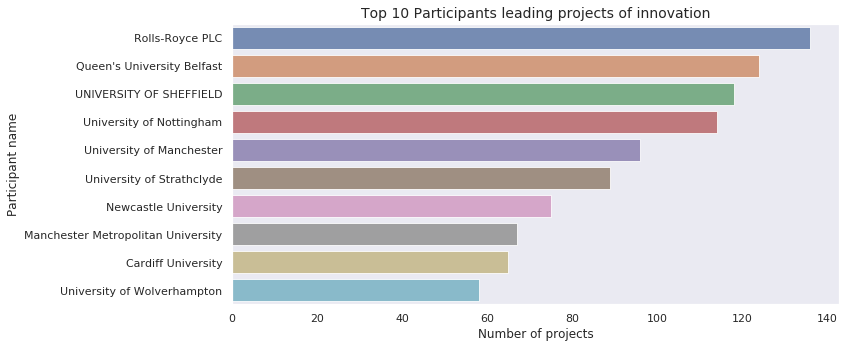

In [512]:
#Grouping by leading participants of Innovate UK projects
LeadingParticipants = df.groupby(['Participant_Name']).Is_Lead_Participant.value_counts().reset_index(name='Number_Projects')
LeadingParticipants = LeadingParticipants.sort_values(by=['Number_Projects'], ascending=False)

# Filtering the top 10 Participants leading projects
LeadingParticipants = LeadingParticipants[LeadingParticipants['Is_Lead_Participant'] == True]
LeadingParticipants = LeadingParticipants.iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=LeadingParticipants.Number_Projects, y=LeadingParticipants.Participant_Name, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 Participants leading projects of innovation',fontsize=14)
_=plt.ylabel('Participant name', fontsize=12)
_=plt.xlabel('Number of projects', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 Participants leading projects of innovation.png', format='png', dpi=400)

# Display graph
plt.show()

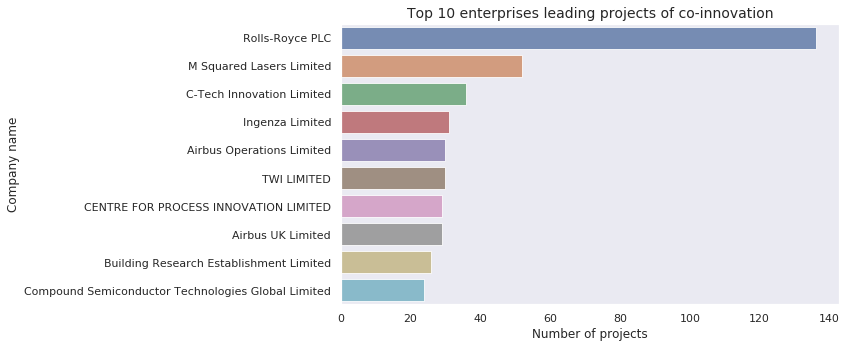

In [513]:
# Filtering the top 10 Participants leading projects
LeadingParticipants_NonUnis = df[df['Is_Lead_Participant'] == 1]

# Filter all non-universities
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis[~LeadingParticipants_NonUnis["Participant_Name"].str.contains(r'University')]
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis[~LeadingParticipants_NonUnis["Participant_Name"].str.contains(r'UNIVERSITY')]
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis[~LeadingParticipants_NonUnis["Participant_Name"].str.contains(r'College')]

#Grouping by companies leading Innovate UK projects
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis.groupby(['Participant_Name']).Is_Lead_Participant.value_counts().reset_index(name='Number_Projects')
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis.sort_values(by=['Number_Projects'], ascending=False)

# Filtering the top 10 Participants leading projects
LeadingParticipants_NonUnis = LeadingParticipants_NonUnis.iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=LeadingParticipants_NonUnis.Number_Projects, y=LeadingParticipants_NonUnis.Participant_Name, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 enterprises leading projects of co-innovation',fontsize=14)
_=plt.ylabel('Company name', fontsize=12)
_=plt.xlabel('Number of projects', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 enterprises leading projects of co-innovation.png', format='png', dpi=400)

# Display graph
plt.show()

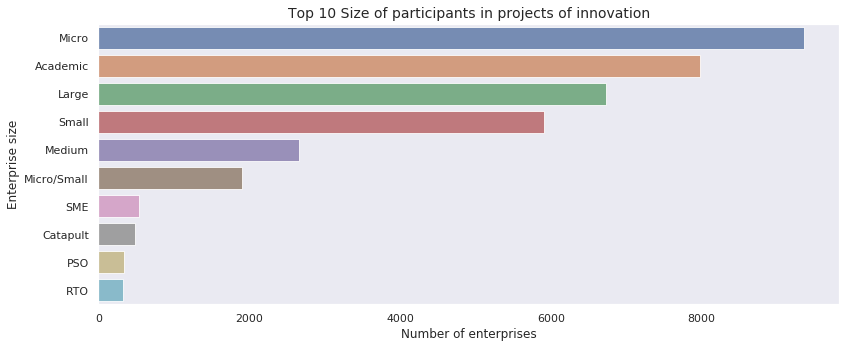

In [514]:
#Grouping by participants name
EnterpriseSizes = df.groupby(['Participant_Name']).Enterprise_Size.value_counts().reset_index(name='Number_Projects')

#Remove duplicates companies that could be counted twice within a category of an enterprise size
EnterpriseSizes.drop_duplicates(subset ="Participant_Name", 
                     keep = False, inplace = True) 

# Count the size of enterprises innovating in UK
EnterpriseSizes = df['Enterprise_Size'].value_counts()

#Filtering the top 10 Participants leading projects
EnterpriseSizes = EnterpriseSizes[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=EnterpriseSizes.values, y=EnterpriseSizes.index, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 Size of participants in projects of innovation',fontsize=14)
_=plt.ylabel('Enterprise size', fontsize=12)
_=plt.xlabel('Number of enterprises', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 Size of participants in projects of innovation.png', format='png', dpi=400)

# Display graph
plt.show()

In [515]:
# Remove all the values after "/" to leave only the year
df['Competition_Year'] = df['Competition_Year'].str.split('/').str[0]

#Drop NaN
# Find the projects with no missing data
ProjNumbAllData = list(set(list(df[df["Grant_Offered"].notnull()]['Project_Number'])))

# Filter only the rows with the projects with no missing data in grants offered
# These are the projects that are likely to have happened
Competition_Year_Grants = df[df['Project_Number'].isin(ProjNumbAllData)]

#Convert values to float
Competition_Year_Grants['Grant_Offered'] = [x.replace("£","") for x in Competition_Year_Grants['Grant_Offered']]
Competition_Year_Grants['Grant_Offered'] = [float(x.replace(",","")) for x in Competition_Year_Grants['Grant_Offered']]
Competition_Year_Grants['Grant_Offered'] = pd.to_numeric(Competition_Year_Grants['Grant_Offered'])

#Investment per year 
Competition_Year_Grants_average = Competition_Year_Grants.groupby(['Competition_Year']).Grant_Offered.mean().reset_index(name='Average_Grant_Offered')
Competition_Year_Grants_average['Average_Grant_Offered'] = Competition_Year_Grants_average.Average_Grant_Offered / 1000000

# Filter 2019 out because the year has not ended
Competition_Year_Grants_average = Competition_Year_Grants_average[Competition_Year_Grants_average['Competition_Year']!='2019']

Competition_Year_Grants_average.head()

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pan

,Competition_Year,Average_Grant_Offered
0,2003,1.025009
1,2004,0.123129
2,2005,0.133482
3,2006,0.125300
4,2007,0.189544


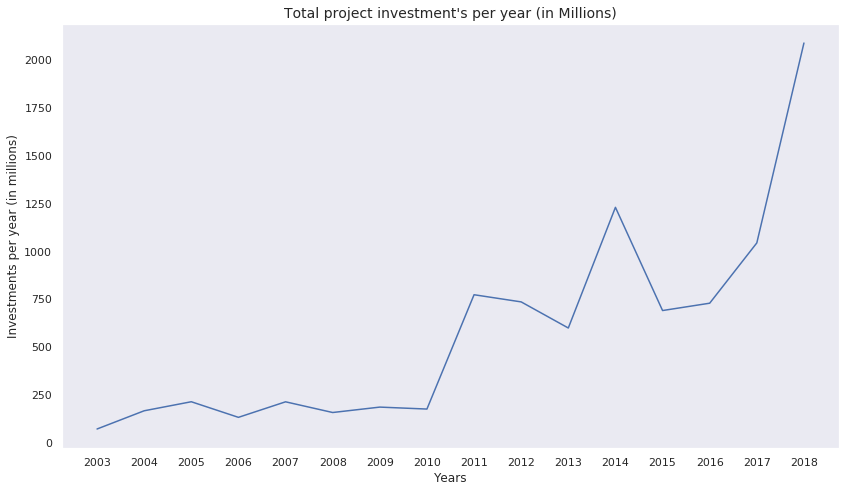

In [516]:
#Investment per year 
Competition_Year_Grants_total = Competition_Year_Grants.groupby(['Competition_Year']).Grant_Offered.sum().reset_index(name='Total_Grant_Offered')
Competition_Year_Grants_total['Total_Grant_Offered'] = Competition_Year_Grants_total.Total_Grant_Offered / 1000000

# Filter 2019 out because the year has not ended
Competition_Year_Grants_total = Competition_Year_Grants_total[Competition_Year_Grants_total['Competition_Year']!='2019']

# Create figure
_=plt.figure(figsize=(12,7))

_=sns.lineplot(x="Competition_Year", y="Total_Grant_Offered", data=Competition_Year_Grants_total,markers=True, dashes=False)

# Descriptions the plot
_=plt.title('Total project investment\'s per year (in Millions)',fontsize=14)
_=plt.ylabel('Investments per year (in millions)', fontsize=12)
_=plt.xlabel('Years', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Total investment\'s per year in Millions.png', format='png', dpi=400)

# Display graph
plt.show()

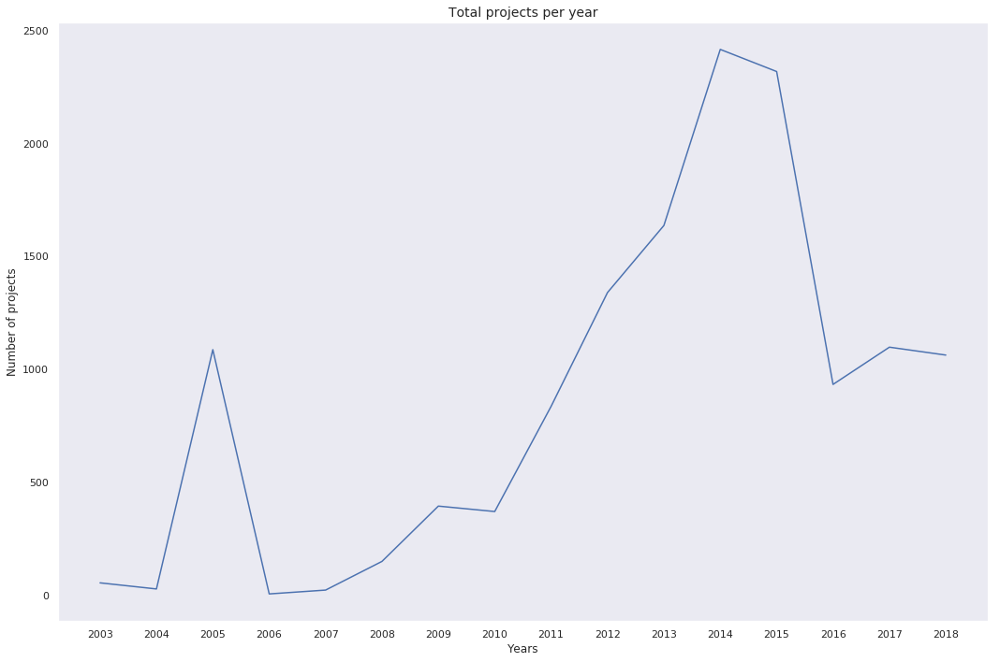

In [517]:
# Total_Projects = (df.groupby('Competition_Year').Project_Number.value_counts().reset_index(name='Total_Projects')).dop(columns=['Project_Number'])
Total_Projects = df[['Competition_Year','Project_Number']].copy()

# leave only the unique project numbers per year
Total_Projects.drop_duplicates(subset ="Project_Number", keep = False, inplace = True)

# Remove all the values after "/" to leave only the year
Total_Projects['Competition_Year'] = Total_Projects['Competition_Year'].str.split('/').str[0]

# Count all the projects per year
Total_Projects = Total_Projects['Competition_Year'].value_counts().reset_index(name="Total_projects").rename(columns={'index':'Competition_Year'}, inplace=False)
Total_Projects = Total_Projects.sort_values(by=['Competition_Year'], ascending=True)

# Filter 2019 out because the year has not ended
Total_Projects = Total_Projects[Total_Projects['Competition_Year']!='2019']

# Create figure
_=plt.figure(figsize=(15,10))

# Plot projects per year
_=sns.lineplot(x="Competition_Year", y="Total_projects", data=Total_Projects ,markers=True, dashes=False)

# Descriptions the plot
_=plt.title('Total projects per year',fontsize=14)
_=plt.ylabel('Number of projects', fontsize=12)
_=plt.xlabel('Years', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Total projects per year.png', format='png', dpi=400)

# Display graph
plt.show()

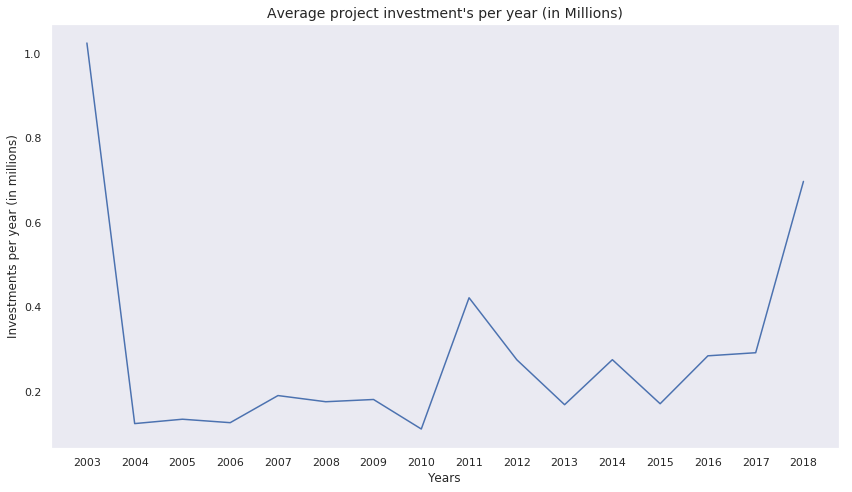

In [42]:
_=plt.figure(figsize=(12,7))

_=sns.lineplot(x="Competition_Year", y="Average_Grant_Offered", data=Competition_Year_Grants_average,markers=True, dashes=False)

# Descriptions the plot
_=plt.title('Average project investment\'s per year (in Millions)',fontsize=14)
_=plt.ylabel('Investments per year (in millions)', fontsize=12)
_=plt.xlabel('Years', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Average project investment\'s per year.png', format='png', dpi=1200)

# Display graph
plt.show()

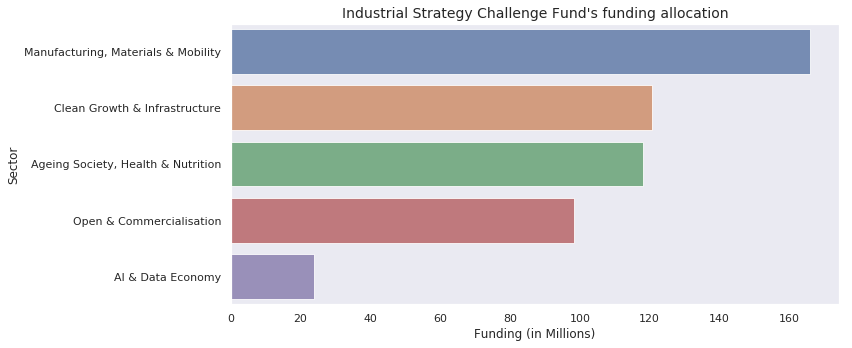

In [518]:
# Filtering only the values for the Industrial_Strategy_Challenge_Fund
Industrial_Strategy_Challenge_Fund = df[df['Industrial_Strategy_Challenge_Fund'] == 1]

#Drop NaN
Industrial_Strategy_Challenge_Fund=Industrial_Strategy_Challenge_Fund.dropna()

# Remove any trailing characters
Industrial_Strategy_Challenge_Fund['Sector'] = [x.rstrip() for x in Industrial_Strategy_Challenge_Fund['Sector']]

#Convert values to float
Industrial_Strategy_Challenge_Fund['Grant_Offered'] = [x.replace("£","") for x in Industrial_Strategy_Challenge_Fund['Grant_Offered']]
Industrial_Strategy_Challenge_Fund['Grant_Offered'] = [float(x.replace(",","")) for x in Industrial_Strategy_Challenge_Fund['Grant_Offered']]
Industrial_Strategy_Challenge_Fund['Grant_Offered'] = pd.to_numeric(Industrial_Strategy_Challenge_Fund['Grant_Offered'])

# Add up all grants
Industrial_Strategy_Challenge_Fund = Industrial_Strategy_Challenge_Fund.groupby(['Sector']).Grant_Offered.sum().reset_index(name='Total_Grant_Offered')
Industrial_Strategy_Challenge_Fund['Total_Grant_Offered'] = Industrial_Strategy_Challenge_Fund.Total_Grant_Offered / 1000000

#Filtering the top 10 sectors of investment for the Industrial_Strategy_Challenge_Fund
Industrial_Strategy_Challenge_Fund = Industrial_Strategy_Challenge_Fund.iloc[:10,]
Industrial_Strategy_Challenge_Fund = Industrial_Strategy_Challenge_Fund.sort_values(by=['Total_Grant_Offered'], ascending=False)

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=Industrial_Strategy_Challenge_Fund.Total_Grant_Offered, y=Industrial_Strategy_Challenge_Fund.Sector, alpha=0.8)

# Descriptions the plot
_=plt.title('Industrial Strategy Challenge Fund\'s funding allocation',fontsize=14)
_=plt.ylabel('Sector', fontsize=12)
_=plt.xlabel('Funding (in Millions)', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Industrial Strategy Challenge Fund\'s funding allocation.png', format='png', dpi=400)

# Display graph
plt.show()

# 3. Data preparation

## 3.1 Data Cleaning

### 3.1.1 Identify features with missing values 

Before starting the network analysis and further topic modelling, it is important to check if there is missing data in the relevant columns:

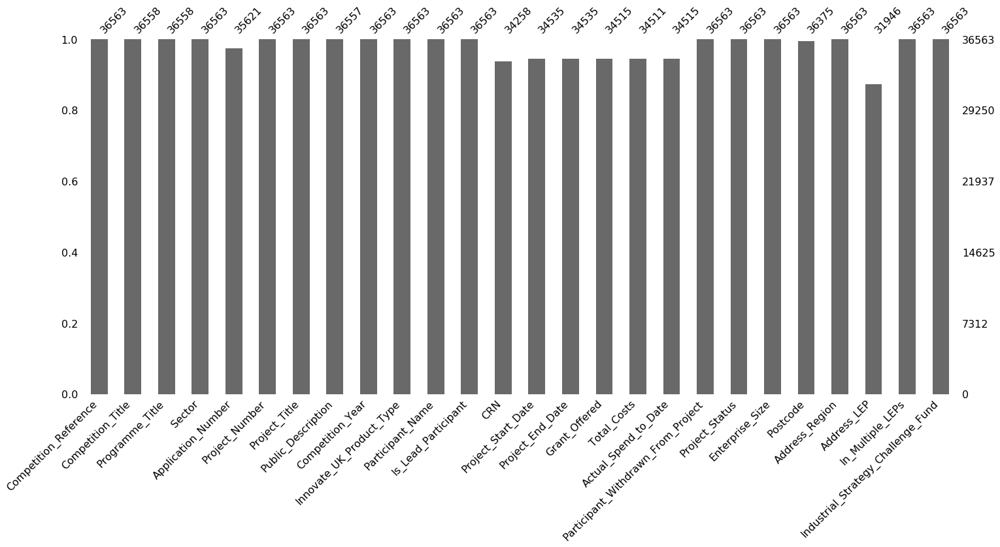

In [18]:
import missingno as msno

msno.bar(df)

Especifically, the percentage of missing data in each column is:

In [19]:
# To show the percentage of missing data
df.count(0)/df.shape[0] * 100

Competition_Reference                 100.000000
Competition_Title                      99.986325
Programme_Title                        99.986325
Sector                                100.000000
Application_Number                     97.423625
Project_Number                        100.000000
Project_Title                         100.000000
Public_Description                     99.983590
Competition_Year                      100.000000
Innovate_UK_Product_Type              100.000000
Participant_Name                      100.000000
Is_Lead_Participant                   100.000000
CRN                                    93.695813
Project_Start_Date                     94.453409
Project_End_Date                       94.453409
Grant_Offered                          94.398709
Total_Costs                            94.387769
Actual_Spend_to_Date                   94.398709
Participant_Withdrawn_From_Project    100.000000
Project_Status                        100.000000
Enterprise_Size     

### 3.1.2 Treatment of missing data 

Despite that there is missing data in the dataset, most of the columns of interest for the network analysis and topic modelling do not have missing data. These columns are:
- Participant_Name
- Sector 
- Project_Number
- Project_Title
- Competition_Year
- Innovate_UK_Product_Type
- Enterprise_Size
- Address_Region

Therefore, it is not necessary to drop missing data for these columns. In the case of the following columns with missing data:
- Public_Description
- Programme_Title
- Grant_Offered

The rows corresponding to the project number with no "Public_Description" and "Programme_Title" are dropped since the empty data is less than 0.1%. On the other hand, "Grant_Offered" has more than 5% of missing data, which has to be dropped because projects without a detail of "Grant_Offered" is safe to assume that they did not happen. Also, only the columns describe here as needed for the next sections are kept in the dataframe.

In [24]:
# Select only the columns to use for the analysis
column_names = ['Participant_Name', 'Programme_Title','Sector','Project_Number',
                'Project_Title','Competition_Year','Public_Description', 
                'Innovate_UK_Product_Type','Enterprise_Size','Grant_Offered','Address_Region']

df = df[column_names]

# Save original number of rows
OriginalNumbRows = df.shape[0]

In [25]:
# Find the projects with no missing data
ProjNumbAllData = list(set(list(df[(df["Public_Description"].notnull()) & 
                                   (df["Programme_Title"].notnull()) &
                                  (df["Grant_Offered"].notnull())]['Project_Number'])))

# Filter only the rows with the projects with no missing data
df = df[df['Project_Number'].isin(ProjNumbAllData)]

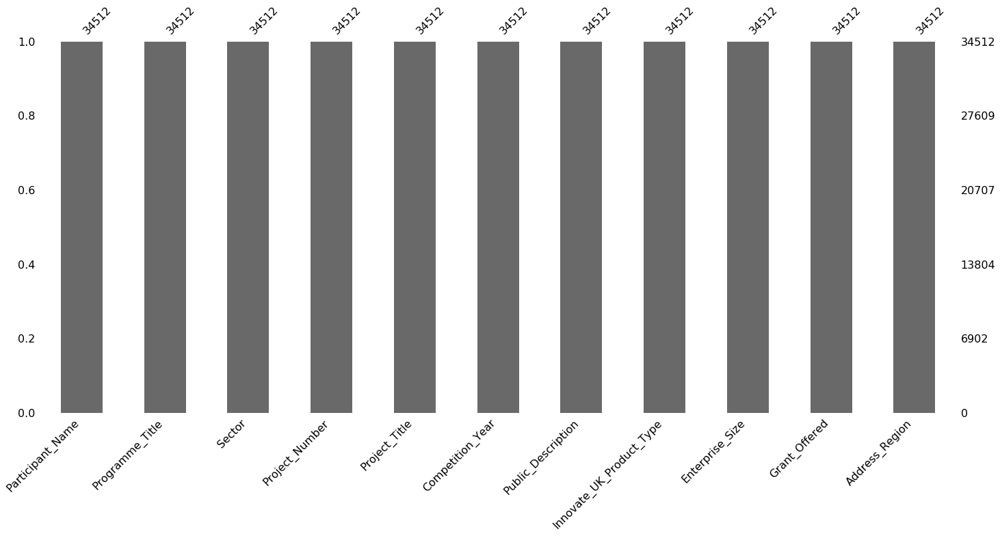

In [22]:
import missingno as msno

msno.bar(df)

In [26]:
# To show the percentage of missing data
df.count(0)/df.shape[0] * 100

Participant_Name            100.0
Programme_Title             100.0
Sector                      100.0
Project_Number              100.0
Project_Title               100.0
Competition_Year            100.0
Public_Description          100.0
Innovate_UK_Product_Type    100.0
Enterprise_Size             100.0
Grant_Offered               100.0
Address_Region              100.0
dtype: float64

In [46]:
NewNumbRows = df.shape[0]
print("Number of rows removed from original dataframe: {}".format(OriginalNumbRows - NewNumbRows))

Number of rows removed from original dataframe: 2051


Before saving the dataframe, all the legal identities of Cisco that have work in different co-innovation projects are consolidated as "Cisco" with the purpose of showing all the edges of Cisco:

In [27]:
# Getting all of Cisco legal entities
Cisco_entities = df[df["Participant_Name"].str.contains(r'Cisco')]
Cisco_entities = Cisco_entities.append(df[df["Participant_Name"].str.contains(r'CISCO')])
Cisco_entities = list(set(list(Cisco_entities['Participant_Name'])))

# Merge the three legal entities rows as Cisco
for entity in Cisco_entities:
    df['Participant_Name'] = df['Participant_Name'].str.replace(entity,'Cisco')

Also, the format of the values in the columns 'Grant_Offered' and 'Competition_Year' need corrections:

In [28]:
#Convert values to float
df['Grant_Offered'] = [x.replace("£","") for x in df['Grant_Offered']]
df['Grant_Offered'] = [float(x.replace(",","")) for x in df['Grant_Offered']]
df['Grant_Offered'] = pd.to_numeric(df['Grant_Offered'])

# Remove all the values after "/" to leave only the year
df['Competition_Year'] = df['Competition_Year'].str.split('/').str[0]
df['Competition_Year'] = df['Competition_Year'].astype(int)

# Remove any trailing characters
df['Sector'] = [x.rstrip() for x in df['Sector']]

### 3.1.3 Save dataframe with no missing data

In [29]:
import pickle

pickle.dump(df, open( "/project/content/df.p", "wb" ) )

To load back the saved dataframe:

In [2]:
import pickle

df = pickle.load(open("/project/content/df.p", "rb"))

## 3.2 Prepare data for creation and plotting of co-innovation network

The next step is to create a dataframe with all the edges. This dataframe would be used to generate the networkx file for graphing and getting relevant statistics about the network:

In [30]:
# Import tqdm to check the progress of the loop
from tqdm import tqdm

# Create empty dataframe to save the network of the projects
networkDF = pd.DataFrame()

# Get unique number of projects to use as identifier to loop and create the edges between
# each of the companies that work together in the same project
Project_Number = set(list(df['Project_Number']))

for projNumb in tqdm(Project_Number):

    # Itireate over all the projects to get the names of the participants:
    Participant_Names = df[df["Project_Number"]==projNumb]
    
    # Create two lists for looping over them for the building of the edges/relationships between them
    listParticipants = list(Participant_Names["Participant_Name"])
    DuplicatelistParticipants = list(Participant_Names["Participant_Name"])

    for participant in listParticipants:

        for duplicateParticipant in DuplicatelistParticipants:
            
            # If it is the same company in the two lists, a relationship is not created
            if participant != duplicateParticipant:
                
                # Save results in pandas' dataframe to be used for the mapping of the networks by
                # sector and their evolution through time
                networkDF = networkDF.append(pd.DataFrame([participant,
                                                           duplicateParticipant,
                                                           projNumb,
                                                          Participant_Names['Sector'].iloc[0],
                                                          Participant_Names['Innovate_UK_Product_Type'].iloc[0],
                                                          Participant_Names['Competition_Year'].iloc[0],
                                                           Participant_Names['Enterprise_Size'].iloc[0],
                                                          Participant_Names['Project_Title'].iloc[0]]).T,
                                             ignore_index=True)

100%|██████████| 18811/18811 [09:54<00:00, 31.67it/s] 


In [31]:
# Update the name of the columns of the network dataframe
columns_names = ['Source', 
                 'Target',
                 'Project_Number',
                 'Sector',
                 'Innovate_UK_Product_Type',
                 'Competition_Year',
                 'Enterprise_Size',
                 'Project_Title']

networkDF.columns = columns_names

networkDF.columns

Index(['Source', 'Target', 'Project_Number', 'Sector',
       'Innovate_UK_Product_Type', 'Competition_Year', 'Enterprise_Size',
       'Project_Title'],
      dtype='object')

Save the dataframe with all the network relationships:

In [32]:
import pickle

pickle.dump(networkDF, open( "/project/content/networkDF.p", "wb" ))

Load back the dataframe with all the network relationships:

In [3]:
import pickle

networkDF = pickle.load(open("/project/content/networkDF.p", "rb"))

# 4. Network Analysis

Create the network with the networkDF dataframe prepared in the previous steps:

In [4]:
# Import networkx
import networkx as nx

# Create retweet network from pandas dataframe
G = nx.from_pandas_edgelist(
    networkDF,
    source = 'Source',
    target = 'Target',
    edge_attr=True, # to keep all the attributes or other columns in the dataframe related with each edge
    create_using = nx.Graph())

# Add the degree for each node
for n, d in G.nodes(data=True):

    # Calculate the degree of each node: G.node[n]['degree']
    G.node[n]['degree'] = nx.degree(G,n)
    
# Print the number of nodes
print('Nodes in Co-innovation network:', len(G.nodes()))

# Print the number of edges
print('Edges in Co-innovation network:', len(G.edges()))

Nodes in Co-innovation network: 8624
Edges in Co-innovation network: 36978


Get information about the composition of the network:

In [4]:
print(nx.info(G))

Name: 
Type: Graph
Number of nodes: 8624
Number of edges: 36978
Average degree:   8.5756


Plot the network:

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


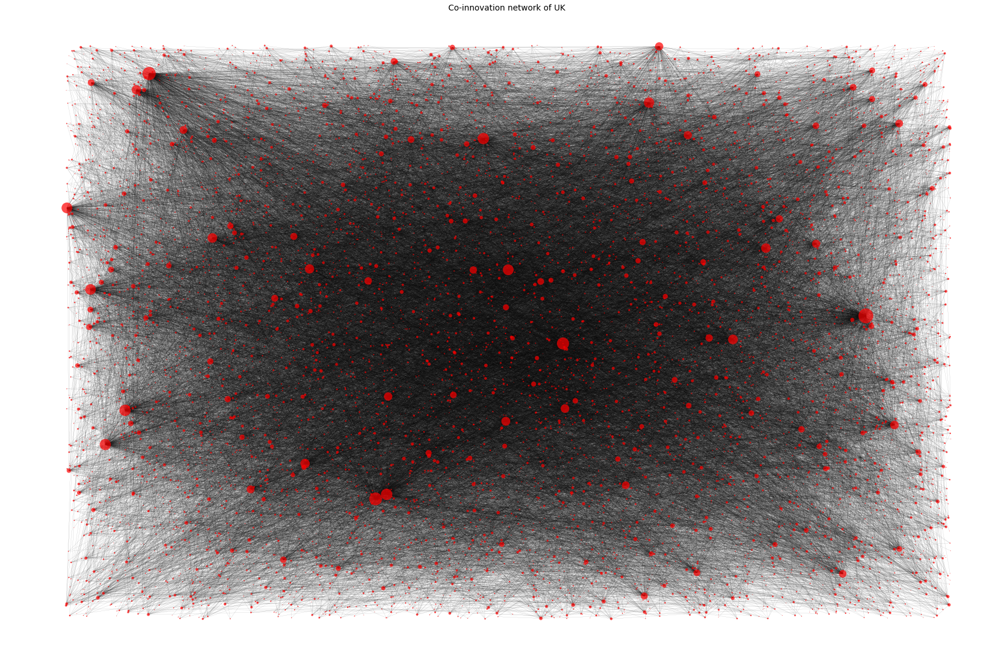

In [21]:
# Import pyplot
import matplotlib.pyplot as plt

# Creating visualization
plt.figure(figsize=(30,20))

# Create random layout positions
pos = nx.random_layout(G)

# # Create list with size for each node according 
# # to their degrees or number of neighbors that it has
# sizes = [x[1] for x in G.degree()]
sizes = [G.node[n]['degree'] for n, d in G.nodes(data=True)]

# Draw the network
nx.draw_networkx(G, 
                 pos, 
                 with_labels = False, 
                 node_size = sizes,
                 width = 0.1, alpha = 0.7,
                 arrowsize = 2, linewidths = 0)

# Turn axis off and show
_=plt.title('Co-innovation network of UK',fontsize=14)
plt.axis('off'); plt.show()

The network graphs looks a bit messy. Making some changes in the plotting may improve the visualisation of it:

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


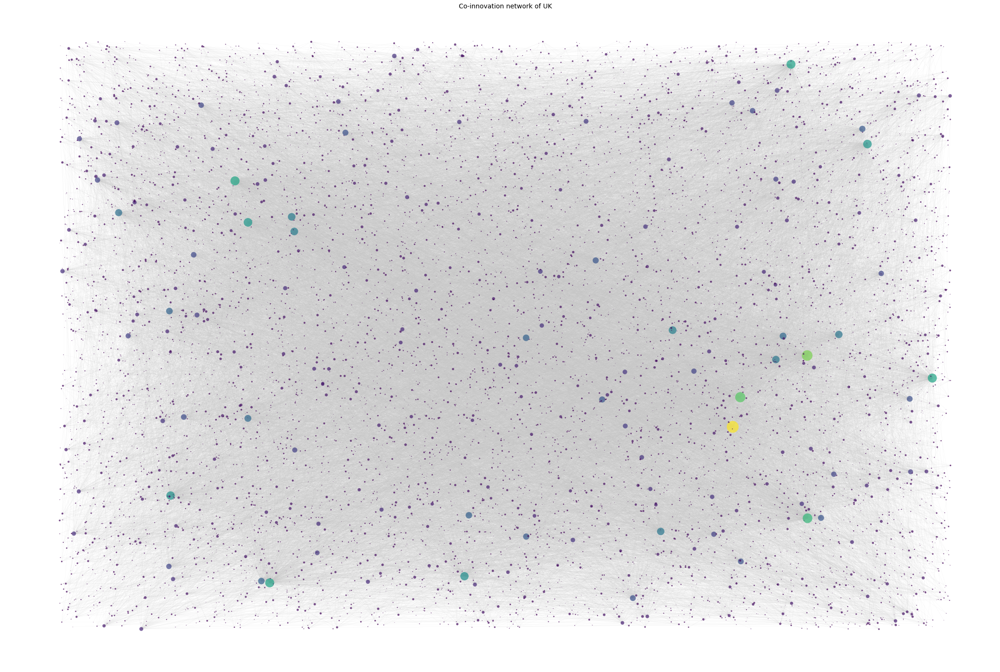

In [26]:
# Import pyplot
import matplotlib.pyplot as plt

# Creating visualization
plt.figure(figsize=(30,20))

# Create random layout positions
pos = nx.random_layout(G)

# # Create list with size for each node according 
# # to their degrees or number of neighbors that it has
sizes = [G.node[n]['degree'] for n, d in G.nodes(data=True)]

# Draw the network
nx.draw_networkx(G, 
                 pos, 
                 with_labels = False, 
                 node_size = sizes,
                 node_color = sizes,
                 edge_color = '#C0C0C0',
                 width = 0.1, alpha = 0.7,
                 arrowsize = 2, linewidths = 0)

# Turn axis off and show
plt.tight_layout()
plt.title('Co-innovation network of UK',fontsize=14)
plt.axis('off'); plt.show()

With the changes done, the network graph looks a bit better. However, the network still looks like quite messy and difficult to understand. The next sections look at different layouts and methods for visualisation.

## 4.1 Force-directed graph drawing algorithms

Force-directed graph drawing algorithms generate aesthetically pleasing and more understandable network graphs. In the next examples, the following layouts are implemented over the co-innovation network graph:
- Fruchterman and Reingold layout
- ForceAtlas2

### 4.1.1 Fruchterman and Reingold layout

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


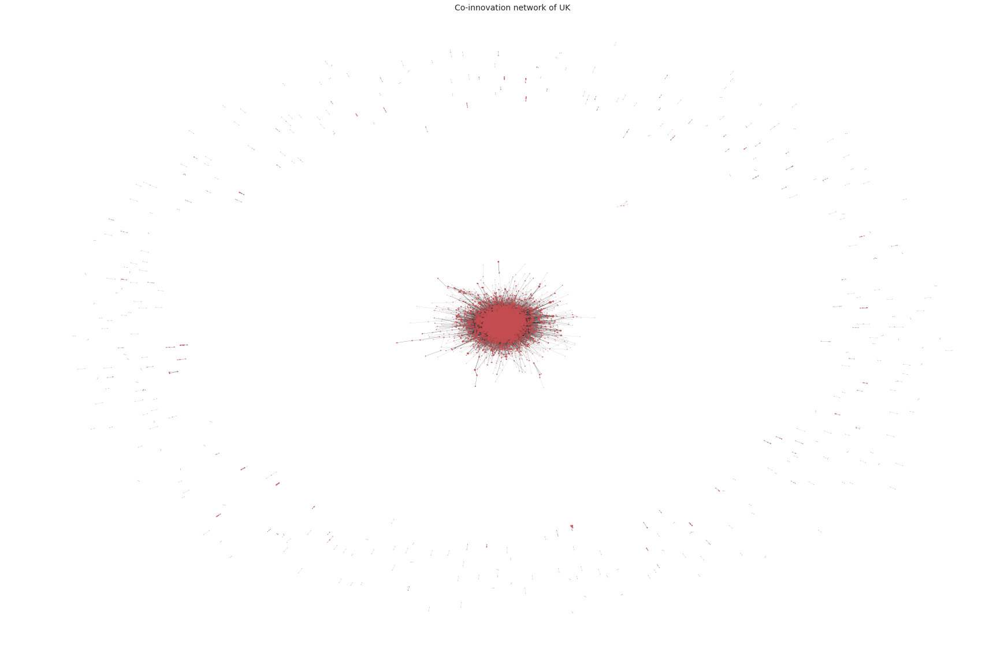

In [262]:
# Import pyplot
import matplotlib.pyplot as plt

# Creating visualization
plt.figure(figsize=(30,20))

# Create layout positions
pos = nx.fruchterman_reingold_layout(G)

# # Create list with size for each node according 
# # to their degrees or number of neighbors that it has
sizes = [x[1] for x in G.degree()]

# Draw the network
nx.draw_networkx(G, pos, 
    with_labels = False, 
    node_size = sizes,
    width = 0.1, alpha = 0.7,
    arrowsize = 2, linewidths = 0)

# Turn axis off and show
_=plt.title('Co-innovation network of UK',fontsize=14)
plt.axis('off'); plt.show()

### 4.1.2 ForceAtlas2

Create the layout defining the positions of the nodes in the network to be plotted:

In [10]:
from fa2 import ForceAtlas2

forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False, 
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # How much swinging you allow. Above 1 discouraged. Lower gives less speed and more precision
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,

                        # Tuning
                        scalingRatio=1.0, # How much repulsion you want. More makes a more sparse graph
                        strongGravityMode=True, # A stronger gravity view
                        gravity=2.0, #  Attracts nodes to the center. Prevents islands from drifting away

                        # Log
                        verbose=True)

pos_forceatlas2 = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=2000)

100%|██████████| 2000/2000 [05:52<00:00,  5.46it/s]

BarnesHut Approximation  took  75.95  seconds
Repulsion forces  took  268.04  seconds
Gravitational forces  took  0.13  seconds
Attraction forces  took  1.17  seconds
AdjustSpeedAndApplyForces step  took  3.20  seconds


Plot network with the layout created in the previous step:

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


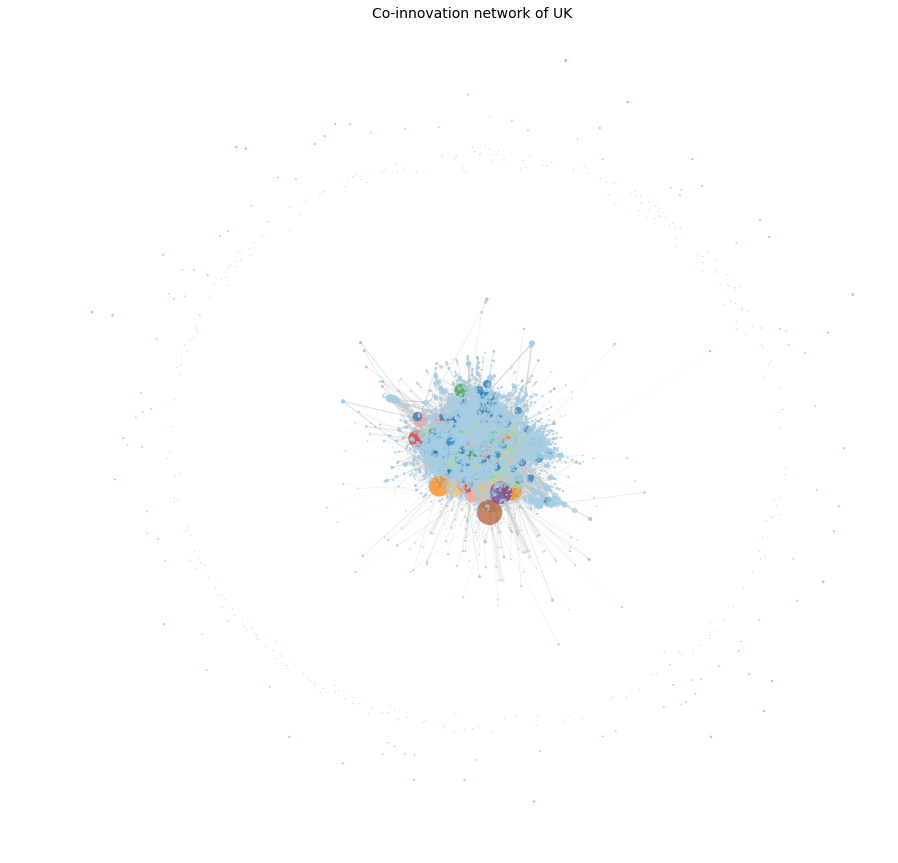

In [19]:
# Nodes sizes
sizes = [G.node[n]['degree'] for n, d in G.nodes(data=True)]

# Creating visualization
plt.figure(figsize=(15,15))

# Draw the network
nx.draw_networkx(G, 
                 pos_forceatlas2, 
                 with_labels = False, 
                 node_size = sizes,
                 node_color = sizes,
                 edge_color = '#C0C0C0',
                 width = 0.1, alpha = 0.7,
                 cmap = "Paired",
                 arrowsize = 2, linewidths = 0)

# Turn axis off and show
_=plt.title('Co-innovation network of UK',fontsize=14)
plt.axis('off'); plt.show()

## 4.2 Interactive visualisation

Interactive visualsiations are a perfect way to explore and understand the composotion of a network. On the other hand, interactive visualisations of fairly large networks tend to carry considerable constrains in the browser and due to the limitations of Faculty for storing notebook below 500 mbs, most of the interactive visualisations for co-innovation network are display in the notebook "Interactive_visualisations". In the next sections, it is shown the code used for the generation of each graph as well as an static display of the graphs:

### 4.2.1 Random layout

Load holoviews that uses bokeh as backend for rendering the network graph:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
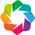

In [29]:
# Import needed libraries
import holoviews as hv

# Load HoloViews and bokeh
hv.extension('bokeh')

Plot the interactive visualisation of the netwok using a random layout:

In [30]:
import hvplot.networkx as hvnx
import holoviews as hv

# Iterate over all the nodes, including the metadata
# Create list with size for each node according 
# to their degrees or number of neighbors that it has
for n, d in G.nodes(data=True):

    # Calculate the degree of each node: G.node[n]['degree']
    G.node[n]['degree'] = nx.degree(G,n)
    
# Create random layout positions
# This will accelerate the drawing of the network
# pos = nx.fruchterman_reingold_layout(G)
pos = nx.random_layout(G)

def hook(plot, element):
#     print('plot.state:   ', plot.state)
#     print('plot.handles: ', sorted(plot.handles.keys()))
#     plot.handles['xaxis'].axis_label_text_color = 'red'
#     plot.handles['yaxis'].axis_label_text_color = 'blue'
    plot.state.title.align = 'center' # Align the title of the graph

# Define custom color map
colors_cmap = ['#000000']+hv.Cycle('Category20').values

# Create network graph
network_random = hvnx.draw(G,
          pos,
          with_labels = False, 
          node_size = 'degree',
          alpha = 0.7,
          arrowsize = 2, linewidths = 0,
          width=750, height=750,
          node_color='degree',
          edge_cmap='greys',
          edge_color='Project_Number',
          cmap = colors_cmap).opts(title="Co-innovation network of UK",
                                 fontsize={'title': 10},
                                       tools=['hover'],
                                hooks=[hook])

Create directory to save html version of the previous interactive visualisation of the network graph:

In [37]:
# Create directory to store network graphs within directory of content
!mkdir -p content/network_graphs

Save html and PNG version of network graph:

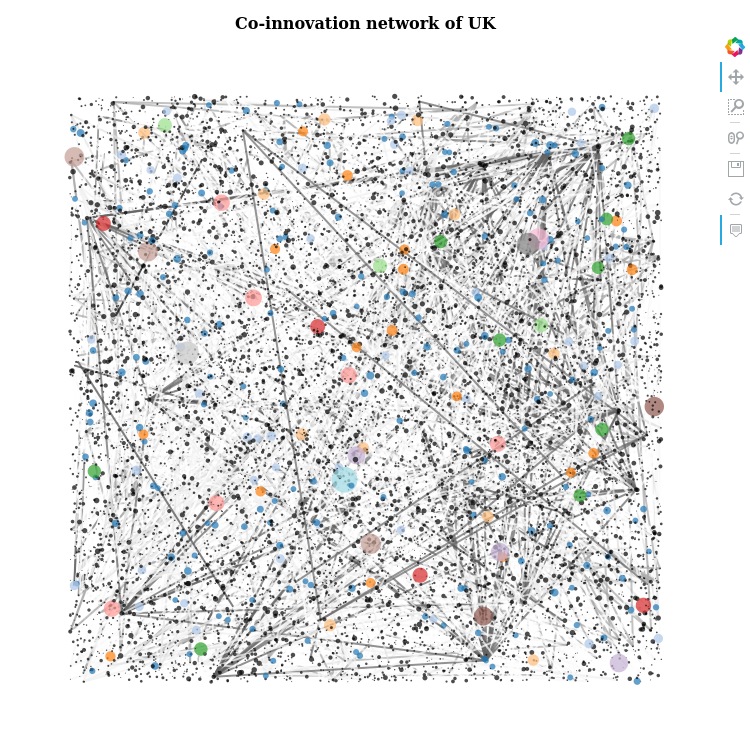

In [26]:
import hvplot
from IPython.display import Image

file_name = 'network_random'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hvplot.save(network_random, file_path + '.html')

# Save files in png for display in other notebook
hvplot.save(network_random, file_path + '.png')

# Display image
Image(file_path + '.png')

#### 4.2.1.1 Edge bundling

The network graph above highlights the main nodes. Although, because of the high number of edges, it becomes complicated to see smaller nodes. So, for better visualization of the network, the edges would be bundled:

In [31]:
# Bundling
from holoviews.operation.datashader import bundle_graph

bundled_network_random = bundle_graph(network_random)

Save interactive version of bundled network in HMTL and take snapshopt in PNG of interactive visualisation:

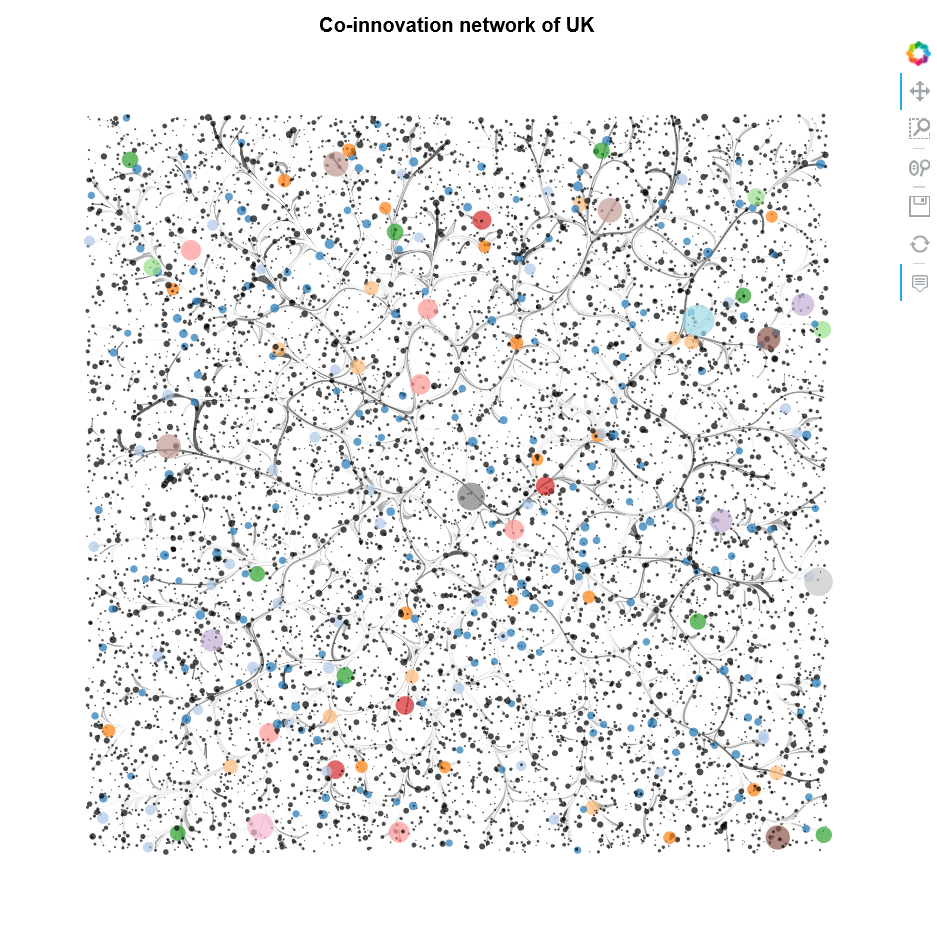

In [33]:
import hvplot
from IPython.display import Image

file_name = 'bundled_network_random'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hvplot.save(bundled_network_random, file_path + '.html')

# Save files in png for display in other notebook
hvplot.save(bundled_network_random, file_path + '.png')

# Display image
Image(file_path + '.png')

#### 4.2.1.2 Datashading

The next step is to use datasher for rasterizing the nodes and edges in the network, which would facilitate the loading and visualisation of the network:

In [108]:
from holoviews.operation.datashader import datashade

# Create graph
datashade_network_random = datashade(bundled_network_random, normalization='linear', width=750, height=1500) * bundled_network_random.nodes.opts(color='degree', size=10, width=750, height=750, cmap=colors_cmap)

Save interactive version of bundled network in HMTL and take snapshopt in PNG of interactive visualisation:

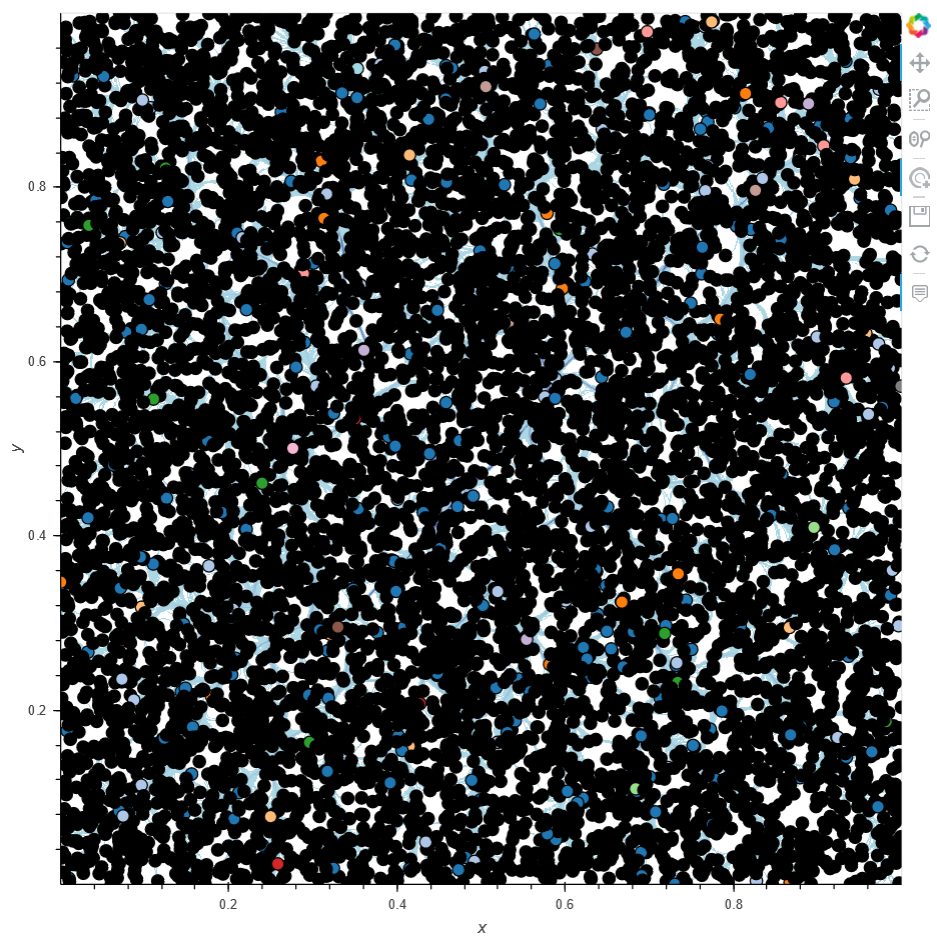

In [113]:
import hvplot
from IPython.display import Image

file_name = 'datashade_network_random'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hv.renderer('bokeh').save(datashade_network_random, file_path, fmt='html')

# Save files in png for display in other notebook
hvplot.save(datashade_network_random, file_path + '.png')

# Display image
Image(file_path + '.png')


### 4.2.2 ForceAtlas2

Create interactive network graph using ForceAtlas2 layout drawing algorithm:

In [115]:
# Create network graph
network_fa2 = hvnx.draw(G,
          pos_forceatlas2,
          with_labels = False, 
          node_size = 'degree',
          alpha = 0.7,
          arrowsize = 2, linewidths = 0,
          width=750, height=750,
          node_color='degree',
          edge_cmap='greys',
          edge_color='Project_Number',
          cmap = colors_cmap).opts(title="Co-innovation network of UK",
                                 fontsize={'title': 10},
                                       tools=['hover'],
                                hooks=[hook])
# # Display network graph
# network_fa2

Save interactive version of bundled network in HMTL and take snapshopt in PNG of interactive visualisation:

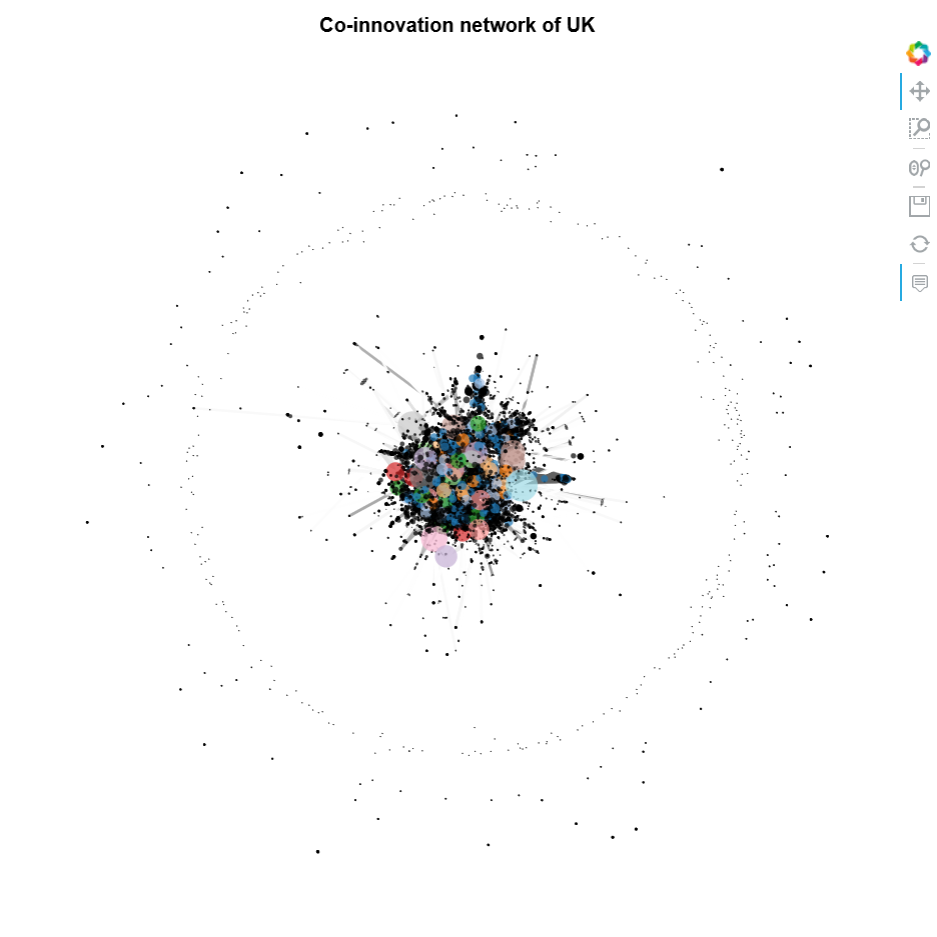

In [121]:
import hvplot
from IPython.display import Image

file_name = 'network_fa2'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hv.renderer('bokeh').save(network_fa2, file_path, fmt='html')

# Save files in png for display in other notebook
hvplot.save(network_fa2, file_path + '.png')

# Display image
Image(file_path + '.png')

#### 4.2.2.1 Edge bundling

Bundle the edges of the previously plotted interactive network graph:

In [122]:
# Bundling
from holoviews.operation.datashader import bundle_graph

bundled_network_fa2 = bundle_graph(network_fa2)

Save interactive version of bundled network in HMTL and take snapshopt in PNG of interactive visualisation:

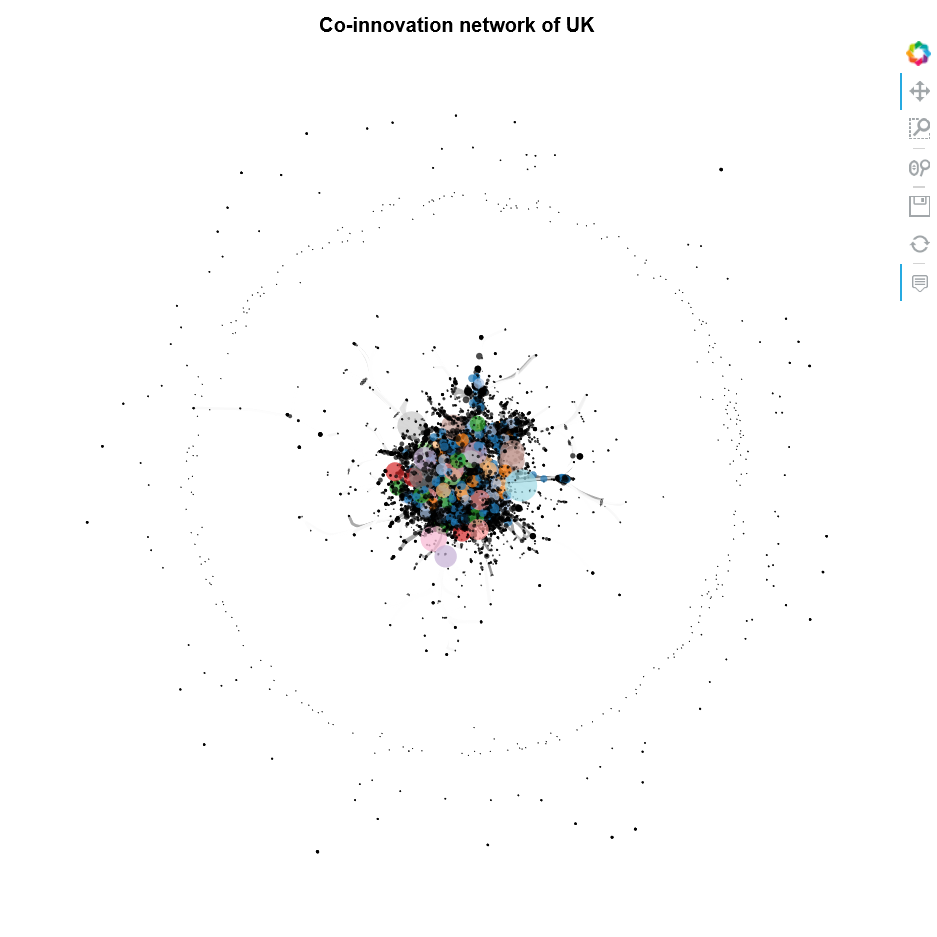

In [124]:
import hvplot
from IPython.display import Image

file_name = 'bundled_network_fa2'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hvplot.save(bundled_network_fa2, file_path + '.html')

# Save files in png for display in other notebook
hvplot.save(bundled_network_fa2, file_path + '.png')

# Display image
Image(file_path + '.png')

## 4.3 Summary statistics of the co-innovation network

In [5]:
# Get major statistics details about the network
print(nx.info(G))

Name: 
Type: Graph
Number of nodes: 8624
Number of edges: 36978
Average degree:   8.5756


Initially, the co-innovation network is considerable big with 8,624 nodes and 36,978 edges. Another important metrict for Network is the density. This is the ratio of real edges to all posible edges in the network:

In [71]:
density = nx.density(G)
print("Network density:", density)

Network density: 0.000994503417425503


The density of the network is 0.00099 on a scale of 0 to 1. This indicates that the network is not that dense, which is exemplify by network visualisations created in section ## using the force direct drawing algogithsm. These visualisations show the looseness of the relationships.

To get a sense of the network’s overall size, the metric know as diameter is used to calculate longest of all shortest paths, which the same as the furthest distance in the co-innovation network between two nodes. Networkx provides the command nx.diameter(G) for this calculation. However, since there are nodes that have no connections/paths to other nodes, it would be impossible to calculate all of the shortest paths to find the path with largest distance. Therefore, a subgraph of the largest connected component is used as a proxy to calculate the diameter of the whole network:

In [75]:
# Using nx.connected_components to get the list of components
components = nx.connected_components(G)

# Find largest component:
largest_component = max(components, key=len)

# Subgraph of largest component
subgraph = G.subgraph(largest_component)

# Calculate diameter of subgraph
diameter = nx.diameter(subgraph)
print("Network diameter of largest component:", diameter)

Network diameter of largest component: 9


The diameter of 9 means that there are 9 edges or relationships separating two nodes. This is the highest number of edges separating two nodes. Hence, the diameter.

The next statistic for the network is based in the concept of triadic closure. This concept explains that if two people know the same individual, how likely are these two people to know each other:

In [73]:
triadic_closure = nx.transitivity(G)
print("Triadic closure:", triadic_closure)

Triadic closure: 0.12116281799052378


The network’s transitivity is 0.12, which is higher than its density of 0.00099. The latter means that highly connected nodes are quite likely to be part of enclosed triangles, where two nodes/organizations that know the same node/organization, are quite likely to know each other.

In the context of the co-innovation network, it means that since two organizations know the same organization, it is quite likely that they know each other because it is also quite likely that they work in the same project(s).

## 4.4 Descriptive statistics of the co-innovation network

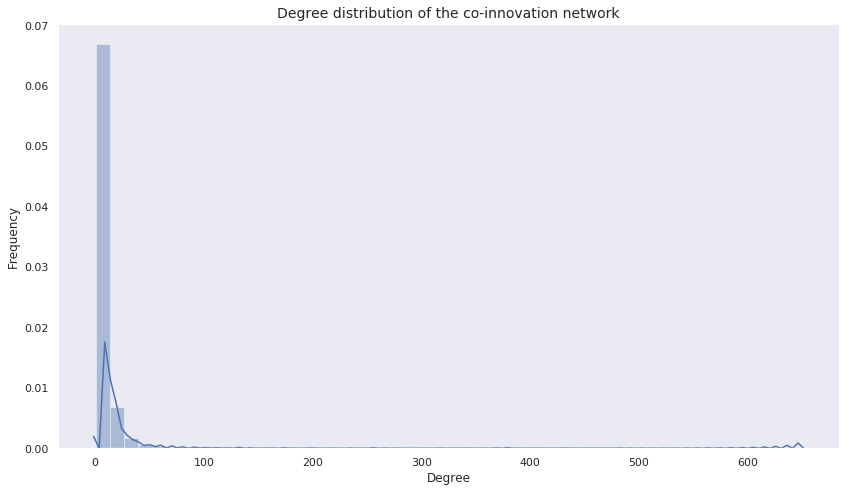

In [524]:
# Import necessary libraries
import matplotlib.pyplot as plt
import networkx as nx

# Compute the degree of every node: degrees
degrees = [G.node[n]['degree'] for n, d in G.nodes(data=True)]

# Creating visualization
plt.figure(figsize=(12,7))

# Plot a histogram of the degree distribution of the graph
sns.distplot(degrees)

# Describe plot
plt.title("Degree distribution of the co-innovation network",fontsize=14)
plt.ylabel('Frequency', fontsize=12)
plt.xlabel('Degree', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Degree distribution of the network graph.png', format='png', dpi=400)

#Show plot
plt.show()

The degree of a node is the number of edges or relationships that it has with other nodes. The first figure shows that the degrees of the nodes in the co-innovation network tend to be in average less than 10. So, each node or organization within the co-innovation network is in average connected with less than 10 organizations or exactly 8.5276 organizations in average:

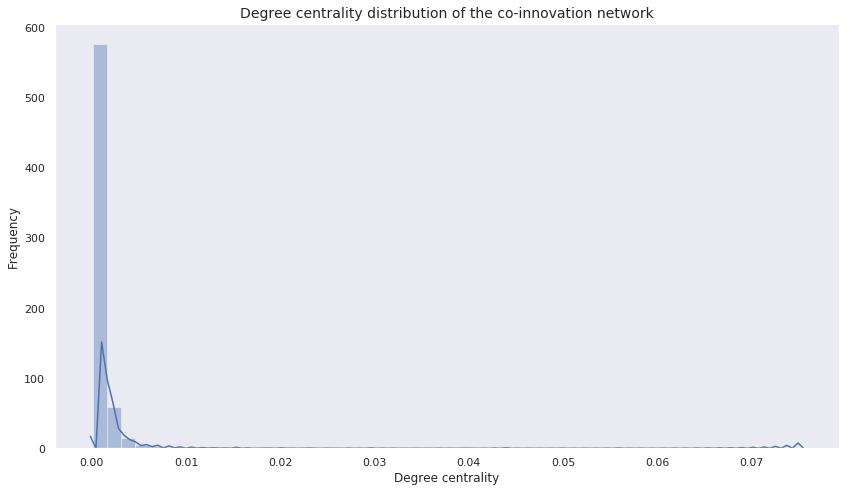

In [525]:
# Import necessary libraries
import matplotlib.pyplot as plt
import networkx as nx

# Compute the degree centrality of co-innovation network
deg_cent = nx.degree_centrality(G)

# Creating visualization
plt.figure(figsize=(12,7))

# Plot a histogram of the degree distribution of the graph
sns.distplot(list(deg_cent.values()), norm_hist=True)

# Describe plot
plt.title("Degree centrality distribution of the co-innovation network", fontsize=14)
plt.ylabel('Frequency', fontsize=12)
plt.xlabel('Degree centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Degree centrality distribution of the network graph.png', format='png', dpi=1200)

#Show plot
plt.show()

Figure x shows the degree centrality distribution of the network. The degree centrality is the number of neighbors or nodes connected to each node divided by all possible neighbors that a node could have. The possible neighbors are the rest of nodes in the network of co-innovation. The degree centrality defines the most important nodes / organizations that are most connected within the network. The mean degree centrality of the network is:

In [268]:
print("Average degree centrality in the co-innovation network: ", np.mean(list(deg_cent.values())))

Average degree centrality in the co-innovation network:  0.000994503417425503


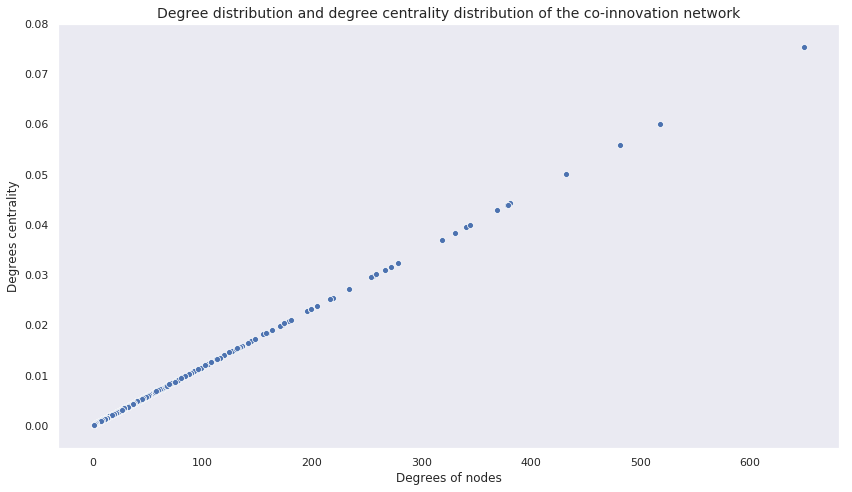

In [526]:
# Creating visualization
plt.figure(figsize=(12,7))

# Plot a scatter plot of the centrality distribution and the degree distribution
sns.scatterplot(x=degrees,y=list(deg_cent.values()))

# Describing the plot
plt.title('Degree distribution and degree centrality distribution of the co-innovation network',fontsize=14)
plt.ylabel('Degrees centrality', fontsize=12)
plt.xlabel('Degrees of nodes', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Degree distribution and degree centrality distribution of the co-innovation network.png', 
            format='png', 
            dpi=400)

#Show plot
plt.show()

Plotting the distribution of degrees centrility with the degrees of the nodes shows that there are fewer dominant nodes in the network.

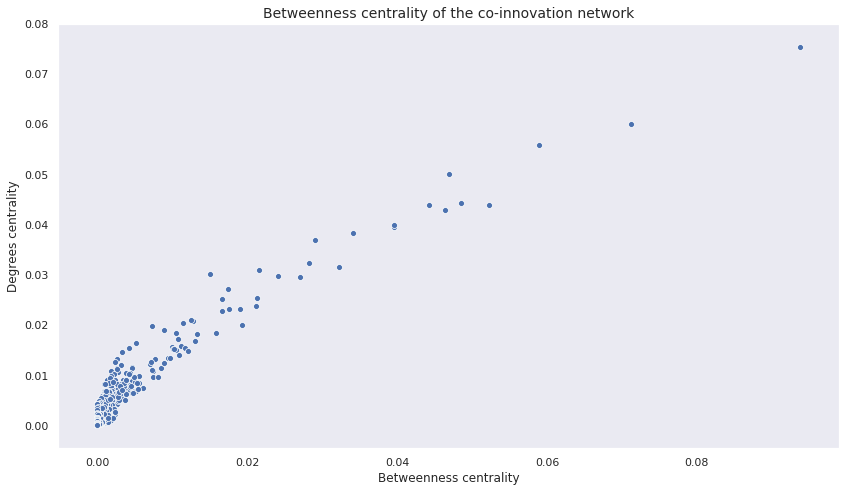

In [527]:
# Compute the betweenness centrality of G
bet_cen = nx.betweenness_centrality(G)

# Creating visualization
plt.figure(figsize=(12,7))

# Create a scatter plot of betweenness centrality and degree centrality
sns.scatterplot(x=list(bet_cen.values()),y=list(deg_cent.values()))

# Desciptions of the plot
_=plt.title('Betweenness centrality of the co-innovation network',fontsize=14)
_=plt.ylabel('Degrees centrality', fontsize=12)
_=plt.xlabel('Betweenness centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Betweenness centrality of the co-innovation network.png', 
            format='png', 
            dpi=400)

#Show plot
plt.show()

Betweenness centrality signals nodes that serve as a bridge between different clusters or communities. These communities may be organized according to sector or Innovate UK type of products. The betweenness centrality uses information about the shortest paths for its calculation. So, betweenness centrality is defined as the fraction of all possible shortest paths between any pair of nodes that pass through the node.

The importance of the betweenness centrality lays in finding influencial nodes in the network that control the flow of information between communities, clusters, or other parts of the grap.

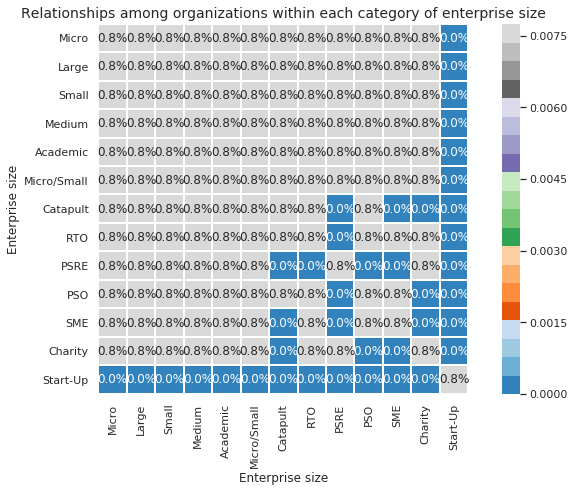

In [528]:
# Creating dataframe with the sizes of the enterprises
netEdges = networkDF[["Source", "Enterprise_Size","Target"]].copy()
netEdges.rename(columns={'Enterprise_Size':'Source_Enterprise'}, inplace=True)

# Adding the enterprise size of target companies within the edges
netEdges = netEdges.merge(networkDF[['Target', 'Enterprise_Size']], on="Target")
netEdges.rename(columns={'Enterprise_Size':'Target_Enterprise'}, inplace=True)

# Creting network
netEdges = nx.from_pandas_edgelist(
    netEdges,
    source = 'Source_Enterprise',
    target = 'Target_Enterprise',
    edge_attr=True, # to keep all the attributes or other columns in the dataframe related with each edge
    create_using = nx.Graph())

# Converting network to numpy matrix
m = nx.to_numpy_matrix(netEdges, nodelist=netEdges.nodes)

# Creating heatmap
sns.set(style="dark")
plt.figure(figsize = (10,7))

# Plotting heatmap
sns.heatmap(m/m.sum(), annot=True, fmt='.1%', cmap='tab20c',linewidths=1.0,
            xticklabels=list(netEdges.nodes), yticklabels=list(netEdges.nodes));
plt.gca().set_aspect('equal')

# Describing plot
plt.title('Relationships among organizations within each category of enterprise size', fontsize=14)
plt.ylabel('Enterprise size', fontsize=12)
plt.xlabel('Enterprise size', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Relationships among organizations within each category of enterprise size.png', 
            format='png', 
            dpi=400)

#Show plot
plt.show()

The co-innovation process seems to be evenly formed by enterprises with different sizes. However, there are projects in which some type of enterprises do not work with other type of enterprises.Then, from the heatmap, the following can be concluded:
- Start-Ups are the only ones that appear to be working with only Start-Ups. 
- Catapult, which are Innovate UK's technology and innovation centres for businesses, they have not done co-innovation projects with medium-sized enterprises (SMEs), Charities, and Public Sector Research Establishments (PSREs). The latter makes sense when the purpose of Catapult of working with businesses in late-stage research and development that leads to new products and services.
https://www.gov.uk/government/collections/innovate-uk-how-catapult-centres-can-help-your-business
https://catapult.org.uk/about-us/about-catapult/
- Public Sector Research Establishments (PSREs) does not have co-innovation projects with Public Sector Organisations (PSOs), Research and technology organisations (RTOs), and Catapult.

## 4.5 Geospatial visualisations

To answer the question of "Where co-innovation happends?", geospatial visualisations help in finding the main clusters of innovation for a region:

### 4.5.1 Get the latitude and longitude for earch region

In [29]:
# Get the point(latitude and longitude) of each address
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="UKAddress")

from geopy.extra.rate_limiter import RateLimiter
geocode = RateLimiter(geolocator.geocode, 
                      min_delay_seconds=1) #Adding 1 seconds delay between each request to Open Street Map

from tqdm import tqdm
tqdm.pandas()

# Copy address region
regions = df['Address_Region'].value_counts().reset_index(name='Total_Organisations').rename(columns={'index':'Address_Region'})
regions['Name_Regions'] = [x for x in regions['Address_Region']]

# Getting rid of the few companies that are outside of UK
regions = regions[~regions.Address_Region.isin(['Outside UK'])]

# Add United Kingdom to each region to avoid confusion with places with same name in other parts of the world
regions['Address_Region'] = [(x+", United Kingdom") for x in regions['Address_Region']]

# Get the point(latitude and longitude) of each address
regions['location'] = regions['Address_Region'].progress_apply(geocode)
regions['point'] = regions['location'].apply(lambda loc: tuple(loc.point) if loc else None)

#Get the latitue and longitude to graph
regions['latitude'] = regions['location'].apply(lambda x: x.latitude)
regions['longitude'] = regions['location'].apply(lambda x: x.longitude)

regions.head()

100%|██████████| 13/13 [00:12<00:00,  1.08s/it]


,Address_Region,Total_Organisations,Name_Regions,location,point,latitude,longitude
0,"London, United Kingdom",6141,London,"(London, Greater London, England, SW1A 2DX, UK...","(51.5073219, -0.1276474, 0.0)",51.507322,-0.127647
1,"South East, United Kingdom",5569,South East,"(UK, (54.7023545, -3.2765753))","(54.7023545, -3.2765753, 0.0)",54.702354,-3.276575
2,"East of England, United Kingdom",3726,East of England,"(East of England, England, UK, (52.2198495, 0....","(52.2198495, 0.487495041163413, 0.0)",52.219850,0.487495
3,"South West, United Kingdom",2948,South West,"(UK, (54.7023545, -3.2765753))","(54.7023545, -3.2765753, 0.0)",54.702354,-3.276575
4,"North West, United Kingdom",2912,North West,"(UK, (54.7023545, -3.2765753))","(54.7023545, -3.2765753, 0.0)",54.702354,-3.276575


Save the dataframe with all the network relationships:

In [30]:
import pickle

pickle.dump(regions, open( "/project/content/regions.p", "wb" ))

Load back the dataframe with all the geospatial data:

In [6]:
import pickle

regions = pickle.load(open("/project/content/regions.p", "rb"))

### 4.5.2 Heatmap of orgaisations within the co-innovation network of UK

In [43]:
# Create directory to store folium Html visualisation within directory of content
!mkdir -p content/geospatial_visualisations

In [7]:
import folium
from folium import plugins
from folium.plugins import HeatMap

# Copy address region
# Allregions = df[['Address_Region']]
# Allregions
# Add United Kingdom to each region to avoid confusion with places with same name in other parts of the world
AllRegions = df[['Address_Region']].copy()

# Getting rid of the few companies that are outside of UK
AllRegions = AllRegions[~AllRegions.Address_Region.isin(['Outside UK'])]

# Adding the latitute for each company of each region
AllRegions['latitude'] = [regions.loc[regions['Name_Regions'] == x, 'latitude'].iloc[0] for x in AllRegions['Address_Region']]
AllRegions['longitude'] = [regions.loc[regions['Name_Regions'] == x, 'longitude'].iloc[0] for x in AllRegions['Address_Region']]

# #Draw empty map of the UK
m = folium.Map([55.507322, -0.127647], width=600, height=600, tiles="cartodbpositron", zoom_start=5)

#Converting values to float
AllRegions['latitude'] = AllRegions['latitude'].astype(float)
AllRegions['longitude'] = AllRegions['longitude'].astype(float)

#Prepare data to graph
heat_df = AllRegions.copy()
heat_df = heat_df[['latitude', 'longitude']]

# List comprehension to make out list of lists
heat_data = [[row['latitude'],row['longitude']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data).add_to(m)

# save map
m.save('content/geospatial_visualisations/Heatmap.html')

# Display the map
m

Saving an screenshot of the Heatmap:

In [8]:
import selenium.webdriver
import time
from selenium import webdriver

#Open a browser window...
# driver = selenium.webdriver.Firefox()

# Load driver
driver = selenium.webdriver.PhantomJS() # Using PhantomJS instead of Firefox because Firefox requires to be install in the machine
driver.set_window_size(600, 600)  # Image resolution

# File name and location
file = "Heatmap"
file_path = "content/geospatial_visualisations/"

# Load file in browser
driver.get(file_path + file + ".html")

# Time delay - Wait for file to load
time.sleep(5)

# Save screenshot of map
driver.save_screenshot(file_path + file + '.png')

#Close the browser
driver.quit()

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/selenium/webdriver/phantomjs/webdriver.py:49: UserWarning: Selenium support for PhantomJS has been deprecated, please use headless versions of Chrome or Firefox instead
  warnings.warn('Selenium support for PhantomJS has been deprecated, please use headless '


### 4.5.3 Choropleth map of orgaisations within the co-innovation network of UK

##### Fit all the geospatial data to an official geojson map of UK

In [9]:
import fiona
import geopandas as gpd
from shapely.geometry import Point, Polygon

#Read official geospatial information of the UK
url = "http://geoportal1-ons.opendata.arcgis.com/datasets/01fd6b2d7600446d8af768005992f76a_4.geojson"
uk = gpd.read_file(url)

# # Go through every row, and make points
points = regions.apply(lambda row: Point(row.longitude, row.latitude), axis=1)

# # Making a new GeoDataFrame using the points and old data
regionsGPD = gpd.GeoDataFrame(regions, geometry=points)

# #Assigning a CRS using the standard shape of the earth
regionsGPD.crs = {'init': 'epsg:4326'}

#Map the number of Organisations to the geographic data of the geojson of UK
uk_organisations = gpd.sjoin(uk, regionsGPD, how='left', op='contains')

#Arrange data in descending order so Folium can create the right range for the bins in the map
uk_organisations = uk_organisations.sort_values(by=['Total_Organisations'], ascending=True)

# Fill all the locations with no organisations with 0
uk_organisations.Total_Organisations.fillna(0, inplace = True)

uk_organisations.head()

,objectid,nuts118cd,nuts118nm,bng_e,bng_n,long,lat,st_areashape,st_lengthshape,geometry,index_right,Address_Region,Total_Organisations,Name_Regions,location,point,latitude,longitude
2,3,UKE,Yorkshire and The Humber,446903,448736,-1.28712,53.932640,1.543232e+10,8.632641e+05,"POLYGON ((-0.764784900679792 54.5479863353437,...",13.0,"Yorkshire and the Humber, United Kingdom",1.0,Yorkshire and the Humber,"(Yorkshire and the Humber, England, UK, (53.93...","(53.9318994, -1.1664716608886, 0.0)",53.931899,-1.166472
11,12,UKN,Northern Ireland,86601,535325,-6.85481,54.614941,1.433563e+10,8.329563e+05,(POLYGON ((-6.453990145269281 55.2390593281559...,11.0,"Northern Ireland, United Kingdom",519.0,Northern Ireland,"(Northern Ireland, UK, (54.6294982, -6.7654416))","(54.6294982, -6.7654416, 0.0)",54.629498,-6.765442
9,10,UKL,Wales,263406,242881,-3.99416,52.067410,2.082025e+10,1.552750e+06,(POLYGON ((-3.280002913209401 53.3225848084451...,10.0,"Wales, United Kingdom",1104.0,Wales,"(Wales, UK, (52.2928116, -3.73893))","(52.2928116, -3.73893, 0.0)",52.292812,-3.738930
1,2,UKD,North West (England),350015,506280,-2.77237,54.449451,1.418261e+10,1.063053e+06,(POLYGON ((-2.674555323709436 55.1758914653134...,9.0,"North East, United Kingdom",1314.0,North East,"(UK, (54.7023545, -3.2765753))","(54.7023545, -3.2765753, 0.0)",54.702354,-3.276575
2,3,UKE,Yorkshire and The Humber,446903,448736,-1.28712,53.932640,1.543232e+10,8.632641e+05,"POLYGON ((-0.764784900679792 54.5479863353437,...",8.0,"Yorkshire and The Humber, United Kingdom",2284.0,Yorkshire and The Humber,"(Yorkshire and the Humber, England, UK, (53.93...","(53.9318994, -1.1664716608886, 0.0)",53.931899,-1.166472


After processing the data, the chlorepath could be plotted:

In [26]:
## Find every location in the map
import folium
from folium import plugins

# #Draw empty map of the UK
m = folium.Map([55.507322, -0.127647], width=600, height=600, tiles="cartodbpositron", zoom_start=5)

# Plot the map
folium.Choropleth(
    geo_data=uk,
    data=uk_organisations,
    columns=['nuts118nm','Total_Organisations'],
    key_on='feature.properties.nuts118nm',
    fill_color='BuGn',
    fill_opacity=1,
    line_opacity=0.3,
    legend_name='Total organisations per region',
    highlight=True
).add_to(m)

# Create center column for the centroid of each district
uk_organisations['center'] = uk_organisations.geometry.centroid

# save map
m.save('content/geospatial_visualisations/ChoroplethMap.html')

# Display the map
display(m)

Saving and screeshot of the Choropleth Map:

In [27]:
import selenium.webdriver
import time
from selenium import webdriver

#Open a browser window...
# driver = selenium.webdriver.Firefox()

# Load driver
driver = selenium.webdriver.PhantomJS() # Using PhantomJS instead of Firefox because Firefox requires to be install in the machine
driver.set_window_size(600, 600)  # Image resolution

# File name and location
file = "ChoroplethMap"
file_path = "content/geospatial_visualisations/"

# Load file in browser
driver.get(file_path + file + ".html")

# Time delay - Wait for file to load
time.sleep(5)

# Save screenshot of map
driver.save_screenshot(file_path + file + '.png')

#Close the browser
driver.quit()

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/selenium/webdriver/phantomjs/webdriver.py:49: UserWarning: Selenium support for PhantomJS has been deprecated, please use headless versions of Chrome or Firefox instead
  warnings.warn('Selenium support for PhantomJS has been deprecated, please use headless '


To  make the map more interactive, it is also possible to add markers to each region and indicate the number of organizations and name of the regions:

In [25]:
## Find every location in the map
import folium
from folium import plugins

# #Draw empty map of the UK
m = folium.Map([55.507322, -0.127647], width=600, height=600, tiles="cartodbpositron", zoom_start=5)

# Plot the map
folium.Choropleth(
    geo_data=uk,
    data=uk_organisations,
    columns=['nuts118nm','Total_Organisations'],
    key_on='feature.properties.nuts118nm',
    fill_color='BuGn',
    fill_opacity=1,
    line_opacity=0.3,
    legend_name='Total organisations per region',
#     threshold_scale = list(50, 60, 70, 80, 90, 100),
#     threshold_scale=[50, 60, 70, 80, 90, 100],
    highlight=True
).add_to(m)

# Create center column for the centroid of each district
uk_organisations['center'] = uk_organisations.geometry.centroid

# Build markers and popups
for row in uk_organisations.iterrows():
    row_values = row[1] 
    center_point = row_values['center']
    location = [center_point.y, center_point.x]
    popup = ('Region: ' + str(row_values['nuts118nm']) + 
             ';  ' + 'number of organisations: ' + str(row_values['Total_Organisations']))
    marker = folium.Marker(location = location, popup = popup)
    marker.add_to(m)

# save map
m.save('content/geospatial_visualisations/ChoroplethMap_withMarkers.html')

# Display the map
display(m)

## 4.6 Evolution of network over time

To find the evolution of the network over time or the number of edges that have been added and removed, the calculation corresponds to the graph differences over a window set by an initial value of the Competition_Year, which is successively increased by 1 or which is the same as saying Competition_Year + 1 for the next window.

In [529]:
import networkx as nx 

# To filter values per year
years = set(list(networkDF['Competition_Year']))

# Initialize an empty list: Gs
Gs = [] 
for year in years:
    # Instantiate a new undirected graph: G
    G_evol = nx.Graph()
    
    # Add in all nodes that have ever shown up to the graph
    G_evol.add_nodes_from(networkDF['Source'])
    G_evol.add_nodes_from(networkDF['Target'])
    
    # Filter the DataFrame so that there's only the given month
    df_filtered = networkDF[networkDF['Competition_Year'] == year]
    
    # Add edges from filtered DataFrame
    G_evol.add_edges_from(zip(df_filtered['Source'],df_filtered['Target']))
    
    # Append G to the list of graphs
    Gs.append(G_evol)
    
print(len(Gs))

17


In [530]:
import networkx as nx  
# Instantiate a list of graphs that show edges added: added
added = []
# Instantiate a list of graphs that show edges removed: removed
removed = []

# Fractional change over time
fractional_changes = []
window = 1  
i = 0      

for i in range(len(Gs) - window):
    g1 = Gs[i]
    g2 = Gs[i + window]
        
    # Compute graph difference here
    added.append(nx.difference(g2,g1))   
    removed.append(nx.difference(g1,g2))
    
    # Compute change in graph size over time
    fractional_changes.append((len(g2.edges()) - len(g1.edges())) / len(g1.edges()))
    
# Print the fractional change
print(fractional_changes)

[0.5870942201108472, 0.08680468944874034, -0.999770484278173, 40.0, 89.29268292682927, -0.6180443003781739, 0.8818953323903819, -0.0011273957158962795, -0.3905191873589165, -0.37530864197530867, 1.0612648221343874, -0.21380632790028764, 0.2347560975609756, 0.43555555555555553, 0.2893016855865153, 0.10192102454642477]


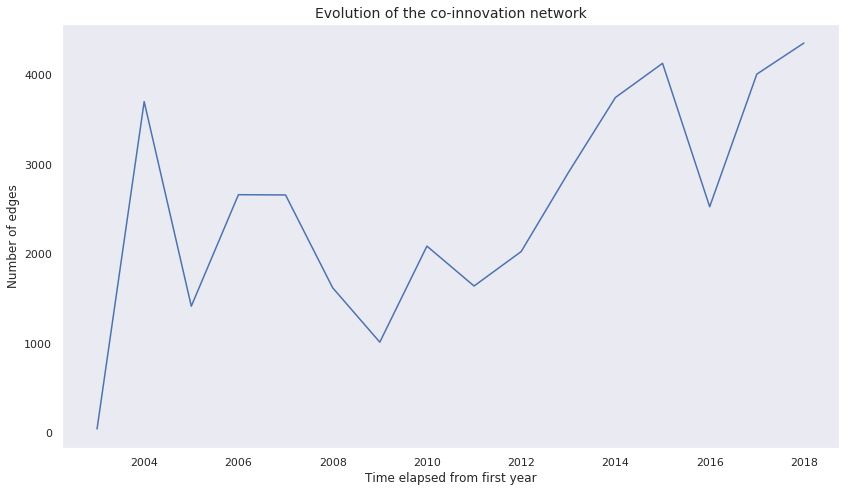

In [531]:
# Import matplotlib
import matplotlib.pyplot as plt

# Create index with all the years in the graph
years = list(set(list(networkDF['Competition_Year'])))
# years = pd.date_range("2003", periods=17, freq="y", name="Years")

# Create a list of the number of edges per year
edge_sizes = [len(g.edges()) for g in Gs]

# Create dictionary with all the data
evol_over_time = pd.DataFrame(data={'Years':years, 'Edges_size':edge_sizes})
evol_over_time = evol_over_time.sort_values(by=['Years'], ascending=True)

# Remove 2019
evol_over_time = evol_over_time.iloc[:evol_over_time.shape[0]-1,]

# Plot edge sizes over time
plt.figure(figsize=(12,7))

# Graph lineplot
sns.lineplot(x='Years', y='Edges_size', data=evol_over_time, markers=True, dashes=False)

# Label axis and give title
plt.title('Evolution of the co-innovation network', fontsize=14) 
plt.xlabel('Time elapsed from first year', fontsize=12) 
plt.ylabel('Number of edges', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Evolution of the co-innovation network.png', 
            format='png', 
            dpi=400)

# Display plot
plt.show()

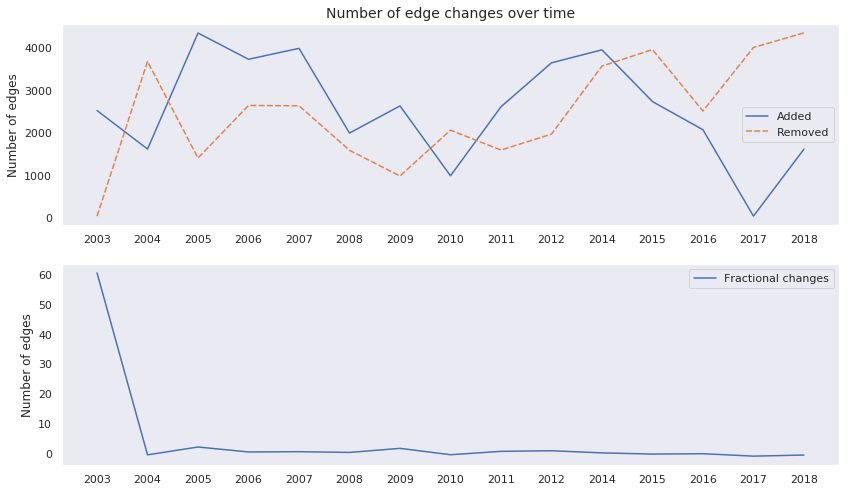

In [124]:
# Creating a more descriptive graph of the changes in the network:

# Number of edges added over time
edges_added = [len(g.edges()) for g in added]

# Number of edges removed over time
edges_removed = [len(g.edges()) for g in removed]

# Create dictionary with all the data
nodes_over_time = {'Added':edges_added, 'Removed':edges_removed}

# Create index with all the years in the graph
years = list(set(list(networkDF['Competition_Year'])))
del years[-1] # to remove 2019

# years = pd.date_range("2004", periods=16, freq="y", name="Years")

# Create dataframe with all the data
nodes_over_time = pd.DataFrame(data=nodes_over_time, index=years)
fractionalChanges = pd.DataFrame(data=fractional_changes, index=years, columns=['Fractional changes'])

# Remove 2019
nodes_over_time = nodes_over_time.iloc[:nodes_over_time.shape[0]-1,]
fractionalChanges = fractionalChanges.iloc[:fractionalChanges.shape[0]-1,]

# Create graph
plt.close("all")

# Plot edge sizes over time
# Figure size
fig = plt.figure(figsize=(12,7))
ax1 = fig.add_subplot(211)
ax2 = fig.add_subplot(212)

#Plot on ax1 with the ax argument
sns.lineplot(data=nodes_over_time, ax=ax1)

#Plot the fractional changes on ax2 with the ax argument
sns.lineplot(data=fractionalChanges, ax=ax2)

# # Descriptions the plot
# Set y labels
ax1.set_ylabel('Number of edges', fontsize=12)
ax2.set_ylabel('Number of edges', fontsize=12)

#Set over all title for the two plots
ax1.set_title("Number of edge changes over time", fontsize=14)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Number of edge changes over time.png', format='png', dpi=1200)

# Display plot
plt.show()

The dropped in the number of edges around 2014 to 2016 corresponds to a reduction in the number of projects:

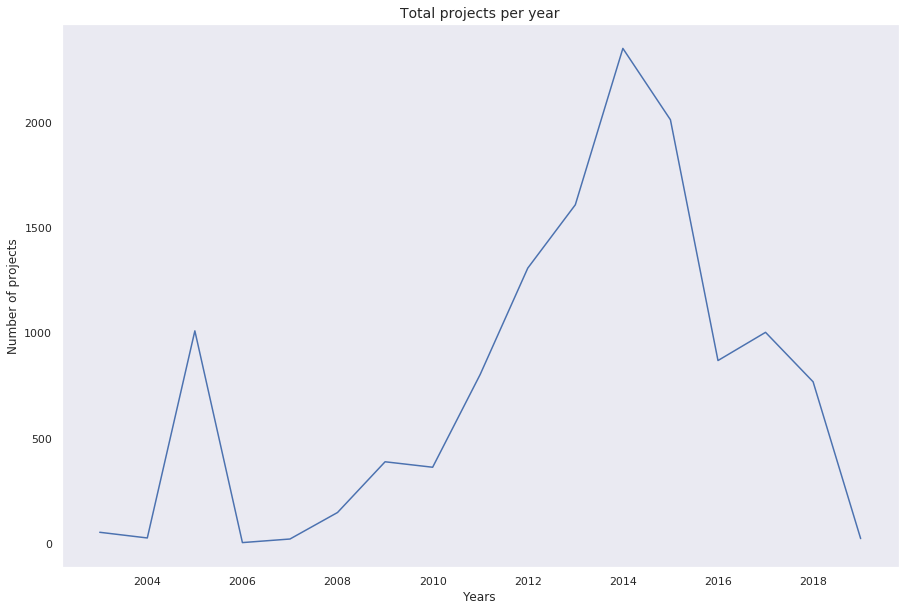

In [126]:
# Total_Projects = (df.groupby('Competition_Year').Project_Number.value_counts().reset_index(name='Total_Projects')).dop(columns=['Project_Number'])
Total_Projects = df[['Competition_Year','Project_Number']].copy()

# leave only the unique project numbers per year
Total_Projects.drop_duplicates(subset ="Project_Number", keep = False, inplace = True)

# Count all the projects per year
Total_Projects = Total_Projects['Competition_Year'].value_counts().reset_index(name="Total_projects").rename(columns={'index':'Competition_Year'}, inplace=False)
Total_Projects = Total_Projects.sort_values(by=['Competition_Year'], ascending=True)

# Create figure
_=plt.figure(figsize=(15,10))

# Plot projects per year
_=sns.lineplot(x="Competition_Year", y="Total_projects", data=Total_Projects ,markers=True, dashes=False)

# Descriptions the plot
_=plt.title('Total projects per year',fontsize=14)
_=plt.ylabel('Number of projects', fontsize=12)
_=plt.xlabel('Years', fontsize=12)

There is a recovery in and a seemingly dropped again in 2019. The dropped in 2019 is because the dataset used for this project has the data of all projects until 3 July 2019.

## 4.7 Nodes with high degrees of centrality

This section identifies the nodes with the highest degree of centrality in the network and in the sectors of all the projects:

In [13]:
# Function to get specific nodes that are part of a community
def get_nodes_and_neighbors(G, nodes_of_interest):
    """
    Returns a subgraph of the graph `G` with only the `nodes_of_interest` and their neighbors.
    """
    nodes_to_draw = []

    # Iterate over the nodes of interest
    for n in nodes_of_interest:

        # Append the nodes of interest to nodes_to_draw
        nodes_to_draw.append(n)

        # Iterate over all the neighbors of node n
        for neighbors in G.subgraph(n):

            # Append the neighbors of n to nodes_to_draw
            nodes_to_draw.append(neighbors)

    return G.subgraph(nodes_to_draw)

In [533]:
# Function to get the nodes with high degree of centrality
def nodes_high_degree_centrality(G):
    # Compute the degree centrality of G: deg_cent
    deg_cent = nx.degree_centrality(G)

    # Store centralities in DataFrame
    nodes = pd.DataFrame(list(deg_cent.items()), columns = ['Participant', 'degree_centrality'])

    #Filtering the top 10 nodes according to centrality
    nodes = nodes.sort_values(by=['degree_centrality'], ascending=False)
    
    return nodes

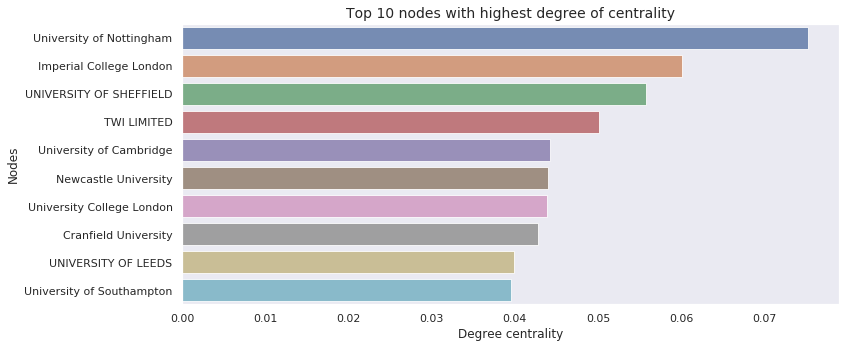

In [534]:
# #Filtering the top 10 nodes according to centrality
topDegreeCentrality = nodes_high_degree_centrality(G).iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=topDegreeCentrality.degree_centrality, y=topDegreeCentrality.Participant, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 nodes with highest degree of centrality',fontsize=14)
_=plt.ylabel('Nodes', fontsize=12)
_=plt.xlabel('Degree centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 nodes with highest degree of centrality.png', 
            format='png', 
            dpi=400)

# Display plot
plt.show()

In [535]:
# Function to filter nodes that are not universities
def filter_non_universities(df):
    # Filter all non-universities
    try:
        df = df[~df["Participant"].str.contains(r'University')]
        df = df[~df["Participant"].str.contains(r'UNIVERSITY')]
        df = df[~df["Participant"].str.contains(r'College')]
    except KeyError:
        df = df[~df["Participant_Name"].str.contains(r'University')]
        df = df[~df["Participant_Name"].str.contains(r'UNIVERSITY')]
        df = df[~df["Participant_Name"].str.contains(r'College')]
    return df

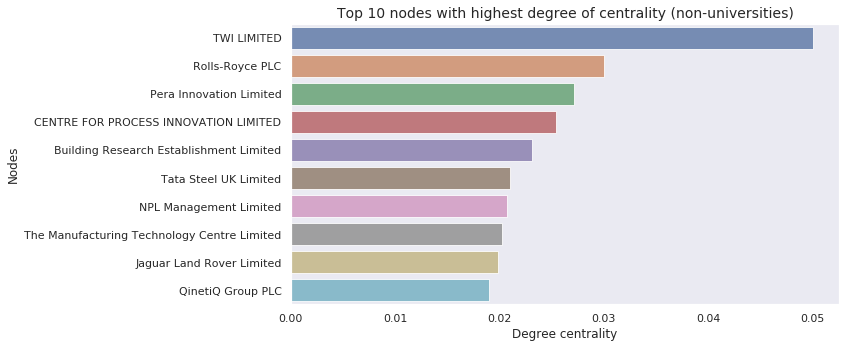

In [536]:
#Filtering the top 10 nodes according to centrality
topDegreeCentrality = filter_non_universities(nodes_high_degree_centrality(G)).iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=topDegreeCentrality.degree_centrality, y=topDegreeCentrality.Participant, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 nodes with highest degree of centrality (non-universities)',fontsize=14)
_=plt.ylabel('Nodes', fontsize=12)
_=plt.xlabel('Degree centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 nodes with highest degree of centrality-non-universities.png', 
            format='png', 
            dpi=400)

# Display plot
plt.show()

### 4.7.1 Nodes with high degree centrality in each sector

In [537]:
# Function to only get and plot the top 10 nodes with high degree of centrality
def graph_top_ten_nodes_degree_centrality(G,title,ylabel,xlabel):

    # #Filtering the top 10 nodes or enterprises according to centrality
    topDegreeCentrality = filter_non_universities(nodes_high_degree_centrality(G)).iloc[:10,]

    # Creating visualization
    _=plt.figure(figsize=(12,5))

    _=sns.set(style="dark")
    _=sns.barplot(x=topDegreeCentrality.degree_centrality, y=topDegreeCentrality.Participant, alpha=0.8)

    # Descriptions the plot
    _=plt.title(title,fontsize=14, loc='left')
    _=plt.ylabel(ylabel, fontsize=12)
    _=plt.xlabel(xlabel, fontsize=12)
    
    # To make the graph fit
    plt.tight_layout()

    # Save plot
    plt.savefig('content/descriptive_graphs/' + title +'.png', format='png', dpi=400, bbox_inches = "tight")

    # Display plot
    plt.show()
    
    plt.close()

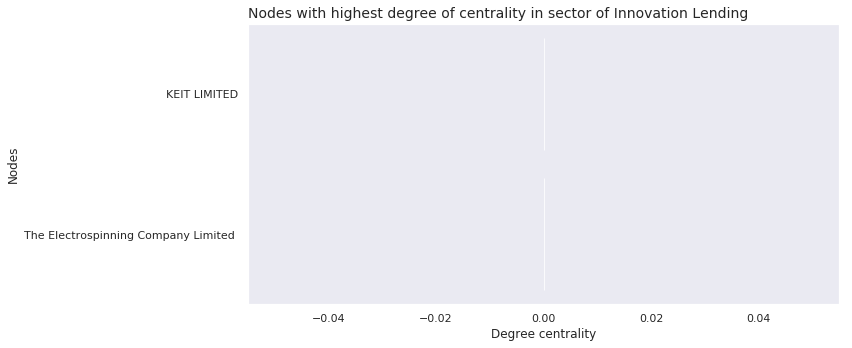

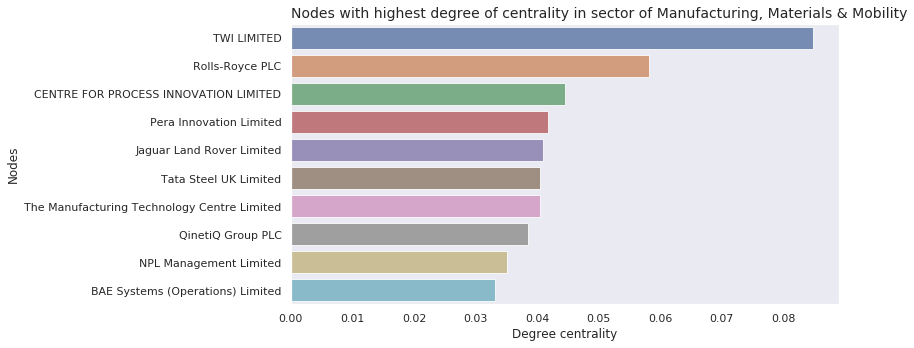

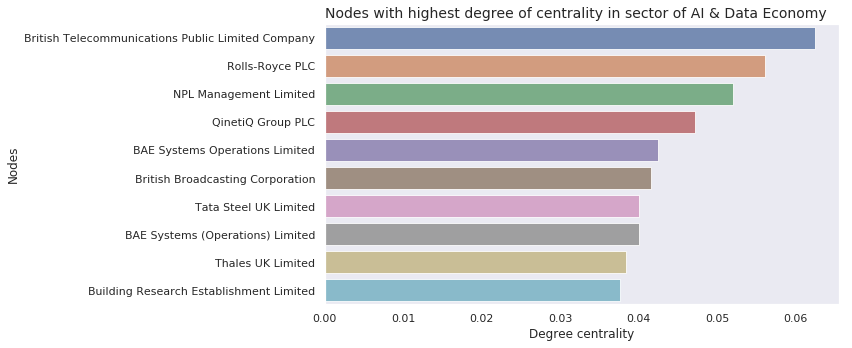

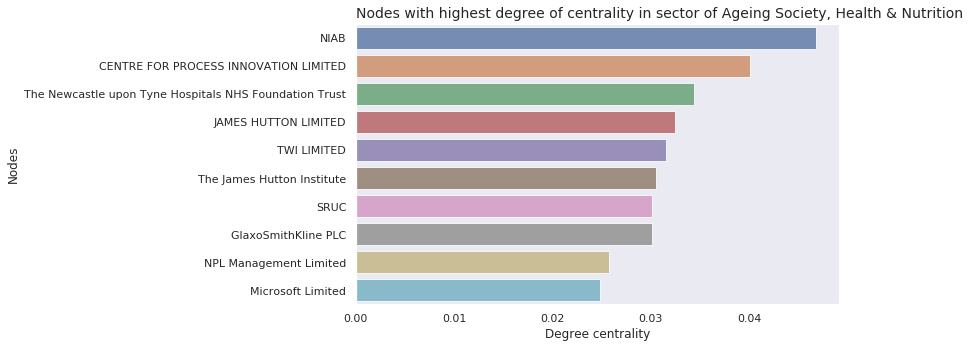

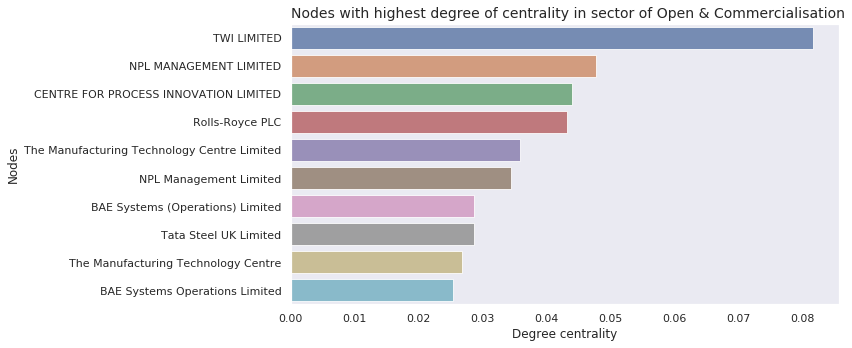

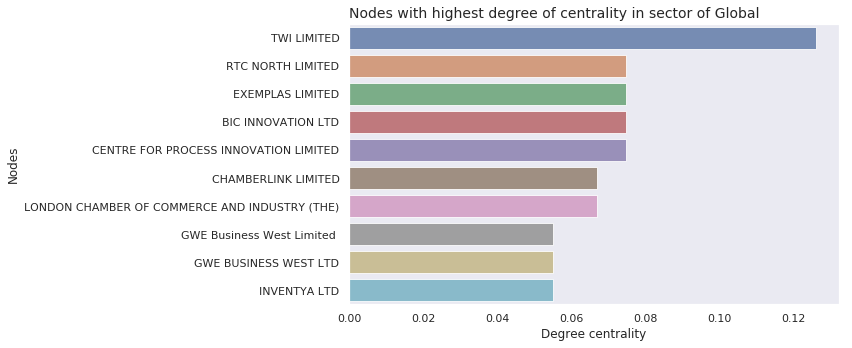

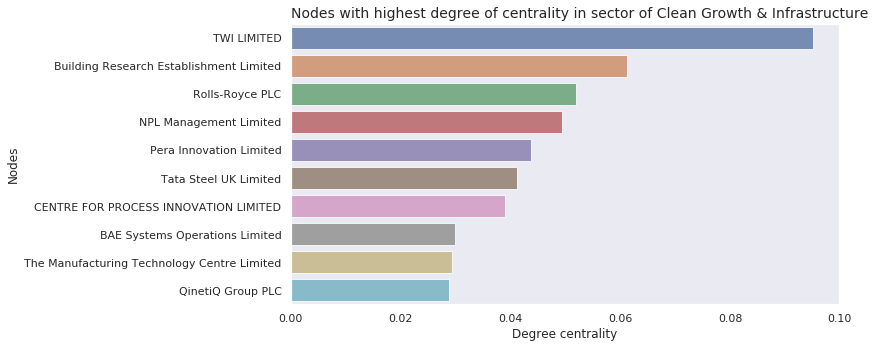

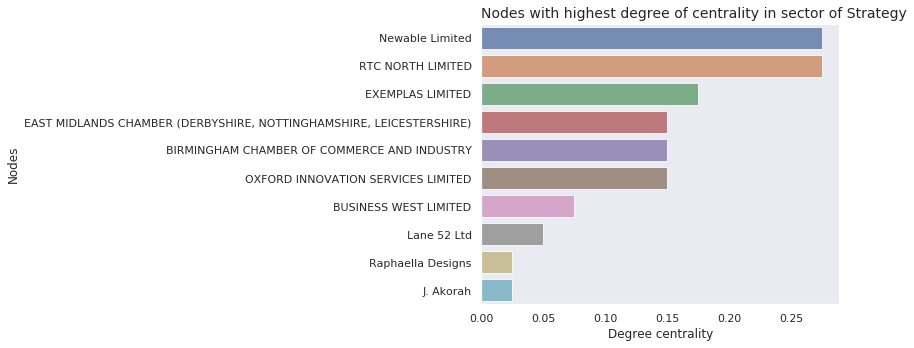

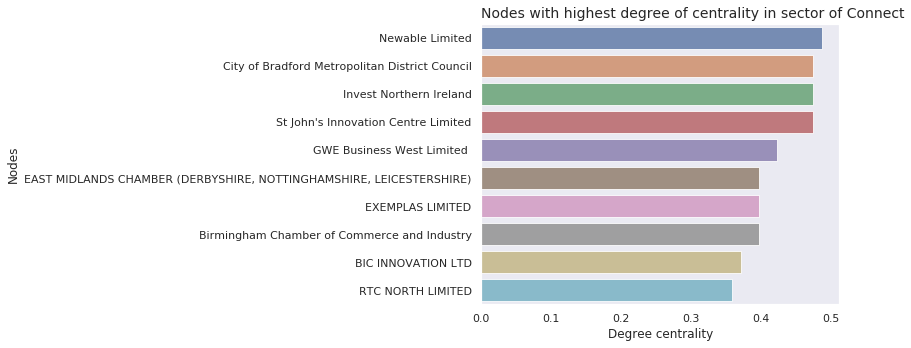

In [538]:
# Get all the sectors in the network
sectorsNetwork = list(set(list(df['Sector'])))

# Loop over all the sectors to get top 10s for each sector
for sector in sectorsNetwork:
    
    # Filter only the nodes for sector
    nodes_of_interest = set(list(df[df.Sector.isin([sector])]['Participant_Name']))

    # Extract the subgraph with the nodes of interest
    temp_G = get_nodes_and_neighbors(G,nodes_of_interest)

    title = 'Nodes with highest degree of centrality in sector of ' + sector
    ylabel = 'Nodes'
    xlabel = 'Degree centrality'
    
    graph_top_ten_nodes_degree_centrality(temp_G,title,ylabel,xlabel)

## 4.8 Nodes with highest degree of betweennes centrality

After finging the nodes with the highest degree of centrality, this section identifies the nodes with the highest degree of betweenness centrality, which are the nodes that serve as bridges between clusters or communities:

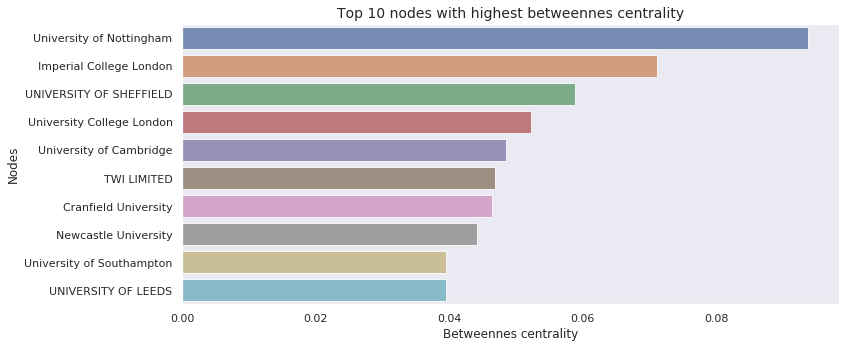

In [539]:
# Compute the betweenness centrality of G
bet_cen = nx.betweenness_centrality(G)

# Store centralities in DataFrame
topBetweennesCentrality = pd.DataFrame(list(bet_cen.items()), columns = ['Participant', 'betweennes_centrality'])

#Filtering the top 10 nodes according to centrality
topBetweennesCentrality = topBetweennesCentrality.sort_values(by=['betweennes_centrality'], ascending=False).iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

# Plot values
_=sns.set(style="dark")
_=sns.barplot(x=topBetweennesCentrality.betweennes_centrality, y=topBetweennesCentrality.Participant, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 nodes with highest betweennes centrality',fontsize=14)
_=plt.ylabel('Nodes', fontsize=12)
_=plt.xlabel('Betweennes centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 nodes with highest betweennes centrality.png', format='png', dpi=400)

# Display plot
plt.show()

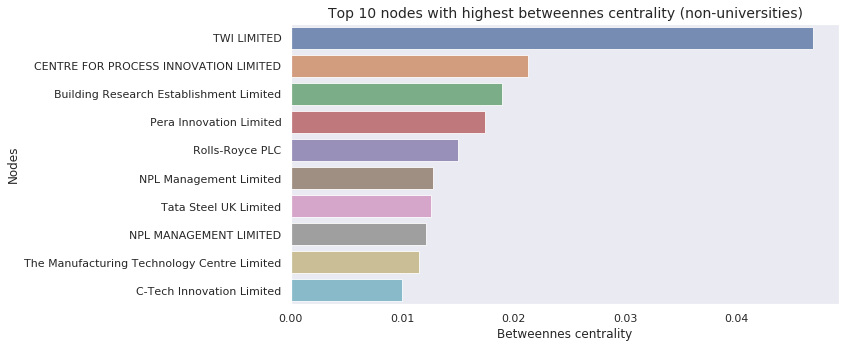

In [540]:
# Store centralities in DataFrame
topBetweennesCentrality = pd.DataFrame(list(bet_cen.items()), columns = ['Participant', 'betweennes_centrality'])

# Filter all non-universities, sort values, and select the top 10 participants with betweennes centrality
topBetweennesCentrality = filter_non_universities(topBetweennesCentrality).sort_values(by=['betweennes_centrality'], ascending=False).iloc[:10,]

# Creating visualization
_=plt.figure(figsize=(12,5))

_=sns.set(style="dark")
_=sns.barplot(x=topBetweennesCentrality.betweennes_centrality, y=topBetweennesCentrality.Participant, alpha=0.8)

# Descriptions the plot
_=plt.title('Top 10 nodes with highest betweennes centrality (non-universities)',fontsize=14)
_=plt.ylabel('Nodes', fontsize=12)
_=plt.xlabel('Betweennes centrality', fontsize=12)

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 10 nodes with highest betweennes centrality - non-universities.png', format='png', dpi=400)

# Display plot
plt.show()

## 4.9 Community Detection

This section looks at communities within the larger social structure of the co-innovation network. Doing community detection would define if the co-innovation network is a collection of subgroups or if everyone knows each other.

### Louvain Algorithm

The louvain algorith detects communities by maximizing the modularity of the network. Modularit means the fraction of nodes' edges densely connected within the community in comparison to the expected fraction of edges if the nodes were distributed in a random network.

The louvain algorith consists of of two steps:
1. "greedy" assignment of nodes to communities, favoring local optimizations of modularity. 
2. Definition of a new coarse-grained network in terms of the communities found in the first step. 
    
The two steps are repeated until no further modularity-increasing reassignments of communities are possible.

In [5]:
import community

# Starting with an initial partition of the graph and running the Louvain algorithm for Community Detection
partition=community.best_partition(G)

In [6]:
# Setting the attribute to which community each node belongs to
nx.set_node_attributes(G, partition, 'modularity')

In [10]:
import community

# Get all members within all the communities
community_nodes = pd.DataFrame()
community_nodes['CommunityNumber'], community_nodes['Members'] = zip(*[(item[1], item[0]) for item in partition.items()])

# Total number of communities
Total_Members_Communities = community_nodes['CommunityNumber'].value_counts().reset_index(name='Total').rename(columns={'index':'CommunityNumber'})

# Calculating modularity and the total number of communities
mod=community.modularity(partition,G)
print("Modularity: ", mod)
print("Total number of Communities=", Total_Members_Communities.shape[0])

Modularity:  0.6047204120863265
Total number of Communities= 387


There are 387. However, since the co-innovation networks has lots of relationships of only two nodes, the Louvain alrotighm's modulity considers these two nodes as a community. So, it is needed to filter them out to get a real estimate of existing communities:

In [11]:
Total_Members_Communities = Total_Members_Communities[Total_Members_Communities['Total'] > 2]
Total_Members_Communities.shape[0]

138

Plotting the two major communities using the ForceAtlas2 layout drawing algorithm:

In [18]:
# Import necessary library
from fa2 import ForceAtlas2

# Filtering top two communities
topCommunities = list(Total_Members_Communities['CommunityNumber'].iloc[:2,])

# Getting members of the two communities
NodesTop = list(community_nodes[community_nodes['CommunityNumber'].isin(topCommunities)]['Members'])

# Extract the subgraph with the nodes of interest
G_Top_Communities = G.subgraph(NodesTop)

# Create layout positions
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False, 
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # How much swinging you allow. Above 1 discouraged. Lower gives less speed and more precision
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,

                        # Tuning
                        scalingRatio=1.0, # How much repulsion you want. More makes a more sparse graph
                        strongGravityMode=True, # A stronger gravity view
                        gravity=2.0, #  Attracts nodes to the center. Prevents islands from drifting away

                        # Log
                        verbose=True)

pos = forceatlas2.forceatlas2_networkx_layout(G_Top_Communities, pos=None, iterations=2000)

100%|██████████| 2000/2000 [00:24<00:00, 81.73it/s]

BarnesHut Approximation  took  8.30  seconds
Repulsion forces  took  14.94  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.16  seconds
AdjustSpeedAndApplyForces step  took  0.49  seconds


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
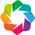

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):
/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


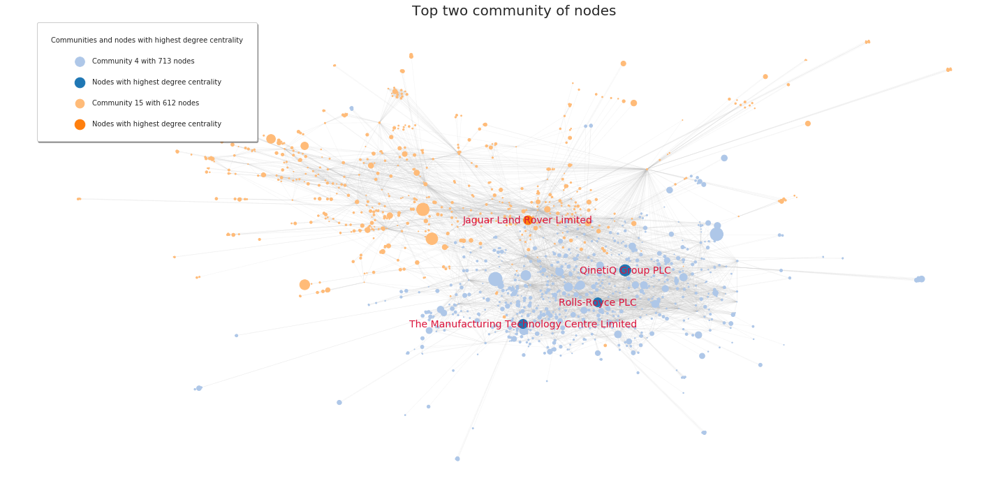

In [188]:
# Import needed libraries for loading of files and display of graphs
from matplotlib.colors import to_hex
import holoviews as hv

# Load HoloViews and bokeh
hv.extension('bokeh')

# Define custom color map using categorical palettes from D3
# https://bokeh.pydata.org/en/latest/docs/reference/palettes.html
colors_cmap = ['#000000']+hv.Cycle('Category20').values
to_hex(colors_cmap[2], keep_alpha=False) #Convert RGBA to HEX value

# Creating visualization
plt.figure(figsize=(20,10))
  
# pos = nx.spring_layout(G_communities)

#Filtering the top 10 nodes according to centrality
nodesHighDegreeCentrality = list(filter_non_universities(nodes_high_degree_centrality(G)).iloc[:10,]['Participant'])

# To set color for each community
counter_color = 2

for comm in topCommunities:
    
    # Get list of nodes for a specific community
    CommunityNodes = list(community_nodes[community_nodes.CommunityNumber.isin([comm])]['Members'])
    
    # Plot nodes for specific community
    sizes = [G_Top_Communities.node[n]['degree'] for n, d in G_Top_Communities.nodes(data=True) if n in CommunityNodes if n not in nodesHighDegreeCentrality]
    nx.draw_networkx_nodes(G_Top_Communities,
                           pos=pos,
                           node_size = sizes,
#                            cmap = 'Paired',
#                            nodelist=CommunityNodes,
                           nodelist = [x for x in CommunityNodes if x not in nodesHighDegreeCentrality],
                           node_color = to_hex(colors_cmap[counter_color], keep_alpha=False),
                           label = "Community " + str(comm) + " with " + str(len(CommunityNodes)) + " nodes",
                           alpha = 1)
    
    # Mark specific nodes that are within the top ten
    size_top = [G_Top_Communities.node[n]['degree'] for n, d in G_Top_Communities.nodes(data=True) if n in nodesHighDegreeCentrality]
    nx.draw_networkx_nodes(G_Top_Communities,
                               pos=pos,
                               node_size = size_top,
                               nodelist=[x for x in nodesHighDegreeCentrality if x in CommunityNodes],
                               node_color = to_hex(colors_cmap[counter_color-1], keep_alpha=False),
                               label = "Nodes with highest degree centrality",
                               alpha = 1)
    
    # Draw the edges
    nx.draw_networkx_edges(G_Top_Communities,
                           nodelist=CommunityNodes,
                           pos=pos,
                           edge_color = '#C0C0C0',
                           alpha = 0.1,
                           width=0.4,
                           style='solid',
                           arrows = False)
    
    counter_color += 2 # To get the next color in the custom color map
    
# Creating the labels
labels = {}    
for node in G_Top_Communities.nodes():
    if node in nodesHighDegreeCentrality:
        #set the node name as the key and the label as its value 
        labels[node] = node
        
# Labeling the top nodes with highest degree centrality in the two communities
nx.draw_networkx_labels(G_Top_Communities,
                        pos,
                        labels,
                        font_weight='normal',
                        font_size=14,
                        font_color='#DC143C')

# Describing graph = Turn axis off and show
plt.legend(scatterpoints = 1, 
           loc='upper left', 
           ncol=1,
           borderpad=2,
           title="Communities and nodes with highest degree centrality",
          shadow=True,
           fancybox=True,
          labelspacing=2)

plt.title('Top two community of nodes', fontsize=20)
plt.axis('off')

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/network_graphs/Top_2_Communities.png', format='png', dpi=1000, bbox_inches = "tight")

# Display plot
plt.show()

Creating the layout to plot Cisco's community using ForceAtlas2 layout drawing algorithm:

In [259]:
# Getting members of the Cisco's communities
Cisco_comm = list(community_nodes[community_nodes['CommunityNumber'].isin(list(community_nodes[community_nodes['Members']=='Cisco']['CommunityNumber']))]['Members'])

# Extract the subgraph with the nodes of interest
G_Cisco_comm = G.subgraph(Cisco_comm)

# Iterate over all the edges (with metadata) to give specific color to edges where Cisco is involved Cisco
for u, v, d in G_Cisco_comm.edges(data=True):

#     # Check if node Cisco is involved
    if 'Cisco' in [u, v]:
        
        if 'Cisco' == u:

            # Set the weight of relationships to total number of projects
#             G_Cisco_comm.edges[u, v]['weight'] += len([x for x in Cisco_projects[Cisco_projects['Participant_Name']==v]['Project_Number']])
#             G_Cisco_comm.edges[u, v]['weight'] = 0
            G_Cisco_comm.edges[u, v]['color'] = '#1f77b4'

        else:
          # Set the weight of relationships to total number of projects
#             G_Cisco_comm.edges[u, v]['weight'] += len([x for x in Cisco_projects[Cisco_projects['Participant_Name']==u]['Project_Number']])

#             G_Cisco_comm.edges[u, v]['weight'] = 0
            G_Cisco_comm.edges[u, v]['color'] = '#1f77b4'

    
    else:
#         G_Cisco_comm.edges[u, v]['weight'] = 1
        G_Cisco_comm.edges[u, v]['color'] = '#C0C0C0'

# Layout drawing
# pos_Cisco_initial = nx.fruchterman_reingold_layout(G_Cisco_comm, weight='weight')
# pos_Cisco_initial = nx.kamada_kawai_layout(G_Cisco_comm)

pos_Cisco = forceatlas2.forceatlas2_networkx_layout(G_Cisco_comm, pos=None, iterations=3000)
# pos_Cisco = nx.fruchterman_reingold_layout(G_Cisco_comm)
# pos_Cisco = nx.kamada_kawai_layout(G_Cisco_comm)


100%|██████████| 3000/3000 [00:01<00:00, 2640.58it/s]

BarnesHut Approximation  took  0.26  seconds
Repulsion forces  took  0.69  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.08  seconds


Draw Cisco's community using the layout created in the previous cell:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
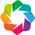

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


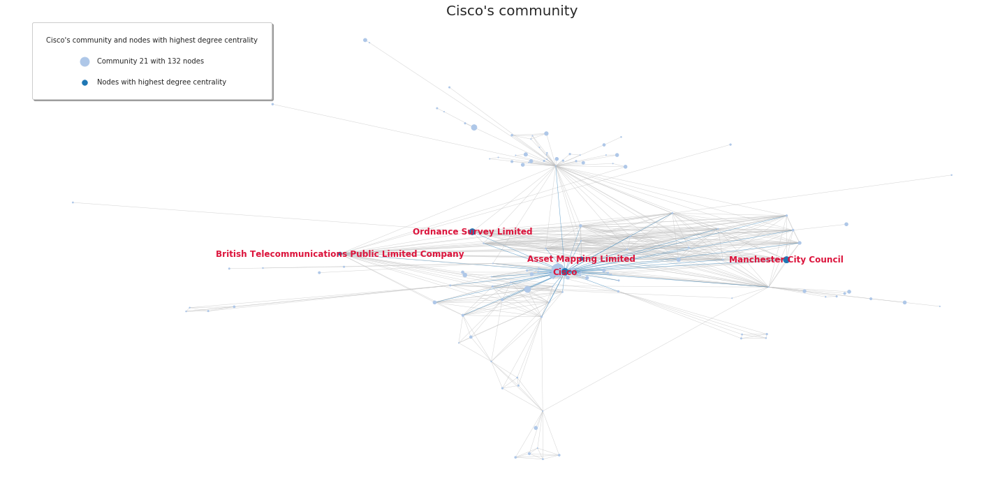

In [266]:
# Import needed libraries for loading of files and display of graphs
from matplotlib.colors import to_hex
import holoviews as hv

# Load HoloViews and bokeh
hv.extension('bokeh')

# Define custom color map using categorical palettes from D3
# https://bokeh.pydata.org/en/latest/docs/reference/palettes.html
colors_cmap = ['#000000']+hv.Cycle('Category20').values
to_hex(colors_cmap[2], keep_alpha=False) #Convert RGBA to HEX value

# Creating visualization
plt.figure(figsize=(20,10))
  
# Cisco number of community
Cisco_commNumb = list(community_nodes[community_nodes['Members']=='Cisco']['CommunityNumber'])[0]

#Filtering the top 10 nodes according to centrality
nodesHighDegreeCentrality = list(filter_non_universities(nodes_high_degree_centrality(G_Cisco_comm)).iloc[:5,]['Participant'])

# Plot nodes for specific community
sizes = [G_Cisco_comm.node[n]['degree'] for n, d in G_Cisco_comm.nodes(data=True) if n not in nodesHighDegreeCentrality]

nx.draw_networkx_nodes(G_Cisco_comm,
                       pos=pos_Cisco,
                       node_size = sizes,
#                            cmap = 'Paired',
#                            nodelist=CommunityNodes,
                       nodelist = [x for x in Cisco_comm if x not in nodesHighDegreeCentrality],
                       node_color = to_hex(colors_cmap[2], keep_alpha=False),
                       label = "Community " + str(Cisco_commNumb) + " with " + str(len(Cisco_comm)) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [G_Cisco_comm.node[n]['degree'] for n, d in G_Cisco_comm.nodes(data=True) if n in nodesHighDegreeCentrality]
nx.draw_networkx_nodes(G_Cisco_comm,
                           pos=pos_Cisco,
                           node_size = size_top,
                           nodelist=[x for x in nodesHighDegreeCentrality],
                           node_color = to_hex(colors_cmap[2-1], keep_alpha=False),
                           label = "Nodes with highest degree centrality",
                           alpha = 1)

# Draw the edges of top nodes related to Cisco
nx.draw_networkx_edges(G_Cisco_comm,
                       nodelist=G_Cisco_comm,
                       pos=pos_Cisco,
                       edge_color = [G_Cisco_comm.edges[u, v]['color'] for u, v, d in G_Cisco_comm.edges(data=True)],
                       alpha = 0.7,
                       style='solid',
                       arrows = False,
                       width=0.5)    

   
# Creating the labels
labels = {}    
for node in G_Cisco_comm.nodes():
    if node in nodesHighDegreeCentrality:
        #set the node name as the key and the label as its value 
        labels[node] = node
        
# Labeling the top nodes with highest degree centrality in the two communities
nx.draw_networkx_labels(G_Cisco_comm,
                        pos_Cisco,
                        labels,
                        font_weight='bold',
                        font_size=12,
                        font_color='#DC143C')

# Describing graph = Turn axis off and show
plt.legend(scatterpoints = 1, 
           loc='upper left', 
           ncol=1,
           borderpad=2,
           title="Cisco's community and nodes with highest degree centrality",
          shadow=True,
           fancybox=True,
          labelspacing=2)

plt.title('Cisco\'s community', fontsize=20)
plt.axis('off')

# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/network_graphs/Ciscos_Community.png', format='png', dpi=1000, bbox_inches = "tight")

# Display plot
plt.show()

Save the layout created:

In [267]:
# Saving layout created
import pickle

pickle.dump(pos_Cisco, open( "/project/content/pos_Cisco.p", "wb" ) )

Load back the layout:

In [ ]:
import pickle

pos = pickle.load(open("/project/content/pos_Cisco.p", "rb"))

## 4.10 Cliques Detection

Cliques are sub-graphs of nodes fully connected between them. A node can be a member of more than one clique/community. Hence, there is a sense of overlapping structure. 

When a clique cannot be extended by adding another node, it would be catalog as a maximal clique. Therefore, Maximal Cliques are not sub-graphs of any other clique. The Bron-Kerbosch algorithm is famous for finding cliques.

In [505]:
# Calculate the maximal cliques in G
cliques = nx.find_cliques(G)

# Count and print the number of maximal cliques in G
print("The number of maximal cliques in the co-innovation network are: ", len(list(cliques)))

The number of maximal cliques in the co-innovation network are:  10433


After finging all the maximal cliques in the co-innovation network, it is possible to find the largest maximal clique and graph it to determine the nodes involved:

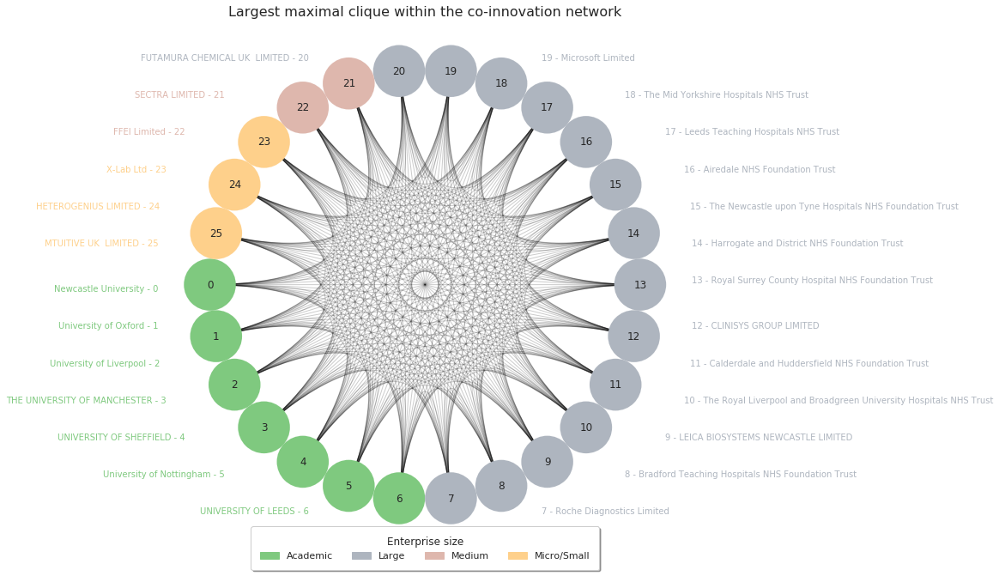

In [506]:
# Import necessary modules
import networkx as nx
from nxviz import CircosPlot
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import to_hex

# Find the author(s) that are part of the largest maximal clique: largest_clique
largest_clique = sorted(nx.find_cliques(G), key=lambda x:len(x))[-1]

# Create the subgraph of the largest_clique: G_lc
G_lc = G.subgraph(largest_clique)

# Add the degree and enterprise size to each node according to the main graph
for n, d in G_lc.nodes(data=True):

    # Calculate the degree of each node
    G_lc.node[n]['degree'] = nx.degree(G,n)
    
        # Add the enterprize size to each node
    G_lc.node[n]['Enterprise_Size'] = list(df['Enterprise_Size'].loc[df['Participant_Name'] == n])[0]
    
# Setting seaborn style
sns.set_style("whitegrid")

# Create the CircosPlot object: c
c = CircosPlot(graph=G_lc,
#               node_size='degree',
              node_color="Enterprise_Size",
               node_label_rotation = True,
               node_label_color = True,
               alpha = 1,
#                node_order = "Enterprise_Size",
               node_labels = True,
               fontsize = 10,
#                edge_color = 'Project_Number',
               fontfamily = "sans-serif",
               group_order='alphabetically',
               node_label_layout = 'numbers',
#                group_label_position = "middle",
              node_grouping="Enterprise_Size",
#                cmap = colors_cmap,
#                group_label_color=True,
#                group_label_offset=-350,
               figsize = (16,16))

# Draw the CircosPlot to the screen
c.draw()
c.figure.tight_layout()

# Descriptions the plot
plt.title('Largest maximal clique within the co-innovation network',fontsize=16)


# Get the label and color for each group used by nxviz
seen = set()
colors_group = [x for x in c.node_colors if not (x in seen or seen.add(x))] #Gets colors in RGBA
labels_group = sorted(list(set([c.graph.node[n][c.node_color] for n in c.nodes]))) #Gets group labels

# Create patchList to use as handle for plt.legend()
patchList = []
for color, label in zip(colors_group, labels_group):
    color = to_hex(color, keep_alpha=True) #Convert RGBA to HEX value
    data_key = mpatches.Patch(color=color, label=label)
    patchList.append(data_key)

# Set the labels with the custom patchList
plt.legend(handles=patchList,
           loc="lower center",
           title="Enterprise size",
           ncol=4, # 4 columns to spread the legends
           borderpad=1,
           bbox_to_anchor =(0.5, -0.05), # To move the legend box lower than the graph
           shadow=True,
           fancybox=True)

# Save figure
plt.savefig('/project/content/network_graphs/maximalClique.png', format='png', dpi=400, bbox_inches = "tight")

# Display graph
plt.show()

The largest clique identified above corresponds to a  digital pathology and artificial intelligence (AI) consortium known as Northern Pathology Imaging Co-operative. This consortium develops "artificial intelligence tools to help diagnose cancer and other diseases". https://www.virtualpathology.leeds.ac.uk/npic/

In the case of Cisco, it is part of the following number of cliques:

In [502]:
# Find all of Cisco's cliques
Ciscos_cliques = nx.cliques_containing_node(G, nodes='Cisco', cliques=None)

# Count and print the number of maximal cliques in G
print("The number of maximal cliques that Cisco is part of are: ", len(list(Ciscos_cliques)))

The number of maximal cliques that Cisco is part of are:  26


Cisco's maximal clique is:

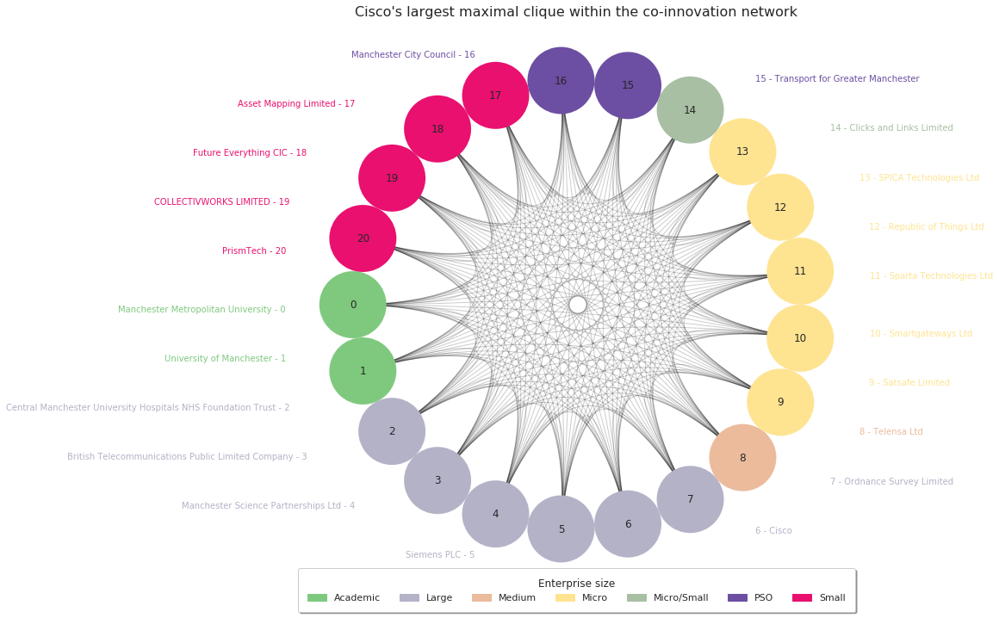

In [504]:
# Import necessary modules
import networkx as nx
from nxviz import CircosPlot
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import to_hex

# Find the author(s) that are part of the largest maximal clique: largest_clique
Cisco_largest_clique = sorted(Ciscos_cliques, key=lambda x:len(x))[-1]

# Create the subgraph of the largest_clique: G_lc
G_cisco = G.subgraph(Cisco_largest_clique)

# Add the degree and enterprise size to each node according to the main graph
for n, d in G_cisco.nodes(data=True):

    # Calculate the degree of each node
    G_cisco.node[n]['degree'] = nx.degree(G,n)
    
        # Add the enterprize size to each node
    G_cisco.node[n]['Enterprise_Size'] = list(df['Enterprise_Size'].loc[df['Participant_Name'] == n])[0]
    
# Setting seaborn style
sns.set_style("whitegrid")

# Create the CircosPlot object: c
c_c = CircosPlot(graph=G_cisco,
#               node_size='degree',
              node_color="Enterprise_Size",
               node_label_rotation = True,
               node_label_color = True,
               alpha = 1,
#                node_order = "Enterprise_Size",
               node_labels = True,
               fontsize = 10,
#                edge_color = 'Project_Number',
               fontfamily = "sans-serif",
               group_order='alphabetically',
               node_label_layout = 'numbers',
#                group_label_position = "middle",
              node_grouping="Enterprise_Size",
#                cmap = colors_cmap,
#                group_label_color=True,
#                group_label_offset=-350,
               figsize = (16,16))

# Draw the CircosPlot to the screen
c_c.draw()
c_c.figure.tight_layout()

# Descriptions the plot
plt.title('Cisco\'s largest maximal clique within the co-innovation network',fontsize=16)


# Get the label and color for each group used by nxviz
seen = set()
colors_group = [x for x in c_c.node_colors if not (x in seen or seen.add(x))] #Gets colors in RGBA
labels_group = sorted(list(set([c_c.graph.node[n][c_c.node_color] for n in c_c.nodes]))) #Gets group labels

# Create patchList to use as handle for plt.legend()
patchList = []
for color, label in zip(colors_group, labels_group):
    color = to_hex(color, keep_alpha=True) #Convert RGBA to HEX value
    data_key = mpatches.Patch(color=color, label=label)
    patchList.append(data_key)

# Set the labels with the custom patchList
plt.legend(handles=patchList,
           loc="lower center",
           title="Enterprise size",
           ncol=7, # 4 columns to spread the legends
           borderpad=1,
           bbox_to_anchor =(0.5, -0.05), # To move the legend box lower than the graph
           shadow=True,
           fancybox=True)

# Save figure
plt.savefig('/project/content/network_graphs/Cisco/Cisco_Maximal_Clique.png', format='png', dpi=400, bbox_inches = "tight")

# Display graph
plt.show()

## 4.11 Cisco's Network

After having a clear understanding of the co-innovation network and how the nodes are connected, this section looks directly into Cisco's network:

In [8]:
# Function to get specific nodes that are part of a community or related to an specific node
def get_nodes_and_neighbors(G, nodes_of_interest):
    """
    Returns a subgraph of the graph `G` with only the `nodes_of_interest` and their neighbors.
    """
    nodes_to_draw = []

    # Iterate over the nodes of interest
    for n in nodes_of_interest:

        # Append the nodes of interest to nodes_to_draw
        nodes_to_draw.append(n)

        # Iterate over all the neighbors of node n
        for neighbors in G.subgraph(n):

            # Append the neighbors of n to nodes_to_draw
            nodes_to_draw.append(neighbors)

    return G.subgraph(nodes_to_draw)

Prepare dataframe with only the rows corresponding to Cisco's projects:

In [9]:
Cisco_projects = df[df["Participant_Name"].str.contains(r'Cisco')]
Cisco_projects = set(list(Cisco_projects['Project_Number']))

# Get the network of all the companies that had work with Cisco and their neighbors
Cisco_networkDF = df[df['Project_Number'].isin(Cisco_projects)]

# Cisco_networkDF['Programme_Title'].head()
# set(list(Cisco_networkDF['Programme_Title']))

Cisco_networkDF = Cisco_networkDF[['Sector',
                                   'Programme_Title',
                                   'Project_Number',
                                   'Participant_Name',
                                   'Enterprise_Size',
                                   'Competition_Year']]
# Convert year to int
Cisco_networkDF['Competition_Year'] = Cisco_networkDF['Competition_Year'].astype(int)

# Add the degree of each node
degrees=dict(G.degree(G.nodes())) # Get all the nodes and their degrees
Cisco_networkDF['degree'] = [degrees[x] for x in Cisco_networkDF['Participant_Name'] 
                             if x in degrees.keys()]

# Leave only companies that have worked with Cisco
Cisco_networkDF = Cisco_networkDF[~Cisco_networkDF["Participant_Name"].str.contains(r'Cisco')]
Cisco_networkDF = Cisco_networkDF[~Cisco_networkDF["Participant_Name"].str.contains(r'CISCO')]

Cisco_networkDF.head()

,Sector,Programme_Title,Project_Number,Participant_Name,Enterprise_Size,Competition_Year,degree
4287,Open & Commercialisation,Robotics & Autonomous Systems Application over...,103680,Cortexica Vision Systems Limited,Small,2017,3
5060,"Manufacturing, Materials & Mobility",Connected and Autonomous Vehicles Test Bed 2,104032,TRL LIMITED,RTO,2017,19
5062,"Manufacturing, Materials & Mobility",Connected and Autonomous Vehicles Test Bed 2,104032,Cubic Transportation Systems Ltd,Large,2017,10
5063,"Manufacturing, Materials & Mobility",Connected and Autonomous Vehicles Test Bed 2,104032,DG CITIES LIMITED,RTO,2017,31
5064,"Manufacturing, Materials & Mobility",Connected and Autonomous Vehicles Test Bed 2,104032,Loughborough University,Academic,2017,205


Create Cisco's network and get the major statistics about it:

In [10]:
# Filter all the projects that Cisco has been part with its two legal identities
Cisco_projects = df[df["Participant_Name"].str.contains(r'Cisco')]
# Cisco_projects = Cisco_projects.append(df[df["Participant_Name"].str.contains(r'CISCO')])
Cisco_projects = set(list(Cisco_projects['Project_Number']))

# Get the network of all the companies that had work with Cisco and their neighbors
Cisco_network = list(set([x for x, y in zip(df["Participant_Name"], df["Project_Number"]) 
                 if y in Cisco_projects]))

# Create network
Cisco_network = get_nodes_and_neighbors(G,Cisco_network)

print(nx.info(Cisco_network))

Name: 
Type: Graph
Number of nodes: 74
Number of edges: 459
Average degree:  12.4054


The assignment of weights to each edge is based upon how many times they have stablish relationships with Cisco, which is the same as how many times they have work together or total number of projects. Of course, all of the nodes in the network have had a relationship with Cisco or they would not be part of Cisco's network. However, the purpose of the weights is to find the nodes that have had the most relationships with Cisco.

In [11]:
# Iterate over all the edges (with metadata)
for u, v, d in Cisco_network.edges(data=True):

#     # Check if node Cisco is involved
    if 'Cisco' in [u, v]:
        
        if 'Cisco' == u:

            # Set the weight of relationships to total number of projects
            Cisco_network.edges[u, v]['weight'] = len(set(list(Cisco_networkDF['Project_Number'].loc[Cisco_networkDF['Participant_Name'] == v])))
        
        else:
          # Set the weight of relationships to total number of projects
            Cisco_network.edges[u, v]['weight'] = len(set(list(Cisco_networkDF['Project_Number'].loc[Cisco_networkDF['Participant_Name'] == u])))
    
    else:
        Cisco_network.edges[u, v]['weight'] = 0

Adding grouping of the nodes according to their type of enterprise size:

In [12]:
for n, d in Cisco_network.nodes(data=True):

    # Add the enterprize size to each node
    Cisco_network.node[n]['Enterprise_Size'] = list(df['Enterprise_Size'].loc[df['Participant_Name'] == n])[0]

Since Cisco's network only has 462 nodes, it would be ideal to use bokeh and holoviews to get an interactive representation of the network. This is means that the interactive graph would not cause a constraint to the size of the notebook and rendering in the browser that loads this notebook:  

### 4.11.1 Create and plot the network with different layouts

In this section, different layouts used with the purpose of finding a layout that facilitates an optimal view and understanding of Cisco's network, which was created above as a rooted tree network with Cisco as the root.

In [35]:
# Create directory to save descriptive graphs
!mkdir -p content/network_graphs/Cisco

First, the circular layout is tried:

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


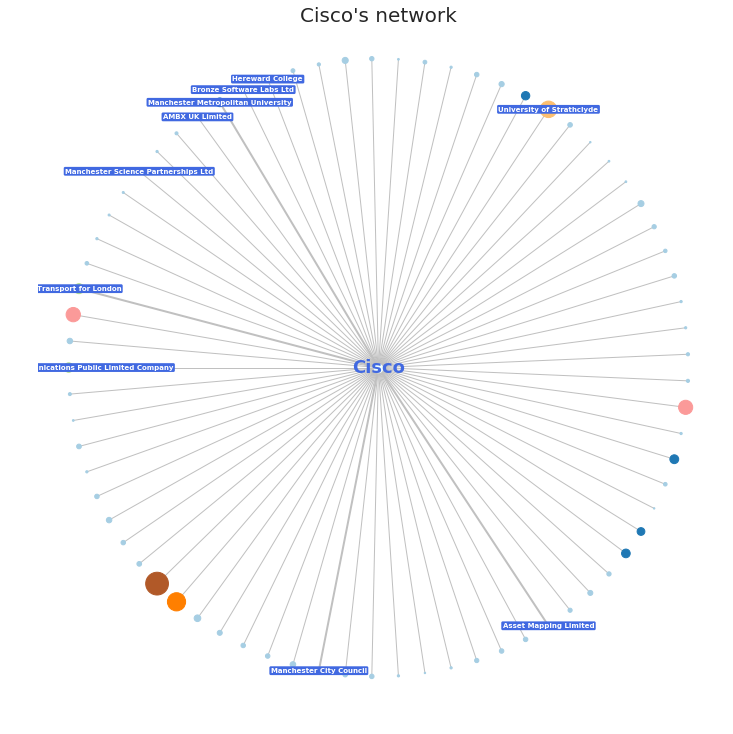

In [195]:
from matplotlib.patches import FancyBboxPatch

try:
    import pygraphviz
    from networkx.drawing.nx_agraph import graphviz_layout
except ImportError:
    try:
        import pydot
        from networkx.drawing.nx_pydot import graphviz_layout
    except ImportError:
        raise ImportError("This example needs Graphviz and either "
                          "PyGraphviz or pydot")
        
# Creating visualization
# plt.rcParams['figure.constrained_layout.use'] = True
plt.figure(figsize=(10,10))
# fig.set_constrained_layout_pads(w_pad=200, h_pad=0)

# Create layout
pos = graphviz_layout(Cisco_network, prog='twopi', root="Cisco", weight='weight')
# pos = nx.spring_layout(Cisco_network, pos=None, iterations=2000)

# sizes for nodes
sizes = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n != 'Cisco']

# Set node colors according to community   
# node_colors = [partition.get(node) for node in Cisco_network.nodes() if node != 'Cisco']

# Draw the network
nx.draw_networkx_nodes(Cisco_network,
                       pos=pos,
                       node_size = sizes,
                       cmap = 'Paired',
                       nodelist = [n for n, d in Cisco_network.nodes(data=True) if n != 'Cisco'],
                       node_color = sizes,
                       label = "Cisco's network with " + str(len(Cisco_network.nodes(data=True))) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n == 'Cisco']
nx.draw_networkx_nodes(Cisco_network,
                           pos=pos,
                           node_size = size_top,
                           nodelist=[n for n, d in Cisco_network.nodes(data=True) if n == 'Cisco'],
                           node_color = '#F0FFFF',
                           label = "Cisco",
                           alpha = 1)

# Draw the edges
weight = [Cisco_network.edges[u, v]['weight'] for u, v, d in Cisco_network.edges(data=True)]
nx.draw_networkx_edges(Cisco_network,
                       pos=pos,
                       edgelist=Cisco_network.edges(),
                       edge_color = '#C0C0C0',
#                        edge_cmap = 'greys',
                       alpha = 1,
                       width=weight,
                       arrowsize = 0.5)
    
# Labeling Cisco
label_cisco = {'Cisco':'Cisco'}  
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_cisco,
                        font_weight='bold',
                        font_size=18,
                        font_color='#4169E1')

#Filtering the top 5 companies with more projects with Cisco
moreEdges = list(Cisco_networkDF['Participant_Name'].value_counts().reset_index(name='Total').rename(columns={'index':'Participant_Name'}).iloc[:10,]['Participant_Name'])

# Creating the labels
label_edges_Cisco = {}    
for node in Cisco_network.nodes():
    if node in moreEdges:
        #set the node name as the key and the label as its value 
        label_edges_Cisco[node] = node

# Labeling companies with more relationships with Cisco        
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_edges_Cisco,
                        font_weight='bold',
                        font_size=7,
                        bbox=dict(boxstyle="round", 
                                  facecolor='#4169E1', 
                                  alpha=1,
                                  pad=0.2,
                                  edgecolor='none'),
                        font_color='#FFFFFF')

# Describe network
plt.title('Cisco\'s network', fontsize=20)
plt.axis('off')

plt.tight_layout(pad=0)

# Save figure
plt.savefig('content/network_graphs/Cisco/CiscoCircularNetwork.png', 
            format='png', 
            dpi=600, 
            bbox_inches = "tight",
            pad_inches=0)

# Display plot
plt.show()

In [171]:
# Saving layout created
import pickle

pickle.dump(pos, open( "/project/content/pos_Cisco_spring_layout.p", "wb" ) )

Next, the Spring layout or Fruchterman and Reingold layout drawing algorithms are used:

In [190]:
# Create layout
pos = nx.spring_layout(Cisco_network)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


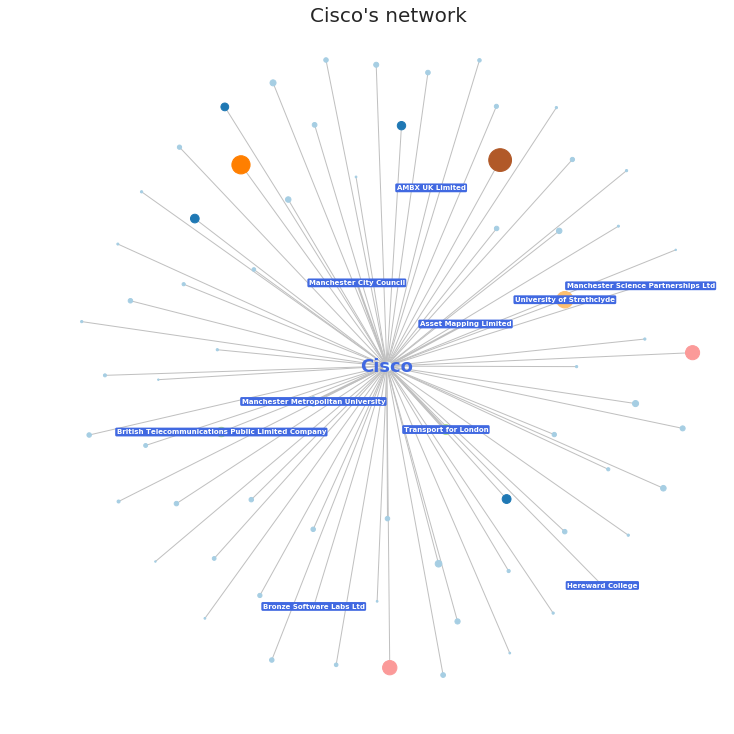

In [192]:
from matplotlib.patches import FancyBboxPatch
        
# Creating visualization
# plt.rcParams['figure.constrained_layout.use'] = True
plt.figure(figsize=(10,10))
# fig.set_constrained_layout_pads(w_pad=200, h_pad=0)

# sizes for nodes
sizes = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n != 'Cisco']

# Set node colors according to community   
# node_colors = [partition.get(node) for node in Cisco_network.nodes() if node != 'Cisco']

# Draw the network
nx.draw_networkx_nodes(Cisco_network,
                       pos=pos,
                       node_size = sizes,
                       cmap = 'Paired',
                       nodelist = [n for n, d in Cisco_network.nodes(data=True) if n != 'Cisco'],
                       node_color = sizes,
                       label = "Cisco's network with " + str(len(Cisco_network.nodes(data=True))) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n == 'Cisco']
nx.draw_networkx_nodes(Cisco_network,
                           pos=pos,
                           node_size = size_top,
                           nodelist=[n for n, d in Cisco_network.nodes(data=True) if n == 'Cisco'],
                           node_color = '#F0FFFF',
                           label = "Cisco",
                           alpha = 1)

# Draw the edges
weight = [Cisco_network.edges[u, v]['weight'] for u, v, d in Cisco_network.edges(data=True)]
nx.draw_networkx_edges(Cisco_network,
                       pos=pos,
                       edgelist=Cisco_network.edges(),
                       edge_color = '#C0C0C0',
#                        edge_cmap = 'greys',
                       alpha = 1,
                       width=weight,
                       arrowsize = 0.5)
    
# Labeling Cisco
label_cisco = {'Cisco':'Cisco'}  
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_cisco,
                        font_weight='bold',
                        font_size=18,
                        font_color='#4169E1')

#Filtering the top 5 companies with more projects with Cisco
moreEdges = list(Cisco_networkDF['Participant_Name'].value_counts().reset_index(name='Total').rename(columns={'index':'Participant_Name'}).iloc[:10,]['Participant_Name'])

# Creating the labels
label_edges_Cisco = {}    
for node in Cisco_network.nodes():
    if node in moreEdges:
        #set the node name as the key and the label as its value 
        label_edges_Cisco[node] = node

# Labeling companies with more relationships with Cisco        
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_edges_Cisco,
                        font_weight='bold',
                        font_size=7,
                        bbox=dict(boxstyle="round", 
                                  facecolor='#4169E1', 
                                  alpha=1,
                                  pad=0.2,
                                  edgecolor='none'),
                        font_color='#FFFFFF')

# Describe network
plt.title('Cisco\'s network', fontsize=20)
plt.axis('off')

plt.tight_layout(pad=0)

# Save figure
plt.savefig('content/network_graphs/Cisco/CiscoSpringNetwork.png',
            format='png', 
            dpi=600, 
            bbox_inches = "tight",
            pad_inches=0)

# Display plot
plt.show()

The previous graph gives a nice star. Still, other layout drawing algorithms should be tried like Kamada and Kawai:

In [198]:
# Create layout
pos = nx.kamada_kawai_layout(Cisco_network, weight='weight')

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/layout.py:701: RuntimeWarning: divide by zero encountered in true_divide
  costargs = (np, 1 / (dist_mtx + np.eye(dist_mtx.shape[0]) * 1e-3),


In [208]:
# Saving layout created
import pickle

pickle.dump(pos, open( "/project/content/pos_Cisco_kamada_kawai.p", "wb" ) )

In [7]:
Load back created layout
import pickle

pos = pickle.load(open("/project/content/pos_Cisco_kamada_kawai.p", "rb"))

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


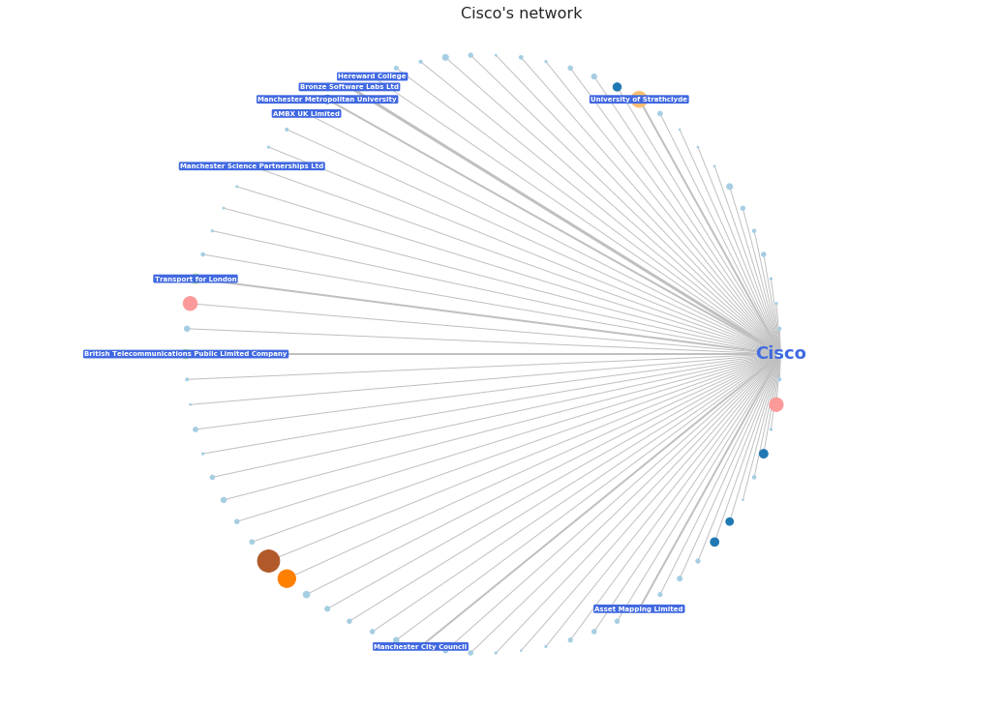

In [207]:
from matplotlib.patches import FancyBboxPatch
        
# Creating visualization
plt.figure(figsize=(15,10))
plt.subplots_adjust(left=0.04, right=0.06)

# sizes for nodes
sizes = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n != 'Cisco']

# Set node colors according to community   
# node_colors = [partition.get(node) for node in Cisco_network.nodes() if node != 'Cisco']

# Draw the network
nx.draw_networkx_nodes(Cisco_network,
                       pos=pos,
                       node_size = sizes,
                       cmap = 'Paired',
                       nodelist = [n for n, d in Cisco_network.nodes(data=True) if n != 'Cisco'],
                       node_color = sizes,
                       label = "Cisco's network with " + str(len(Cisco_network.nodes(data=True))) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [Cisco_network.node[n]['degree'] for n, d in Cisco_network.nodes(data=True) if n == 'Cisco']
nx.draw_networkx_nodes(Cisco_network,
                           pos=pos,
                           node_size = size_top,
                           nodelist=[n for n, d in Cisco_network.nodes(data=True) if n == 'Cisco'],
                           node_color = '#F0FFFF',
                           label = "Cisco",
                           alpha = 1)

# Draw the edges
weight = [Cisco_network.edges[u, v]['weight'] for u, v, d in Cisco_network.edges(data=True)]
nx.draw_networkx_edges(Cisco_network,
                       pos=pos,
                       edgelist=Cisco_network.edges(),
                       edge_color = '#C0C0C0',
#                        edge_cmap = 'greys',
                       alpha = 1,
                       width=weight,
                       arrowsize = 0.5)
    
# Labeling Cisco
label_cisco = {'Cisco':'Cisco'}  
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_cisco,
                        font_weight='bold',
                        font_size=18,
                        font_color='#4169E1')

#Filtering the top 5 companies with more projects with Cisco
moreEdges = list(Cisco_networkDF['Participant_Name'].value_counts().reset_index(name='Total').rename(columns={'index':'Participant_Name'}).iloc[:10,]['Participant_Name'])

# Creating the labels
label_edges_Cisco = {}    
for node in Cisco_network.nodes():
    if node in moreEdges:
        #set the node name as the key and the label as its value 
        label_edges_Cisco[node] = node

# Labeling companies with more relationships with Cisco        
nx.draw_networkx_labels(Cisco_network,
                        pos,
                        label_edges_Cisco,
                        font_weight='bold',
                        font_size=7,
                        bbox=dict(boxstyle="round", 
                                  facecolor='#4169E1', 
                                  alpha=1,
                                  pad=0.2,
                                  edgecolor='none'),
                        font_color='#FFFFFF')

# Describe network
plt.title('Cisco\'s network', fontsize=16)
plt.axis('off')

plt.tight_layout(pad=0)

# Save figure
plt.savefig('content/network_graphs/Cisco/Cisco_kamada_kawaiNetwork.png',
            format='png', 
            dpi=600, 
            bbox_inches = "tight",
            pad_inches=0)

# Display plot
plt.show()

The figure above gives a more understandable visualisation of Cisco's network. Next, the an interactive visualisation of Cisco's network is developed:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
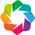

In [23]:
# Import needed libraries for loading of files and display of graphs
import holoviews as hv

# Load HoloViews and bokeh
hv.extension('bokeh')

In [26]:
import hvplot
import hvplot.networkx as hvnx
import holoviews as hv
from holoviews.operation.datashader import bundle_graph, datashade


try:
    import pygraphviz
    from networkx.drawing.nx_agraph import graphviz_layout
except ImportError:
    try:
        import pydot
        from networkx.drawing.nx_pydot import graphviz_layout
    except ImportError:
        raise ImportError("This example needs Graphviz and either "
                          "PyGraphviz or pydot")
#Define hook to control certain elements of the graph like the alignment of the title
def hook(plot, element):
#     print('plot.state:   ', plot.state)
#     print('plot.handles: ', sorted(plot.handles.keys()))
#     plot.handles['xaxis'].axis_label_text_color = 'red'
#     plot.handles['yaxis'].axis_label_text_color = 'blue'
    plot.state.title.align = 'center' # Align the title of the graph
    
# Create random layout positions
# This will accelerate the drawing of the network
pos = graphviz_layout(Cisco_network, prog='twopi', root="Cisco")

# Define custom color map
colors_cmap = ['#000000']+hv.Cycle('Category20').values

# Graph network
Cisco_network_interactive = hvnx.draw(Cisco_network,
                                      pos,
#                                       font_size = 8,
                                      with_labels = False,                                      
#                                       font_color = "greys",
                                      node_size = 'degree',
                                      node_color='degree',
                                      alpha = 0.7,
                                      arrowsize = 2, linewidths = 0,
                                      width=600, height=600,
                                      edge_color='weight',
                                      edge_width = 'weight',
                                      cmap = colors_cmap,
                                      edge_cmap="greys").opts(title="Cisco's network within the co-innovation network of UK",
                                 fontsize={'title': 10},
                                       tools=['hover'],
                                hooks=[hook])

# Display network
Cisco_network_interactive

# #Edge bundling
# Cisco_network_interactive = bundle_graph(Cisco_network_interactive)
# Cisco_network_interactive

# #Datashading the graph
# Cisco_network_interactive = datashade(Cisco_network_interactive, normalization='linear', width=750, height=1500) * Cisco_network_interactive.nodes.opts(color='degree', size='degree', width=750, height=750, cmap=colors_cmap)

# #Showing graph
# Cisco_network_interactive

:Graph   [start,end]   (Competition_Year,Enterprise_Size,Innovate_UK_Product_Type,Project_Number,Project_Title,Sector,Source,Target,weight)

Save the interactive visualisation of Cisco's network. This would allow for it to be visualise in the jupyter notebook named "Interactive_visualisations":

In [27]:
#To save file
file_name = 'Cisco_network_interactive'
file_path = "content/network_graphs/" + file_name

# Save files in html for display in other notebook
hvplot.save(Cisco_network_interactive, file_path + '.html')

### 4.11.2 Understanding Cisco's network

After plotting Cisco's network, this section describes it starting with the following Sankey diagram shows the size of enterprises that Cisco works the most with:

In [52]:
from ipysankeywidget import SankeyWidget
from floweaver import *
from ipywidgets import Layout

# Filter all the projects that Cisco has been part and the partner that it has work with
enterpriseCisco = networkDF[networkDF["Source"].str.contains(r'Cisco')][['Source','Target']]

# Adding the enterprise size of target companies within the edges
enterpriseCisco['Target_Enterprise'] = [networkDF.loc[networkDF['Source'] == x, 'Enterprise_Size'].iloc[0] 
                                      for x in enterpriseCisco['Target']]

# Count number of companies within each sector that Cisco has worked with
enterpriseCisco = enterpriseCisco.groupby(["Source", "Target_Enterprise"]).size().reset_index(name="value")

# Edit names of columns to adapt to Sankey library
enterpriseCisco.rename(columns={'Source':'source','Target_Enterprise':'target'}, inplace=True)

# Converting pandas dataframe to dictionary
enterpriseCisco = enterpriseCisco.to_dict('records')

# Using Sankey widget to get D3 function for drawing sankey diagrams
SankeyWidget(links=enterpriseCisco,
            linkLabelFormat='.1f',
             layout=Layout(height='700', 
                           width='750'),
             margins=dict(top=0, 
                          bottom=0, 
                          left=50, 
                          right=250)).auto_save_png('/project/content/network_graphs/Cisco/Cisco_enterprise_size_Sankey.png')

SankeyWidget(layout=Layout(height='700', width='750'), linkLabelFormat='.1f', links=[{'source': 'Cisco', 'targ…

Cisco works mostly with Large companies in projects of co-innovation. The next Sankey diagram shows most of sectors in which Cisco's co-innovates:

In [53]:
from ipysankeywidget import SankeyWidget
from ipywidgets import Layout

# Filter all the projects that Cisco has been part and the partner that it has work with
sectorCisco = networkDF[networkDF["Source"].str.contains(r'Cisco')][['Source','Sector']]

# Count number of companies within each sector that Cisco has worked with
sectorCisco = sectorCisco.groupby(["Source", "Sector"]).size().reset_index(name="value")

# Edit names of columns to adapt to Sankey library
sectorCisco.rename(columns={'Source':'source','Sector':'target'}, inplace=True)

# Using Sankey widget to get D3 function for drawing sankey diagrams
SankeyWidget(links=sectorCisco.to_dict('records'), # Converting pandas dataframe to dictionary
             description='Another button with the same layout',
             linkLabelFormat='.1f',
             layout=Layout(title="Cisco's relationships within each sector",
                           height='700',
                           width='750'),
             margins=dict(top=0, 
                          bottom=0, 
                          left=50, 
                          right=250)).auto_save_png('/project/content/network_graphs/Cisco/Cisco_Sectors_Sankey.png')

SankeyWidget(layout=Layout(height='700', width='750'), linkLabelFormat='.1f', links=[{'source': 'Cisco', 'targ…

In [55]:
from ipysankeywidget import SankeyWidget
from ipywidgets import Layout

# Filter all the projects that Cisco has been part and the partner that it has work with
ProjectsCisco = networkDF[networkDF["Source"].str.contains(r'Cisco')][['Sector','Project_Title']]

# Count number of companies within each sector that Cisco has worked with
ProjectsCisco = ProjectsCisco.groupby(["Sector", "Project_Title"]).size().reset_index(name="value")

# Edit names of columns to adapt to Sankey library
ProjectsCisco.rename(columns={'Sector':'source','Project_Title':'target'}, inplace=True)

# Append the projects for each sector
sectorProjectCisco = sectorCisco.append(ProjectsCisco)

# Using Sankey widget to get D3 function for drawing sankey diagrams
SankeyWidget(links=sectorProjectCisco.to_dict('records'), # Converting pandas dataframe to dictionary
             description='Another button with the same layout',
             linkLabelFormat='.1f',
             layout=Layout(title="Cisco's relationships within each sector",
                           height='800',
                           width='1200'),
             margins=dict(top=0, 
                          bottom=0, 
                          left=50, 
                          right=700)).auto_save_png('/project/content/network_graphs/Cisco/Cisco_Sectors_Projects_Sankey.png')

SankeyWidget(layout=Layout(height='800', width='1200'), linkLabelFormat='.1f', links=[{'source': 'Cisco', 'tar…

The get a more detailed view of the network as well as doing some clustering, Vega.js, which uses D3.js, would be used for graphing. First, the data must be prepared, shaped, and saved in a JSON file for graphing in Vegan:

In [271]:
import json

#Create root for JSON file
cisco_edges = [{'id': 1, 'name': 'Cisco'}]

# Set ID counter
idNumbers = 1 #Because of the inicial one given to Cisco

#To iterate for the first part
name_Sectors = set(list(Cisco_networkDF['Sector']))

for sector in name_Sectors:
    
    # Control of IDs
    idNumbers +=1
    idSector = idNumbers
    
    #Append sector
    cisco_edges.append({'id': idNumbers, 'name': sector, 'parent':1})
       
    #Getting only the data for the specific sector
    Sectors = Cisco_networkDF[Cisco_networkDF["Sector"]==sector]
    
    #Getting only the names of the project titles
    Programme_Titles  = set(list(Sectors['Programme_Title']))
    
    for ProgTitle in Programme_Titles:
        
#         # Control of IDs
#         idNumbers +=1
#         idProgram = idNumbers
    
        #Append Program title
#         json_cisco.append({'id': idNumbers, 'name': ProgTitle, 'parent':idSector})
        
        #Getting only the data for the participants in specific projects
        Participants = Cisco_networkDF[Cisco_networkDF["Programme_Title"]==ProgTitle]
        
        for index, row in Participants.iterrows():
            
            # Control of IDs
            idNumbers +=1
        
            #Append Participan name and degree
            cisco_edges.append({'id': idNumbers, 'name': row['Participant_Name'], 'parent':idSector, 'size':row['degree']})
            
with open('/project/content/cisco_edges' +'.json', 'w') as outfile:
    json.dump(cisco_edges, outfile, indent=4)  
            

For a visualisation of all of Cisco's edges in the different sectors of the co-innovation network, a radial tree layout for clustering is used:

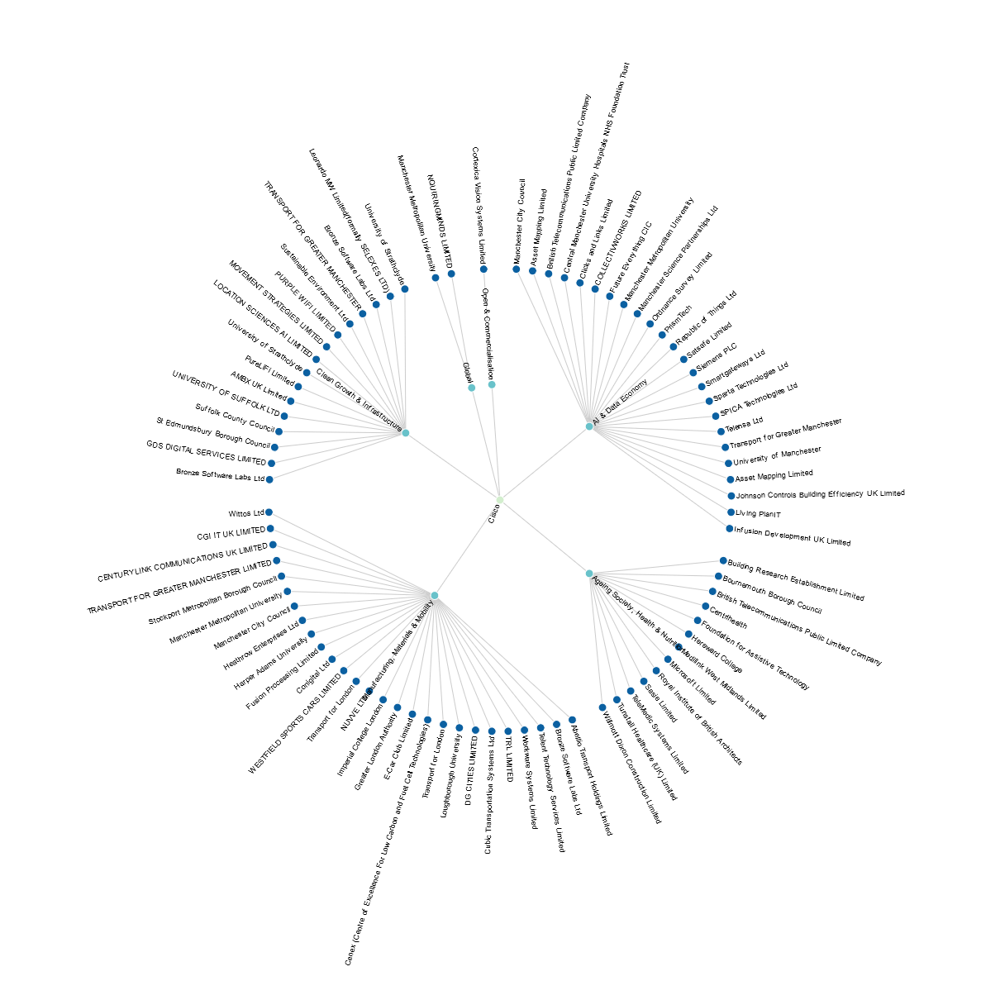

In [56]:
from vega import Vega

Vega(
{
  "$schema": "https://vega.github.io/schema/vega/v5.json",
  "width": 1200,
  "height": 1200,
  "padding": 5,
  "autosize": "none",

  "signals": [
    {
      "name": "labels", "value": True,
      "bind": {"input": "checkbox"}
    },
    {
      "name": "radius", "value": 280,
      "bind": {"input": "range", "min": 20, "max": 600}
    },
    {
      "name": "extent", "value": 360,
      "bind": {"input": "range", "min": 0, "max": 360, "step": 1}
    },
    {
      "name": "rotate", "value": 0,
      "bind": {"input": "range", "min": 0, "max": 360, "step": 1}
    },
    {
      "name": "layout", "value": "tidy",
      "bind": {"input": "radio", "options": ["tidy", "cluster"]}
    },
    {
      "name": "links", "value": "line",
      "bind": {
        "input": "select",
        "options": ["line", "curve", "diagonal", "orthogonal"]
      }
    },
    { "name": "originX", "update": "width / 2" },
    { "name": "originY", "update": "height / 2" }
  ],

  "data": [
    {
      "name": "tree",
      "url": "content/cisco_edges.json",
      "transform": [
        {
          "type": "stratify",
          "key": "id",
          "parentKey": "parent"
        },
        {
          "type": "tree",
          "method": {"signal": "layout"},
          "size": [1, {"signal": "radius"}],
          "as": ["alpha", "radius", "depth", "children"]
        },
        {
          "type": "formula",
          "expr": "(rotate + extent * datum.alpha + 270) % 360",
          "as":   "angle"
        },
        {
          "type": "formula",
          "expr": "PI * datum.angle / 180",
          "as":   "radians"
        },
        {
          "type": "formula",
          "expr": "inrange(datum.angle, [90, 270])",
          "as":   "leftside"
        },
        {
          "type": "formula",
          "expr": "originX + datum.radius * cos(datum.radians)",
          "as":   "x"
        },
        {
          "type": "formula",
          "expr": "originY + datum.radius * sin(datum.radians)",
          "as":   "y"
        }
      ]
    },
    {
      "name": "links",
      "source": "tree",
      "transform": [
        { "type": "treelinks" },
        {
          "type": "linkpath",
          "shape": {"signal": "links"}, "orient": "radial",
          "sourceX": "source.radians", "sourceY": "source.radius",
          "targetX": "target.radians", "targetY": "target.radius"
        }
      ]
    }
  ],

  "scales": [
    {
      "name": "color",
      "type": "linear",
      "range": {"scheme": "greenblue"},
      "domain": {"data": "tree", "field": "depth"},
      "zero": True
    }
  ],

  "marks": [
    {
      "type": "path",
      "from": {"data": "links"},
      "encode": {
        "update": {
          "x": {"signal": "originX"},
          "y": {"signal": "originY"},
          "path": {"field": "path"},
          "stroke": {"value": "#ccc"}
        }
      }
    },
    {
      "type": "symbol",
      "from": {"data": "tree"},
      "encode": {
        "enter": {
          "size": {"value": 100},
          "stroke": {"value": "#fff"}
        },
        "update": {
          "x": {"field": "x"},
          "y": {"field": "y"},
          "fill": {"scale": "color", "field": "depth"}
        }
      }
    },
    {
      "type": "text",
      "from": {"data": "tree"},
      "encode": {
        "enter": {
          "text": {"field": "name"},
          "fontSize": {"value": 9},
          "baseline": {"value": "middle"}
        },
        "update": {
          "x": {"field": "x"},
          "y": {"field": "y"},
          "dx": {"signal": "(datum.leftside ? -1 : 1) * 6"},
          "angle": {"signal": "datum.leftside ? datum.angle - 180 : datum.angle"},
          "align": {"signal": "datum.leftside ? 'right' : 'left'"},
          "opacity": {"signal": "labels ? 1 : 0"}
        }
      }
    }
  ]
}
)

Preparing the data to have a more holistic view of all the co-innovation partners of Cisco:

In [303]:
#Create root for JSON file
json_cisco = [{'id': 1, 'name': 'Cisco'}]

# Set ID counter
idNumbers = 1 #Because of the inicial one given to Cisco

#To iterate for the first part
name_Sectors = set(list(Cisco_networkDF['Sector']))

for sector in name_Sectors:
    
    # Control of IDs
    idNumbers +=1
    idSector = idNumbers
    
    #Append sector
    json_cisco.append({'id': idNumbers, 'name': sector, 'parent':1})
       
    #Getting only the data for the specific sector
    Sectors = Cisco_networkDF[Cisco_networkDF["Sector"]==sector]
    
    #Getting only the names of the project titles
    Programme_Titles  = set(list(Sectors['Programme_Title']))
    
    for ProgTitle in Programme_Titles:
        
        # Control of IDs
        idNumbers +=1
        idProgram = idNumbers
    
        #Append Program title
        json_cisco.append({'id': idNumbers, 'name': ProgTitle, 'parent':idSector})
        
        #Getting only the data for the participants in specific projects
        Participants = Cisco_networkDF[Cisco_networkDF["Programme_Title"]==ProgTitle]
        
        for index, row in Participants.iterrows():
            
            # Control of IDs
            idNumbers +=1
        
            #Append Participan name and degree
            json_cisco.append({'id': idNumbers, 'name': row['Participant_Name'], 'parent':idProgram, 'size':row['degree']})
            
with open('/project/content/json_cisco' +'.json', 'w') as outfile:
    json.dump(json_cisco, outfile, indent=4)  
            

To have a more detailed view of all of Cisco's co-innovation partners for each project within each category, a tree layout is used:

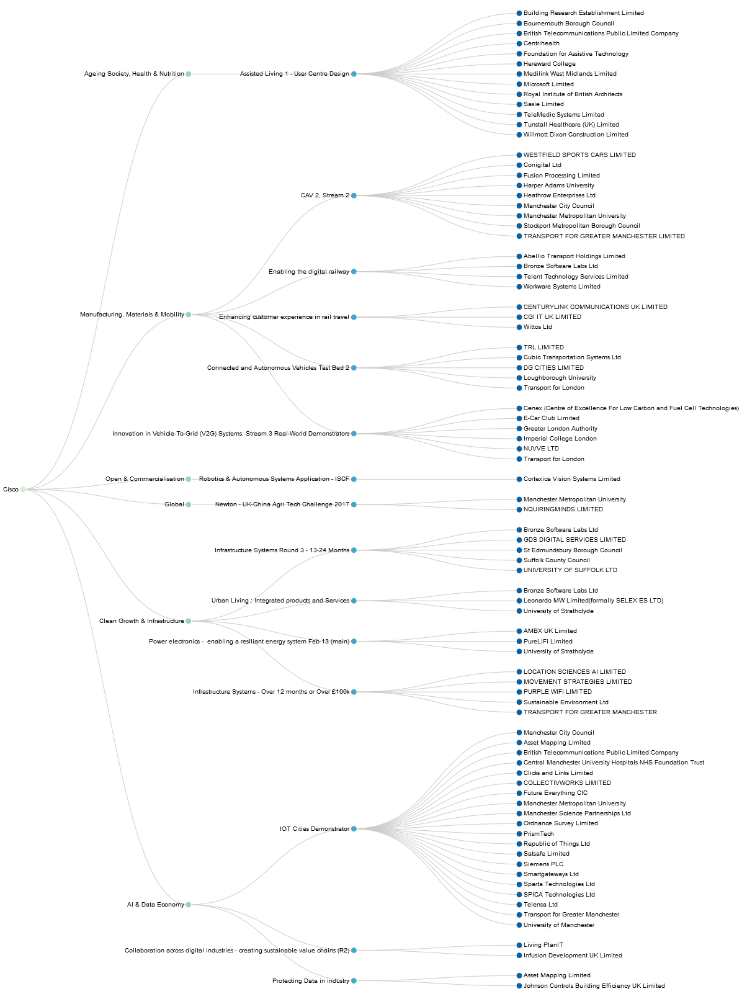

In [57]:
from vega import Vega

Vega(
{
  "$schema": "https://vega.github.io/schema/vega/v5.json",
  "width": 900,
  "height": 1600,
  "padding": 5,

  "signals": [
    {
      "name": "labels", "value": True,
      "bind": {"input": "checkbox"}
    },
    {
      "name": "layout", "value": "tidy",
      "bind": {"input": "radio", "options": ["tidy", "cluster"]}
    },
    {
      "name": "links", "value": "diagonal",
      "bind": {
        "input": "select",
        "options": ["line", "curve", "diagonal", "orthogonal"]
      }
    }
  ],

  "data": [
    {
      "name": "tree",
      "url": "content/json_cisco.json",
      "transform": [
        {
          "type": "stratify",
          "key": "id",
          "parentKey": "parent"
        },
        {
          "type": "tree",
          "method": {"signal": "layout"},
          "size": [{"signal": "height"}, {"signal": "width - 100"}],
          "as": ["y", "x", "depth", "children"]
        }
      ]
    },
    {
      "name": "links",
      "source": "tree",
      "transform": [
        { "type": "treelinks" },
        {
          "type": "linkpath",
          "orient": "horizontal",
          "shape": {"signal": "links"}
        }
      ]
    }
  ],

  "scales": [
    {
      "name": "color",
      "type": "linear",
      "range": {"scheme": "greenblue"},
      "domain": {"data": "tree", "field": "depth"},
      "zero": True
    }
  ],

  "marks": [
    {
      "type": "path",
      "from": {"data": "links"},
      "encode": {
        "update": {
          "path": {"field": "path"},
          "stroke": {"value": "#ccc"}
        }
      }
    },
    {
      "type": "symbol",
      "from": {"data": "tree"},
      "encode": {
        "enter": {
          "size": {"value": 100},
          "stroke": {"value": "#fff"}
        },
        "update": {
          "x": {"field": "x"},
          "y": {"field": "y"},
          "fill": {"scale": "color", "field": "depth"}
        }
      }
    },
    {
      "type": "text",
      "from": {"data": "tree"},
      "encode": {
        "enter": {
          "text": {"field": "name"},
          "fontSize": {"value": 10},
          "baseline": {"value": "middle"}
        },
        "update": {
          "x": {"field": "x"},
          "y": {"field": "y"},
          "dx": {"signal": "datum.children ? -7 : 7"},
          "align": {"signal": "datum.children ? 'right' : 'left'"},
          "opacity": {"signal": "labels ? 1 : 0"}
        }
      }
    }
  ]
}
)


### 4.11.3 Evolution of Cisco's network

This section examines the evolution of Cisco's network across the time.

In [497]:
# Function to create subgraph according to range of years
def create_network_for_yearX(year, G):
    
#     Cisco_projects = df[df["Participant_Name"].str.contains(r'Cisco')]
#     Cisco_projects = set(list(Cisco_projects['Project_Number']))

#     # Get the network of all the companies that had work with Cisco and their neighbors
#     Cisco_networkDF = df[df['Project_Number'].isin(Cisco_projects)]
    
    # Get the project number for all Cisco's projects before a year
    projects = list(set(list(df[(df['Competition_Year']<=year) & 
                                   (df["Participant_Name"].str.contains(r'Cisco'))]['Project_Number'])))
    
#     projects = list(set(Cisco_networkDF[Cisco_networkDF['Competition_Year']<=year]['Project_Number']))

    # Get the network of all the companies that had work with Cisco and their neighbors
    network = list(set([x for x, y in zip(df["Participant_Name"], df["Project_Number"]) 
                     if y in projects]))

    # Create network
    network = get_nodes_and_neighbors(G, network)
    
    # Iterate over all the edges (with metadata)
    for u, v, d in network.edges(data=True):

    #     # Check if node Cisco is involved
        if 'Cisco' in [u, v]:

            if 'Cisco' == u:

                # Set the weight of relationships to total number of projects
                network.edges[u, v]['weight'] = len(set(list(Cisco_networkDF[Cisco_networkDF['Competition_Year']<=year]['Project_Number'].loc[Cisco_networkDF[Cisco_networkDF['Competition_Year']<=year]['Participant_Name'] == v])))

            else:
              # Set the weight of relationships to total number of projects
                network.edges[u, v]['weight'] = len(set(list(Cisco_networkDF[Cisco_networkDF['Competition_Year']<=year]['Project_Number'].loc[Cisco_networkDF[Cisco_networkDF['Competition_Year']<=year]['Participant_Name'] == u])))

        else:
            network.edges[u, v]['weight'] = 0
    
    return network

# Create network
Cisco_network_2013 = create_network_for_yearX(2013,G)

print(nx.info(Cisco_network_2013))

Name: 
Type: Graph
Number of nodes: 23
Number of edges: 113
Average degree:   9.8261


Create layout for drawing Cisco's network until 2013:

In [161]:
# Create layout
pos = nx.kamada_kawai_layout(Cisco_network_2013)

Draw Cisco's network of 2013:

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


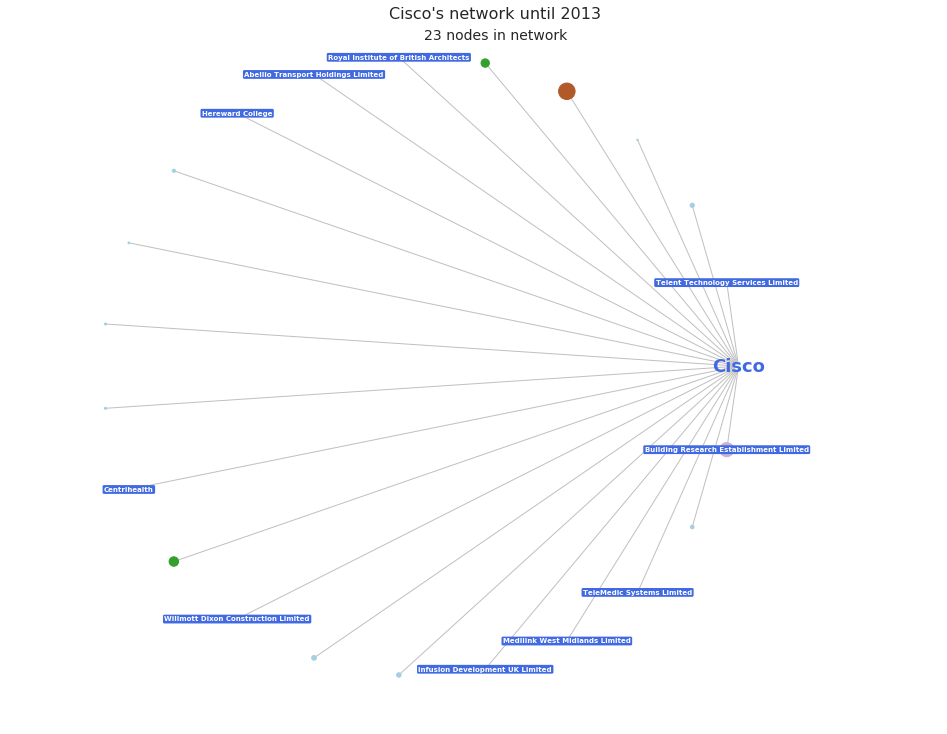

In [163]:
from matplotlib.patches import FancyBboxPatch
        
# Creating visualization
plt.rcParams['figure.constrained_layout.use'] = False
plt.figure(figsize=(15,10))
plt.subplots_adjust(left=0.04, right=0.06)

# fig.set_constrained_layout_pads(w_pad=200, h_pad=0)

# sizes for nodes according to degree
sizes = [Cisco_network_2013.node[n]['degree'] for n, d in Cisco_network_2013.nodes(data=True) if n != 'Cisco']

# Set node colors according to community   
# node_colors = [partition.get(node) for node in Cisco_network.nodes() if node != 'Cisco']

# Draw the network
nx.draw_networkx_nodes(Cisco_network_2013,
                       pos=pos,
                       node_size = sizes,
                       cmap = 'Paired',
                       nodelist = [n for n, d in Cisco_network_2013.nodes(data=True) if n != 'Cisco'],
                       node_color = sizes,
#                        label = "Cisco's network with " + str(len(Cisco_network_2013.nodes(data=True))) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [Cisco_network_2013.node[n]['degree'] for n, d in Cisco_network_2013.nodes(data=True) if n == 'Cisco']
nx.draw_networkx_nodes(Cisco_network_2013,
                           pos=pos,
                           node_size = size_top,
                           nodelist=[n for n, d in Cisco_network_2013.nodes(data=True) if n == 'Cisco'],
                           node_color = '#F0FFFF',
                           label = "Cisco",
                           alpha = 1)

# Draw the edges
weight = [Cisco_network_2013.edges[u, v]['weight'] for u, v, d in Cisco_network_2013.edges(data=True)]
nx.draw_networkx_edges(Cisco_network_2013,
                       pos=pos,
                       edgelist=Cisco_network_2013.edges(),
                       edge_color = '#C0C0C0',
                       alpha = 1,
                       width=weight,
                       arrowsize = 0.5)
    
# Labeling Cisco
label_cisco = {'Cisco':'Cisco'}  
nx.draw_networkx_labels(Cisco_network_2013,
                        pos,
                        label_cisco,
                        font_weight='bold',
                        font_size=18,
                        font_color='#4169E1')

#Filtering the top 10 companies with more projects with Cisco for 2013
moreEdges = list(Cisco_networkDF[Cisco_networkDF['Competition_Year']<=2013]['Participant_Name'].value_counts().reset_index(name='Total').rename(columns={'index':'Participant_Name'}).iloc[:10,]['Participant_Name'])

# Creating the labels
label_edges_Cisco = {}    
for node in Cisco_network_2013.nodes():
    if node in moreEdges:
        #set the node name as the key and the label as its value 
        label_edges_Cisco[node] = node

# Labeling companies with more relationships with Cisco        
nx.draw_networkx_labels(Cisco_network_2013,
                        pos,
                        label_edges_Cisco,
                        font_weight='bold',
                        font_size=7,
                        bbox=dict(boxstyle="round", 
                                  facecolor='#4169E1', 
                                  alpha=1,
                                  pad=0.2,
                                  edgecolor='none'),
                        font_color='#FFFFFF')

# Describe network
# plt.title('Cisco\'s network until 2013\n' + str(len(Cisco_network_2013.nodes(data=True))) + " nodes in network", fontsize=20)
plt.title('Cisco\'s network until 2013', fontsize=16)
plt.suptitle(str(len(Cisco_network_2013.nodes(data=True))) + " nodes in network", y=0.97, fontsize=14)
plt.axis('off')

plt.tight_layout(pad=0, w_pad=0.1)

# Save figure
plt.savefig('content/network_graphs/Cisco/CiscoSpringNetwork2013.png',
            format='png', 
            dpi=600, 
            bbox_inches = "tight",
            pad_inches=0)


# Display plot
plt.show()

Save layout of previous graph:

In [61]:
# Save layout created
import pickle

pickle.dump(pos, open( "/project/content/pos_Cisco_network_2013.p", "wb" ) )

Create Cisco's network for 2018:

In [498]:
# Create network
Cisco_network_2018 = create_network_for_yearX(2018,G)

print(nx.info(Cisco_network_2018))

Name: 
Type: Graph
Number of nodes: 74
Number of edges: 459
Average degree:  12.4054


Draw Cisco's network with nodes until 2018 using the Kamada and Kawai layout drawing algorithm:

In [150]:
# Create layout
pos = nx.kamada_kawai_layout(Cisco_network_2018)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


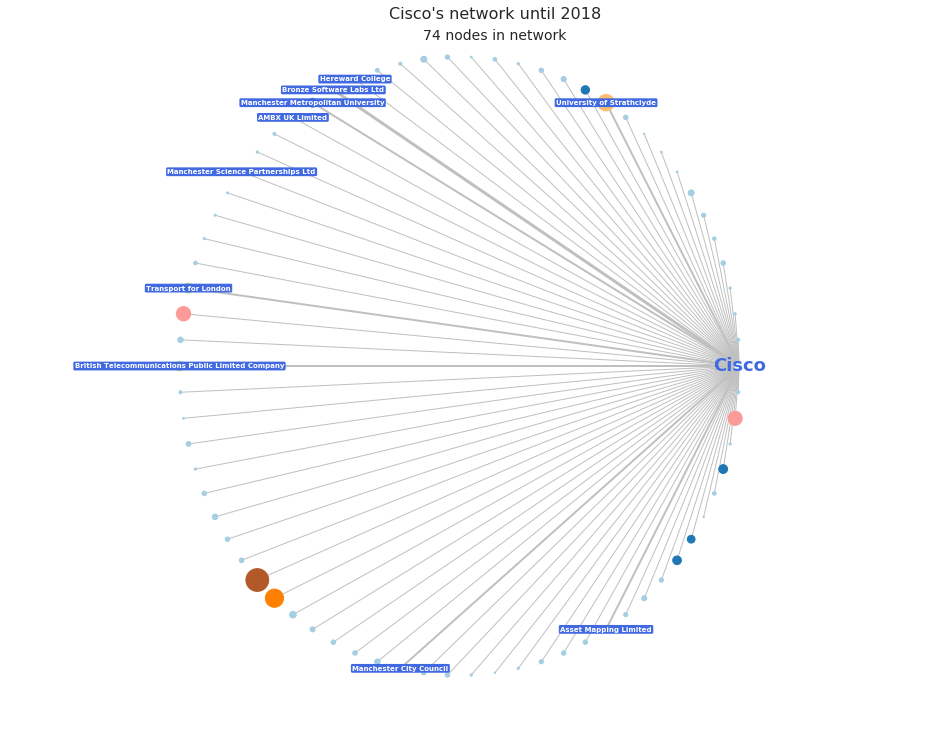

In [159]:
from matplotlib.patches import FancyBboxPatch
        
# Creating visualization
plt.rcParams['figure.constrained_layout.use'] = False
fig = plt.figure(figsize=(15,10))
plt.subplots_adjust(left=0.04, right=0.06)
# fig.set_constrained_layout_pads(w_pad=0.01, h_pad=0)

# sizes for nodes
sizes = [Cisco_network_2018.node[n]['degree'] for n, d in Cisco_network_2018.nodes(data=True) if n != 'Cisco']

# Set node colors according to community   
# node_colors = [partition.get(node) for node in Cisco_network.nodes() if node != 'Cisco']

# Draw the network
nx.draw_networkx_nodes(Cisco_network_2018,
                       pos=pos,
                       node_size = sizes,
                       cmap = 'Paired',
                       nodelist = [n for n, d in Cisco_network_2018.nodes(data=True) if n != 'Cisco'],
                       node_color = sizes,
                       label = "Cisco's network with " + str(len(Cisco_network_2018.nodes(data=True))) + " nodes",
                       alpha = 1)

# Mark specific nodes that are within the top ten
size_top = [Cisco_network_2018.node[n]['degree'] for n, d in Cisco_network_2018.nodes(data=True) if n == 'Cisco']
nx.draw_networkx_nodes(Cisco_network_2018,
                           pos=pos,
                           node_size = size_top,
                           nodelist=[n for n, d in Cisco_network_2018.nodes(data=True) if n == 'Cisco'],
                           node_color = '#F0FFFF',
                           label = "Cisco",
                           alpha = 1)

# Draw the edges
weight = [Cisco_network_2018.edges[u, v]['weight'] for u, v, d in Cisco_network_2018.edges(data=True)]
nx.draw_networkx_edges(Cisco_network_2018,
                       pos=pos,
                       edgelist=Cisco_network_2018.edges(),
                       edge_color = '#C0C0C0',
#                        edge_cmap = 'greys',
                       alpha = 1,
                       width=weight,
                       arrowsize = 0.5)
    
# Labeling Cisco
label_cisco = {'Cisco':'Cisco'}  
nx.draw_networkx_labels(Cisco_network_2018,
                        pos,
                        label_cisco,
                        font_weight='bold',
                        font_size=18,
                        font_color='#4169E1')

#Filtering the top 10 companies with more projects with Cisco for 2018
moreEdges = list(Cisco_networkDF[Cisco_networkDF['Competition_Year']<=2018]['Participant_Name'].value_counts().reset_index(name='Total').rename(columns={'index':'Participant_Name'}).iloc[:10,]['Participant_Name'])

# Creating the labels
label_edges_Cisco = {}    
for node in Cisco_network_2018.nodes():
    if node in moreEdges:
        #set the node name as the key and the label as its value 
        label_edges_Cisco[node] = node

# Labeling companies with more relationships with Cisco        
nx.draw_networkx_labels(Cisco_network_2018,
                        pos,
                        label_edges_Cisco,
                        font_weight='bold',
                        font_size=7,
                        bbox=dict(boxstyle="round", 
                                  facecolor='#4169E1', 
                                  alpha=1,
                                  pad=0.2,
#                                   va='center', ha='center',
                                  edgecolor='none'),
                        font_color='#FFFFFF')

# Describe network
plt.title('Cisco\'s network until 2018', fontsize=16)
plt.suptitle(str(len(Cisco_network_2018.nodes(data=True))) + " nodes in network", y=0.97, fontsize=14)
plt.axis('off')

plt.tight_layout(pad=0, w_pad=0.1)

# Save figure
plt.savefig('content/network_graphs/Cisco/CiscoSpringNetwork2018.png',
            format='png', 
            dpi=600, 
            bbox_inches = "tight",
            pad_inches=0)

# Display plot
plt.show()

Save layout of previous graph:

In [ ]:
# Save layout created
import pickle

pickle.dump(pos, open( "/project/content/pos_Cisco_network_2018.p", "wb" ) )

Prepare dataframe to analyse the evolution of the network:

In [499]:
# Get the information for the networks in both years
NetInformation = {'NetInformation':[nx.info(Cisco_network_2013),
                                    nx.info(Cisco_network_2018)]}

# Convert the dictionary to pandas dataframe 
NetInformation = pd.DataFrame(NetInformation) 
  
# Extract Number of nodes  
NetInformation['Number of nodes'] = NetInformation['NetInformation'].str.extract('(\s\d\d)', expand=True) 
   
# Extract Number of edges
NetInformation['Number of edges'] = NetInformation['NetInformation'].str.extract('(\s\d\d\d)', expand=True) 
  
# Extract Average degree
NetInformation['Average degree'] = NetInformation['NetInformation'].str.extract('(\d+\.\d\d\d\d)', expand=True) 

# Convert values to float
NetInformation = NetInformation.drop(['NetInformation'], axis=1).astype(float)

# Order the graph and drop first row with the dictionary and rename the columns
NetInformation = NetInformation.T.rename(columns={0:'2013', 1:'2018'}).T.reset_index().rename(columns={'index':'Year'})

# Prepare the data for plotting
NetInformation = NetInformation.melt(id_vars='Year', var_name="Network metrics", value_name="Values").rename(columns=str.title)

# Print row
NetInformation

,Year,Network Metrics,Values
0,2013,Number of nodes,23.0000
1,2018,Number of nodes,74.0000
2,2013,Number of edges,113.0000
3,2018,Number of edges,459.0000
4,2013,Average degree,9.8261
5,2018,Average degree,12.4054


Plot evolution and changes in the network:

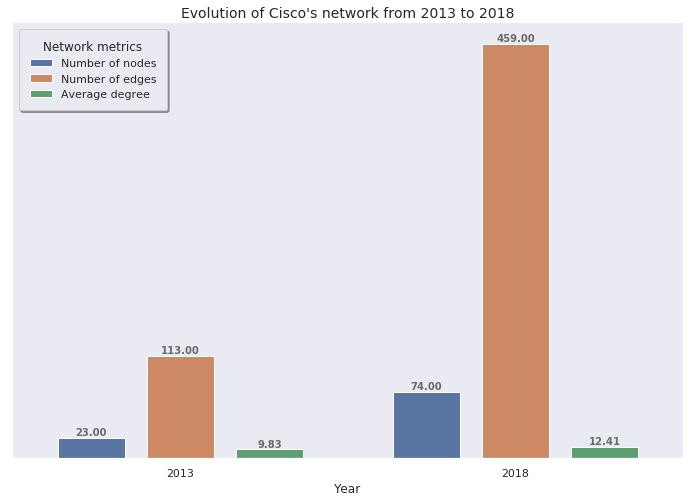

In [501]:
# Creating visualization
plt.rcParams['figure.constrained_layout.use'] = False
_=plt.figure(figsize=(12,8))

# Set style
_=sns.set(style="darkgrid")

# Plot values
ax =sns.barplot(x='Year', y='Values', hue='Network Metrics', data=NetInformation)

# Removing spines
sns.despine(ax=ax, top=True, left=True)

# Set values for each bar
barwidth = [0.2, 0.2, 0.2, 0.2, 0.2, 0.2] # Set width for each bar
label_ = NetInformation.Values
for bar, newwidth, label in zip(ax.patches,barwidth, label_):
    x = bar.get_x()
    width = bar.get_width()
    height = bar.get_height()

    centre = x+width/2.
    bar.set_x(centre-newwidth/2.)
    bar.set_width(newwidth)

    ax.text(x+width/2.,
            height + 3,
            '{0:4.2f}'.format(label),
            fontweight='bold',
            color = 'dimgrey',
            fontsize=10,
            ha="center") 
    
# Descriptions the plot
ax.legend(loc='upper left', title = 'Network metrics',
          borderpad=1,
          ncol=1, 
          fancybox=True, 
          shadow=True)

_=plt.title('Evolution of Cisco\'s network from 2013 to 2018',fontsize=14)

# Turn Y axis off
plt.gca().axes.get_yaxis().set_visible(False)

# Save figure
plt.savefig('content/network_graphs/Cisco/EvolutionCiscoNetwork.png',
            format='png', 
            dpi=500, 
            bbox_inches = "tight",
            pad_inches=0)

# Display plot
plt.show()

# 5. Natural Language Processing

The purpose of these section is to find the main technologies developed by the companies that are part of the co-innovation network community. This means finding what information or ideas are flowing in the co-innovation network, a Cisco's competitor, and Cisco's network of 2013 and 2018.

## 5.1 Topic modelling of projects in co-innovation network

### 5.1.1 Prepare the data

In [28]:
# Load only descriptions of projects
Descriptions_Projects = df[['Public_Description','Project_Number']].copy()

# Remove projects with no descriptions
noDescriptions = ['No abstract available.',
                     'Awaiting Public Project Summary', 
                     'Awaiting Public Summary',
                     'Awaiting Public Description']

Descriptions_Projects = Descriptions_Projects[~Descriptions_Projects.Public_Description.isin(noDescriptions)]

#Remove duplicates Public_Description
Descriptions_Projects.drop_duplicates(subset ="Public_Description", 
                     keep = False, inplace = True) 

Descriptions_Projects.shape

(10725, 2)

After creating the dataframe with all the descriptions of the projects, the next step is to clean text by:
- Removing stopwords
- Convert upercase letters to lowercase
- Remove common words
- Remove rare words
- Lemmatize text

In [422]:
# Load the regular expression library
import re
import nltk
from nltk.corpus import stopwords
nltk.download('wordnet')

# Create function for cleaning the words
def clean_words(df, column):
    
    from tqdm import tqdm

    # For progress bar
    tqdm.pandas()

    # Convert upercase letters to lowercase
    df[column] = df[column].progress_apply(lambda x: x.lower())

    # Remove punctuation
    df[column] = df[column].progress_apply(lambda x: re.sub('[,\.!?]', '', x))

    # Remove stop words
    stop = stopwords.words('english')
    df[column] = df[column].progress_apply(lambda x: " ".join(x for x in x.split() if x not in stop))

    # Remove common words
    commonWords = list(pd.Series(' '.join(df[column]).split()).value_counts()[:4].index)
    df[column] = df[column].progress_apply(lambda x: " ".join(x for x in x.split() if x not in commonWords))

    # Remove rare words
    rareWords = list(pd.Series(' '.join(df[column]).split()).value_counts()[-10:].index)
    df[column] = df[column].progress_apply(lambda x: " ".join(x for x in x.split() if x not in rareWords))

    # Lemmatize text
    w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
    lemmatizer = nltk.stem.WordNetLemmatizer()

    def lemmatize_text(text):
        return [lemmatizer.lemmatize(w,'v') for w in w_tokenizer.tokenize(text)]

    df[column] = df[column].progress_apply(lemmatize_text)

    # Recovert list to strings
    df[column] = df[column].progress_apply(lambda x: ' '.join(x))

[nltk_data] Downloading package wordnet to /home/faculty/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [29]:
# Prepare the words
clean_words(Descriptions_Projects, 'Public_Description')

Descriptions_Projects.head()

[nltk_data] Downloading package wordnet to /home/faculty/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
100%|██████████| 10725/10725 [00:00<00:00, 182389.14it/s]


,Public_Description,Project_Number
1,biliary diseases hard diagnose monitor result ...,105335
2,healthyio test smartphone-based home urine tes...,105336
8,drw develop simple point-of-care (poc) nucleic...,105340
11,purpose assess utility atom 5 direct patient-f...,105343
14,every year nhs spend around £23 billion fall f...,105346


Save dataframe with the processed text of the descripcion of the projects:

In [13]:
import pickle

pickle.dump(Descriptions_Projects, open( "/project/content/Descriptions_Projects.p", "wb" ) )

Load back dataframe:

In [419]:
import pickle

Descriptions_Projects = pickle.load(open("/project/content/Descriptions_Projects.p", "rb"))

### 5.1.2 Exploratory analysis

A wordcloud is created to see the words with more repetition in the network:

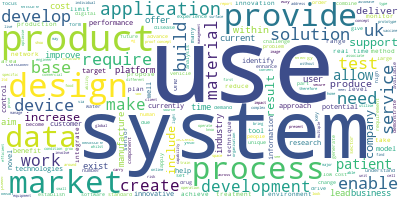

In [210]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(list(Descriptions_Projects['Public_Description'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')# Generate a word cloud
wordcloud.generate(long_string)

# Visualize the word cloud
wordcloud.to_image()

### 5.1.3 Prepare text for LDA Analysis

First, the bag-of-words for the LDA model is created:

In [3]:
# Load the library with the CountVectorizer method
# from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

# Initialise the count vectorizer with the English stop words
tfidf_vectorizer   = TfidfVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True,
                                max_df = 0.5, 
                                min_df = 10)

# Fit and transform Public_Description
dtm_tfidf  = tfidf_vectorizer.fit_transform(Descriptions_Projects['Public_Description'])

Plotting the 10 most common words in the bag of words:

In [477]:
# For plotting commong words
def plot_10_most_common_words(count_data, count_vectorizer, title):
    import matplotlib.pyplot as plt
    words = count_vectorizer.get_feature_names()
    total_counts = np.zeros(len(words))
    for t in count_data:
        total_counts+=t.toarray()[0]
    
    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:10]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words)) 
    
    plt.figure(2, figsize=(15, 15/1.6180))
    plt.subplot(title=title)
    sns.set_context("notebook", font_scale=1.25, rc={"lines.linewidth": 2.5})
    sns.barplot(x_pos, counts, palette='husl')
    
    # Describe plot
    plt.xticks(x_pos, words, rotation=45) 
    plt.xlabel('Words')
    plt.ylabel('Counts')
    
    # To make the graph fit
    plt.tight_layout()
    
    # Save plot
    plt.savefig('content/descriptive_graphs/' + title +'.png', format='png', dpi=400)

    # show
    plt.show()

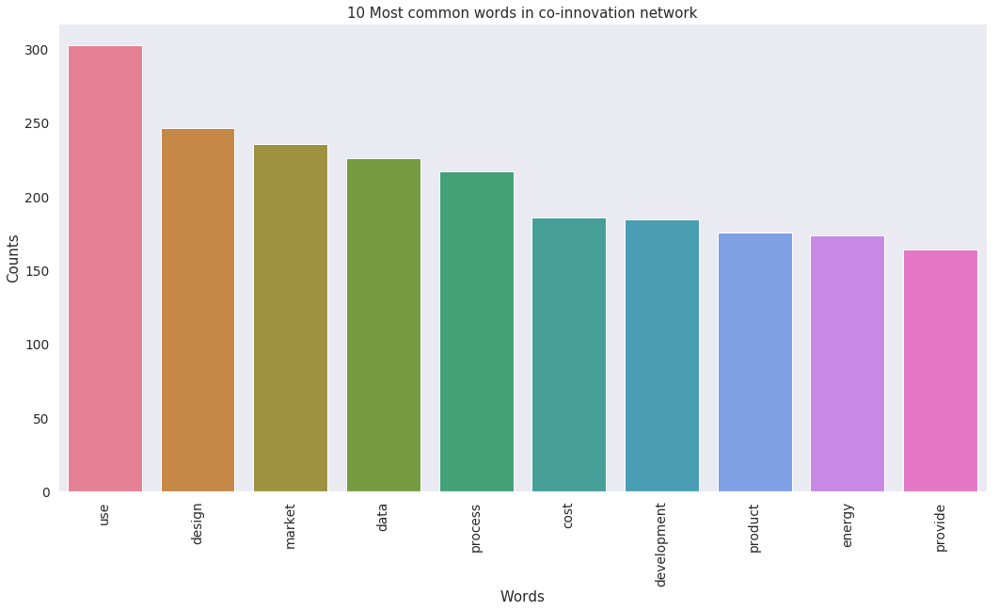

In [214]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('dark')

# Visualise the 10 most common words within Public_Description
plot_10_most_common_words(dtm_tfidf, tfidf_vectorizer, '10 Most common words in co-innovation network')

### 5.1.4 Topic modelling - LDA 

In [165]:
# To print the main topis found
def print_topics(model, count_vectorizer, n_top_words):
    words = count_vectorizer.get_feature_names()
    for topic_idx, topic in enumerate(model.components_):
        print("\nTopic #%d:" % topic_idx)
        print(" ".join([words[i]
                        for i in topic.argsort()[:-n_top_words - 1:-1]]))

In [223]:
def create_topicsDF(model, feature_names, no_top_words):
    topic_dict = {}
    topicsDF = pd.DataFrame()
    
    # Count the number of words in the dtm_tfidf    
    words = feature_names
    
    total_counts = np.zeros(len(words)) 
    
    for t in dtm_tfidf:
        total_counts+=t.toarray()[0]
        
    # Create dictionary with count of words   
    count_dict = dict(zip(words, total_counts))

    for topic_idx, topic in enumerate(model.components_):
        
        # To return the DF created
        topic_dictDF = pd.DataFrame()    
        
       # Get topic number
        topic_dictDF['Topic'] = [topic_idx]*no_top_words
        
        # Get words
        topic_dictDF['Words'] = ['{}'.format(feature_names[i]) 
                                 for i in topic.argsort()[:-no_top_words - 1:-1]]
        
        # Get weight for each word
        topic_dictDF['Weight'] = pd.to_numeric(['{:.1f}'.format(topic[i])
                            for i in topic.argsort()[:-no_top_words - 1:-1]])
        
        # Get the word count for an specific word
        topic_dictDF['Count'] = [count_dict[x] for x in topic_dictDF['Words']]

        topicsDF = topicsDF.append(topic_dictDF)

    return topicsDF

In [224]:
def display_topics(model, feature_names, no_top_words):
    topic_dict = {}
    for topic_idx, topic in enumerate(model.components_):
        topic_dict["Topic %d words" % (topic_idx)]= ['{}'.format(feature_names[i])
                        for i in topic.argsort()[:-no_top_words - 1:-1]]
        topic_dict["Topic %d weights" % (topic_idx)]= ['{:.1f}'.format(topic[i])
                        for i in topic.argsort()[:-no_top_words - 1:-1]]
    return pd.DataFrame(topic_dict)

Fit LDA model to bag of words:

In [346]:
import warnings
from sklearn.decomposition import LatentDirichletAllocation as LDA # Load the LDA model from sk-learn

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Tweak parameters below for number of topics and words per topic
number_topics = 4
number_words = 4

# Create and fit the LDA model
lda = LDA(n_components=number_topics)
lda.fit(dtm_tfidf)

# Print the topics found by the LDA model
print("Topics found via LDA:")
print_topics(lda, tfidf_vectorizer, number_words)

Topics found via LDA:

Topic #0:
energy use design manufacture

Topic #1:
food crop embed product

Topic #2:
cyber drug security patients

Topic #3:
data service use market


Save dataframes, tfidf_vectorizer, and LDA model:

In [420]:
# Save dataframe with words weight and count
import pickle

pickle.dump(topics, open( "/project/content/topics.p", "wb" ) )
pickle.dump(lda, open( "/project/content/lda_coInnovation.p", "wb" ) )
pickle.dump(tfidf_vectorizer, open( "/project/content/tfidf_vectorizer_coInnovation.p", "wb" ) )

Load back dataframes,tfidf_vectorizer, and LDA model:

In [486]:
# Load back the dataframe
import pickle

topics = pickle.load(open("/project/content/topics.p", "rb"))
lda = pickle.load(open("/project/content/lda_coInnovation.p", "rb")) 
tfidf_vectorizer = pickle.load(open("/project/content/tfidf_vectorizer_coInnovation.p", "rb")) 

### 5.1.5 Results of LDA model

Display main words for each topic and their weight:

In [347]:
# tf_feature_names tells us what word each column in the matric represents
tf_feature_names = tfidf_vectorizer.get_feature_names()

# Display main words for each topic and their weight
no_top_words = 5
display_topics(lda, tf_feature_names, no_top_words)

,Topic 0 words,Topic 0 weights,Topic 1 words,Topic 1 weights,Topic 2 words,Topic 2 weights,Topic 3 words,Topic 3 weights
0,energy,151.7,food,63.5,cyber,77.0,data,204.9
1,use,130.9,crop,27.9,drug,69.2,service,140.7
2,design,128.9,embed,27.8,security,68.9,use,125.5
3,manufacture,121.9,product,27.4,patients,54.0,market,115.9
4,process,120.9,products,26.7,cancer,51.3,business,106.3


In [348]:
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns

# tf_feature_names tells us what word each column in the matric represents
tf_feature_names = tfidf_vectorizer.get_feature_names()

# Display main words for each topic and their weight
no_top_words = 5

# Get dataframe wit words and weights per topic
topics = create_topicsDF(lda, tf_feature_names, no_top_words)
topics.head()

,Topic,Words,Weight,Count
0,0,energy,151.7,173.860320
1,0,use,130.9,302.034627
2,0,design,128.9,245.915950
3,0,manufacture,121.9,158.783323
4,0,process,120.9,216.705273


Create visualisation of the main topics and words in each topic:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
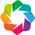

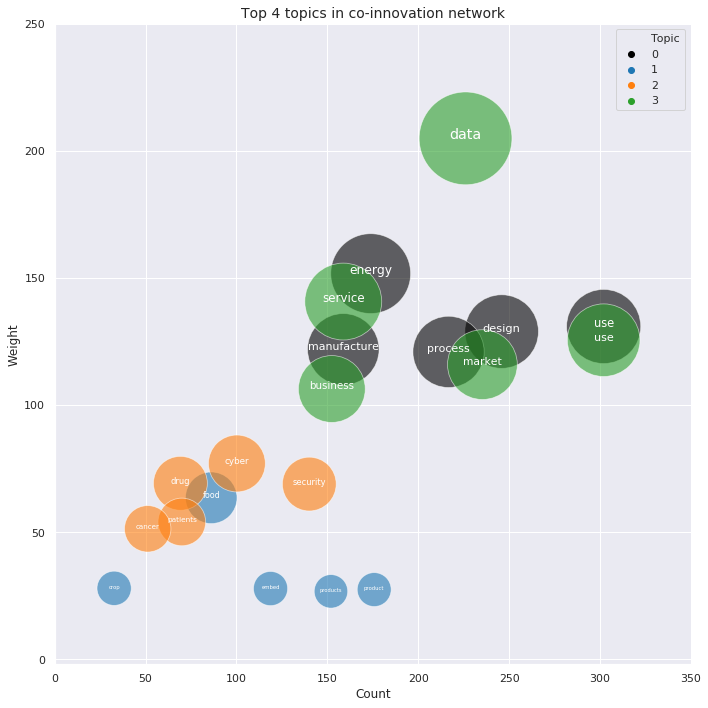

In [487]:
# Define custom color map usd in D3
# Load HoloViews and bokeh
hv.extension('bokeh')

import holoviews as hv
colors_cmap = ['#000000']+hv.Cycle('Category10').values

# Set style
_=sns.set(style="darkgrid")

#Create figure
plt.figure(figsize = (10,10))

# Create scatterplot. alpha controls the opacity and s controls the size.
ax = sns.scatterplot(x = topics.Count, 
                     y = topics.Weight, 
                     alpha = 0.6,
                     s = topics.Weight * 42,
                     legend = 'full',
                     palette = colors_cmap[0:len(set([x for x in topics.Topic]))],
                     hue=topics.Topic)

# Removing spines
sns.despine(ax=ax, top=True, left=False, bottom=False)

# Set x and y limits
ax.set_xlim(0,350)
ax.set_ylim(-2, 250)

# # For each point, we add a text inside the bubble
for line in range(0,topics.shape[0]):
     ax.text(x = topics.Count.iloc[line], 
             y = topics.Weight.iloc[line],
#              s = topics.Weight * 100,
             s = topics.Words.iloc[line], 
             horizontalalignment='center', 
             size=(topics.Weight.iloc[line])**0.50, # Control size of labels
#              size='medium',
             color='white', 
             weight='normal')
        
# Turn Y and X axis off
# plt.gca().axes.get_yaxis().set_visible(False)
# plt.gca().axes.get_xaxis().set_visible(False)

# Descriptions the plot
plt.title('Top 4 topics in co-innovation network',fontsize=14)

# Set the labels with the custom patchList
ax.legend(loc="best",
#            title="Topics",
#            shadow=True,
           fancybox=True)


# To make the graph fit
plt.tight_layout()

# Save plot
plt.savefig('content/descriptive_graphs/Top 4 topics in co-innovation network.png', 
            format='png', 
            dpi=500)

# Display
plt.show()

#### Interactive visualisations of the results of the LDA model:

Because the following visualisations are too heavy for rending the results, they are saved as HTML files and can be viewed in the jupyter notebook named "Interactive_visualisations".

In [20]:
# Create directory to store LDA Html visualisation within directory of content
!mkdir -p content/nlp

In [219]:
import warnings
import pyLDAvis
import pyLDAvis.sklearn

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Enable HTML visualsiation in jupyter
pyLDAvis.enable_notebook()

# Create visualisation
p = pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer)

# Save visualisation
pyLDAvis.save_html(p, '/project/content/nlp/lda_CoInnovationNet.html')

# Display
p

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.010458 -0.119341       1        1  43.527282
1      0.032482  0.045386       2        1  17.162929
0      0.073526 -0.030993       3        1  13.761160
3     -0.181796  0.019438       4        1  13.180997
4      0.065330  0.085511       5        1  12.367633, topic_info=     Category        Freq          Term       Total  loglift  logprob
1788  Default  160.000000        energy  160.000000  30.0000  30.0000
1658  Default   69.000000          drug   69.000000  29.0000  29.0000
3776  Default   96.000000         power   96.000000  28.0000  28.0000
3576  Default   68.000000      patients   68.000000  27.0000  27.0000
5328  Default   98.000000         water   98.000000  26.0000  26.0000
799   Default   51.000000        cancer   51.000000  25.0000  25.0000
967   Default   61.000000      clinical   61.000000  24.0000  24.0000
1568  Default   51.000000       disease   51.000000  23.0000  23.0000
5324  Default   86.000000         waste   86.000000  22.0000  22.0000
3043  Default  146.000000   manufacture  146.000000  21.0000  21.0000
2370  Default   71.000000          heat   71.000000  20.0000  20.0000
3071  Default   86.000000     materials   86.000000  19.0000  19.0000
3867  Default  198.000000       process  198.000000  18.0000  18.0000
5041  Default   72.000000     treatment   72.000000  17.0000  17.0000
2116  Default   80.000000          food   80.000000  16.0000  16.0000
758   Default  124.000000         build  124.000000  15.0000  15.0000
3575  Default   56.000000       patient   56.000000  14.0000  14.0000
1457  Default  225.000000        design  225.000000  13.0000  13.0000
2388  Default  140.000000          high  140.000000  12.0000  12.0000
5384  Default   44.000000          wind   44.000000  11.0000  11.0000
1353  Default   90.000000         cyber   90.000000  10.0000  10.0000
686   Default   33.000000         blood   33.000000   9.0000   9.0000
2214  Default   62.000000           gas   62.000000   8.0000   8.0000
4898  Default  134.000000          test  134.000000   7.0000   7.0000
4411  Default  126.000000      security  126.000000   6.0000   6.0000
3881  Default  139.000000      products  139.000000   5.0000   5.0000
2995  Default   98.000000           low   98.000000   4.0000   4.0000
1368  Default  203.000000          data  203.000000   3.0000   3.0000
1277  Default  171.000000          cost  171.000000   2.0000   2.0000
419   Default   94.000000  applications   94.000000   1.0000   1.0000
...       ...         ...           ...         ...      ...      ...
4027   Topic5   12.141092           ray   16.063915   1.8101  -6.4154
1721   Topic5   19.668444    electrical   28.769442   1.7098  -5.9330
589    Topic5   15.937480       battery   22.816863   1.7313  -6.1433
308    Topic5   14.200184      aircraft   20.203531   1.7375  -6.2587
1720   Topic5   19.558063      electric   30.277876   1.6531  -5.9386
4436   Topic5   24.300530       sensors   40.252211   1.5854  -5.7215
4435   Topic5   26.251509        sensor   45.970285   1.5298  -5.6442
2936   Topic5   27.518889         light   56.897064   1.3637  -5.5971
1793   Topic5   19.524001        engine   36.892685   1.4537  -5.9403
2388   Topic5   42.783526          high  140.012728   0.9045  -5.1558
419    Topic5   33.189029  applications   94.142517   1.0475  -5.4097
2995   Topic5   33.281381           low   98.888052   1.0011  -5.4070
2214   Topic5   25.735702           gas   62.747486   1.1988  -5.6641
2231   Topic5   24.062588    generation   64.028471   1.1114  -5.7313
1457   Topic5   44.968500        design  225.364538   0.4783  -5.1060
1788   Topic5   35.625277        energy  160.959375   0.5820  -5.3389
1277   Topic5   36.007632          cost  171.864856   0.5271  -5.3282
4834   Topic5   29.754946       systems  130.046978   0.6152  -5.5190
1491   Topic5   22.960288       devices   72.238795   0.9439  -5.7782
3611   To

In [22]:
import warnings

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer, mds='tsne')

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=               x           y  topics  cluster       Freq
topic                                                   
3     -12.930627 -134.464706       1        1  39.097127
1     -12.469525  -17.308559       2        1  38.596001
4      67.686401 -102.759537       3        1  12.617605
0      74.308815  -13.125319       4        1   5.333165
2     -78.845963  -73.364128       5        1   4.356102, topic_info=     Category        Freq             Term       Total  loglift  logprob
4411  Default  155.000000         security  155.000000  30.0000  30.0000
1353  Default  121.000000            cyber  121.000000  29.0000  29.0000
1457  Default  225.000000           design  225.000000  28.0000  28.0000
1746  Default  114.000000            embed  114.000000  27.0000  27.0000
772   Default  143.000000         business  143.000000  26.0000  26.0000
3877  Default  163.000000          product  163.000000  25.0000  25.0000
3043  Default  147.000000      manufacture  147.000000  24.0000  24.0000
3881  Default  141.000000         products  141.000000  23.0000  23.0000
3867  Default  200.000000          process  200.000000  22.0000  22.0000
806   Default   86.000000       capability   86.000000  21.0000  21.0000
1368  Default  203.000000             data  203.000000  20.0000  20.0000
1487  Default  170.000000      development  170.000000  19.0000  19.0000
2614  Default   97.000000      information   97.000000  18.0000  18.0000
1658  Default   69.000000             drug   69.000000  17.0000  17.0000
3576  Default   69.000000         patients   69.000000  16.0000  16.0000
2116  Default   82.000000             food   82.000000  15.0000  15.0000
3930  Default   56.000000          protect   56.000000  14.0000  14.0000
2651  Default  132.000000       innovative  132.000000  13.0000  13.0000
4409  Default   62.000000           secure   62.000000  12.0000  12.0000
3071  Default   86.000000        materials   86.000000  11.0000  11.0000
967   Default   62.000000         clinical   62.000000  10.0000  10.0000
2379  Default  116.000000             help  116.000000   9.0000   9.0000
1058  Default  130.000000          company  130.000000   8.0000   8.0000
2314  Default   73.000000             grow   73.000000   7.0000   7.0000
5136  Default   64.000000       university   64.000000   6.0000   6.0000
503   Default   37.000000           attack   37.000000   5.0000   5.0000
3575  Default   58.000000          patient   58.000000   4.0000   4.0000
1967  Default   47.000000         external   47.000000   3.0000   3.0000
799   Default   51.000000           cancer   51.000000   2.0000   2.0000
5301  Default   51.000000          voucher   51.000000   1.0000   1.0000
...       ...         ...              ...         ...      ...      ...
4411   Topic5  115.151477         security  155.957666   2.8303  -3.1222
5305   Topic5    2.840077  vulnerabilities    3.918520   2.8117  -6.8246
5306   Topic5    4.451442    vulnerability    6.370608   2.7751  -6.3752
4932   Topic5   12.837408          threats   18.448839   2.7710  -5.3161
4725   Topic5    6.346706         strongly    9.169207   2.7657  -6.0205
4775   Topic5    4.929135          summary    7.641108   2.6952  -6.2733
3711   Topic5   10.088509             plus   15.920219   2.6774  -5.5571
639    Topic5    2.708626         biocides    4.295104   2.6726  -6.8720
643    Topic5    3.592604          biofilm    5.927750   2.6328  -6.5896
4447   Topic5    2.870725        seriously    4.937741   2.5912  -6.8139
3599   Topic5   10.387375      penetration   18.017543   2.5828  -5.5279
3930   Topic5   30.828904          protect   56.334187   2.5307  -4.4400
1122   Topic5   19.934173          concern   35.957326   2.5437  -4.8760
486    Topic5   16.363201       assistance   34.609227   2.3845  -5.0734
1967   Topic5   18.592854         external   47.140821   2.2032  -4.9457
609    Topic5   14.291613          believe   34.836816   2.2426  -5.2088
5301   Topic5   17.470822          voucher   51.705475

In [23]:
import warnings

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer, mds='mmds')

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.020266  0.110513       1        1  39.097127
1     -0.027958 -0.065472       2        1  38.596001
4     -0.210032 -0.018688       3        1  12.617605
0      0.088711 -0.115272       4        1   5.333165
2      0.169545  0.088919       5        1   4.356102, topic_info=     Category        Freq             Term       Total  loglift  logprob
4411  Default  155.000000         security  155.000000  30.0000  30.0000
1353  Default  121.000000            cyber  121.000000  29.0000  29.0000
1457  Default  225.000000           design  225.000000  28.0000  28.0000
1746  Default  114.000000            embed  114.000000  27.0000  27.0000
772   Default  143.000000         business  143.000000  26.0000  26.0000
3877  Default  163.000000          product  163.000000  25.0000  25.0000
3043  Default  147.000000      manufacture  147.000000  24.0000  24.0000
3881  Default  141.000000         products  141.000000  23.0000  23.0000
3867  Default  200.000000          process  200.000000  22.0000  22.0000
806   Default   86.000000       capability   86.000000  21.0000  21.0000
1368  Default  203.000000             data  203.000000  20.0000  20.0000
1487  Default  170.000000      development  170.000000  19.0000  19.0000
2614  Default   97.000000      information   97.000000  18.0000  18.0000
1658  Default   69.000000             drug   69.000000  17.0000  17.0000
3576  Default   69.000000         patients   69.000000  16.0000  16.0000
2116  Default   82.000000             food   82.000000  15.0000  15.0000
3930  Default   56.000000          protect   56.000000  14.0000  14.0000
2651  Default  132.000000       innovative  132.000000  13.0000  13.0000
4409  Default   62.000000           secure   62.000000  12.0000  12.0000
3071  Default   86.000000        materials   86.000000  11.0000  11.0000
967   Default   62.000000         clinical   62.000000  10.0000  10.0000
2379  Default  116.000000             help  116.000000   9.0000   9.0000
1058  Default  130.000000          company  130.000000   8.0000   8.0000
2314  Default   73.000000             grow   73.000000   7.0000   7.0000
5136  Default   64.000000       university   64.000000   6.0000   6.0000
503   Default   37.000000           attack   37.000000   5.0000   5.0000
3575  Default   58.000000          patient   58.000000   4.0000   4.0000
1967  Default   47.000000         external   47.000000   3.0000   3.0000
799   Default   51.000000           cancer   51.000000   2.0000   2.0000
5301  Default   51.000000          voucher   51.000000   1.0000   1.0000
...       ...         ...              ...         ...      ...      ...
4411   Topic5  115.151477         security  155.957666   2.8303  -3.1222
5305   Topic5    2.840077  vulnerabilities    3.918520   2.8117  -6.8246
5306   Topic5    4.451442    vulnerability    6.370608   2.7751  -6.3752
4932   Topic5   12.837408          threats   18.448839   2.7710  -5.3161
4725   Topic5    6.346706         strongly    9.169207   2.7657  -6.0205
4775   Topic5    4.929135          summary    7.641108   2.6952  -6.2733
3711   Topic5   10.088509             plus   15.920219   2.6774  -5.5571
639    Topic5    2.708626         biocides    4.295104   2.6726  -6.8720
643    Topic5    3.592604          biofilm    5.927750   2.6328  -6.5896
4447   Topic5    2.870725        seriously    4.937741   2.5912  -6.8139
3599   Topic5   10.387375      penetration   18.017543   2.5828  -5.5279
3930   Topic5   30.828904          protect   56.334187   2.5307  -4.4400
1122   Topic5   19.934173          concern   35.957326   2.5437  -4.8760
486    Topic5   16.363201       assistance   34.609227   2.3845  -5.0734
1967   Topic5   18.592854         external   47.140821   2.2032  -4.9457
609    Topic5   14.291613          believe   34.836816   2.2426  -5.2088
5301   Topic5   17.470822          voucher   51.705475   2.0486  -5.0079
42

## 5.2  Looking into a Cisco's competitor: Microsoft

Topic modelling is also applied to a Microsoft, Cisco's competitor, with the purpose of looking at the type of projects being pursued by these companies and the type of technologies and knowledge gained by them.

### 5.2.1 Prepare the data

The function created in section 5.1.1 is used here for the cleaning of the text:

In [423]:
Microsoft_Projects = df[df["Participant_Name"].str.contains(r'Microsoft')]

# Remove projects with no descriptions
noDescriptions = ['No abstract available.',
                     'Awaiting Public Project Summary', 
                     'Awaiting Public Summary',
                     'Awaiting Public Description']

Microsoft_Projects = Microsoft_Projects[~Microsoft_Projects.Public_Description.isin(noDescriptions)]

#Remove duplicates Public_Description
Microsoft_Projects.drop_duplicates(subset ="Public_Description", 
                     keep = False, inplace = True) 

# Clean the descriptions
clean_words(Microsoft_Projects, 'Public_Description')


Microsoft_Projects.shape

100%|██████████| 5/5 [00:00<00:00, 9169.88it/s]


(5, 11)

### 5.2.2 Exploratory analysis

Words more repeated in descriptions of projects:

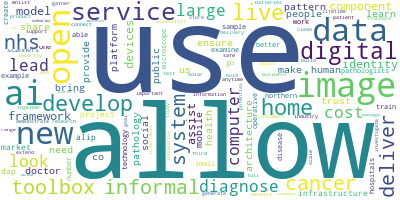

In [223]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(list(Microsoft_Projects['Public_Description'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')# Generate a word cloud
wordcloud.generate(long_string)

# Visualize the word cloud
wordcloud.to_image()

### 5.2.3 Fit LDA model

In [446]:
# Load the library with the CountVectorizer method
# from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA # Load the LDA model from sk-learn
import warnings

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Initialise the count vectorizer with the English stop words
tfidf_vectorizer = TfidfVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True)

# Fit and transform Public_Description
dtm_tfidf  = tfidf_vectorizer.fit_transform(Microsoft_Projects['Public_Description'])

# Tweak parameters below for number of topics and words per topic
number_topics = 4
number_words = 4

# Create and fit the LDA model
lda = LDA(n_components=number_topics)
lda.fit(dtm_tfidf)

# Print the topics found by the LDA model
print("Topics found via LDA:")
print_topics(lda, tfidf_vectorizer, number_words)

Topics found via LDA:

Topic #0:
service toolbox scenarios delivery

Topic #1:
allow develop mobile open

Topic #2:
ai identity use deliver

Topic #3:
home alip market dap


### 5.2.4 Results of LDA model

In [447]:
# tf_feature_names tells us what word each column in the matric represents
tf_feature_names = tfidf_vectorizer.get_feature_names()

# Display main words for each topic and their weight
no_top_words = 4
display_topics(lda, tf_feature_names, no_top_words)

,Topic 0 words,Topic 0 weights,Topic 1 words,Topic 1 weights,Topic 2 words,Topic 2 weights,Topic 3 words,Topic 3 weights
0,service,0.6,allow,0.3,ai,0.7,home,0.6
1,toolbox,0.5,develop,0.3,identity,0.6,alip,0.5
2,scenarios,0.5,mobile,0.3,use,0.6,market,0.5
3,delivery,0.5,open,0.3,deliver,0.6,dap,0.5


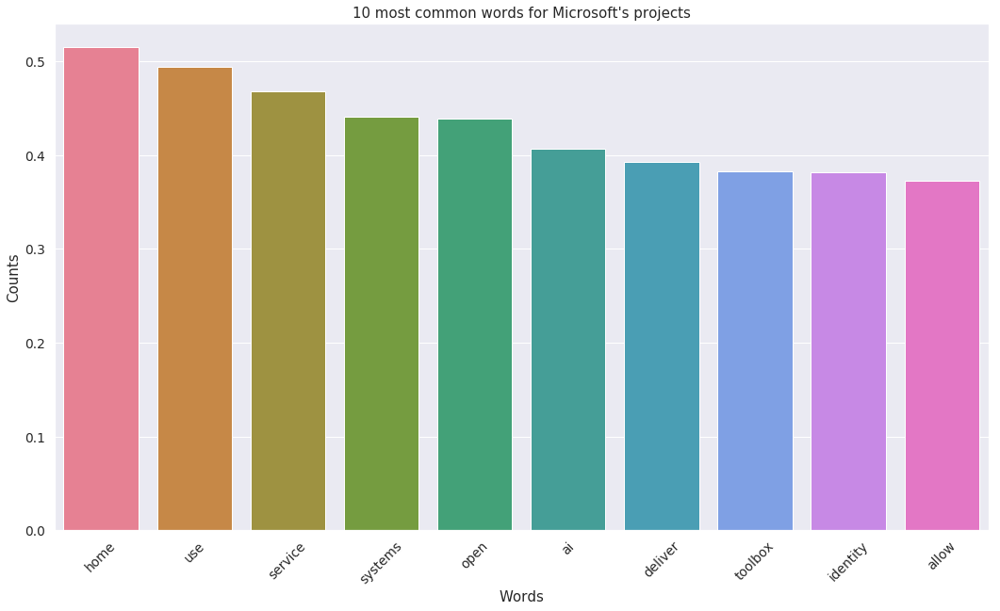

In [478]:
# Visualise the 10 most common words within Public_Description
plot_10_most_common_words(dtm_tfidf, tfidf_vectorizer, '10 most common words for Microsoft\'s projects')

#### Interactive visualisations of the results of the LDA model:

The following interactive visualisations can be viewed in the jupyter notebook named "Interactive_visualisations".

In [251]:
import warnings
import pyLDAvis
import pyLDAvis.sklearn

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Enable HTML visualsiation in jupyter
pyLDAvis.enable_notebook()

# Create visualisation
p = pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer)

# Save visualisation
pyLDAvis.save_html(p, '/project/content/nlp/lda_Mictosoft.html')

# Display
p

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.010004  0.002863       1        1  40.737549
0     -0.010237  0.003008       2        1  35.070069
3     -0.000252 -0.007242       3        1  19.667903
2      0.000243  0.000686       4        1   2.262239
4      0.000243  0.000686       5        1   2.262239, topic_info=    Category      Freq            Term     Total  loglift  logprob
270  Default  0.000000         service  0.000000  30.0000  30.0000
139  Default  0.000000        identity  0.000000  29.0000  29.0000
297  Default  0.000000         toolbox  0.000000  28.0000  28.0000
259  Default  0.000000       scenarios  0.000000  27.0000  27.0000
86   Default  0.000000        delivery  0.000000  26.0000  26.0000
112  Default  0.000000          extend  0.000000  25.0000  25.0000
133  Default  0.000000            home  0.000000  24.0000  24.0000
140  Default  0.000000           image  0.000000  23.0000  23.0000
11   Default  0.000000              ai  0.000000  22.0000  22.0000
85   Default  0.000000         deliver  0.000000  21.0000  21.0000
63   Default  0.000000      components  0.000000  20.0000  20.0000
217  Default  0.000000        platform  0.000000  19.0000  19.0000
246  Default  0.000000        research  0.000000  18.0000  18.0000
278  Default  0.000000           solar  0.000000  17.0000  17.0000
166  Default  0.000000        lifetime  0.000000  16.0000  16.0000
81   Default  0.000000       customers  0.000000  15.0000  15.0000
33   Default  0.000000       batteries  0.000000  14.0000  14.0000
51   Default  0.000000           clean  0.000000  13.0000  13.0000
191  Default  0.000000             nhs  0.000000  12.0000  12.0000
46   Default  0.000000          cancer  0.000000  11.0000  11.0000
14   Default  0.000000            alip  0.000000  10.0000  10.0000
178  Default  0.000000          market  0.000000   9.0000   9.0000
82   Default  0.000000             dap  0.000000   8.0000   8.0000
308  Default  0.000000             use  0.000000   7.0000   7.0000
6    Default  0.000000          access  0.000000   6.0000   6.0000
21   Default  0.000000    architecture  0.000000   5.0000   5.0000
47   Default  0.000000          carers  0.000000   4.0000   4.0000
132  Default  0.000000            hold  0.000000   3.0000   3.0000
266  Default  0.000000        security  0.000000   2.0000   2.0000
56   Default  0.000000     combination  0.000000   1.0000   1.0000
..       ...       ...             ...       ...      ...      ...
137   Topic5  0.002795           human  0.127501  -0.0316  -5.7651
277   Topic5  0.002795          social  0.131664  -0.0637  -5.7651
89    Topic5  0.002795         develop  0.142133  -0.1402  -5.7651
190   Topic5  0.002795             new  0.154782  -0.2255  -5.7651
91    Topic5  0.002795         devices  0.142943  -0.1459  -5.7651
76    Topic5  0.002795            cost  0.141508  -0.1358  -5.7651
16    Topic5  0.002795           allow  0.160736  -0.2632  -5.7651
170   Topic5  0.002795            live  0.155303  -0.2289  -5.7651
145   Topic5  0.002795        informal  0.154224  -0.2219  -5.7651
198   Topic5  0.002795            open  0.172403  -0.3333  -5.7651
188   Topic5  0.002795            need  0.131069  -0.0592  -5.7651
163   Topic5  0.002795           learn  0.132711  -0.0717  -5.7651
105   Topic5  0.002795          ensure  0.132711  -0.0717  -5.7651
293   Topic5  0.002795      technology  0.123428   0.0008  -5.7651
172   Topic5  0.002794            look  0.138711  -0.1159  -5.7651
252   Topic5  0.002794            safe  0.125070  -0.0124  -5.7651
5     Topic5  0.002794            able  0.125070  -0.0124  -5.7651
234   Topic5  0.002794          public  0.130326  -0.0536  -5.7651
162   Topic5  0.002794            lead  0.140353  -0.1277  -5.7651
146   Topic5  0.002794     information  0.125048  -0.0122  -5.7651
147   Topic5  0.002794  infrastructure  0.125048  -0.0122  -5.7651
43    Topic5  0.002794      

## 5.3 Cisco

This section examines the evolution in the exchange of information in Cisco's network of 2013 and 2018.

### 5.3.1 Cisco's network until 2013

#### 5.3.1.1 Projects for Cisco until 2013

Get the descriptions of all of Cisco's projects until 2013 and clean the text with function created in section 5.1.1.

In [479]:
Cisco_Projects_2013 = df[(df["Participant_Name"].str.contains(r'Cisco')) & (df['Competition_Year']<=2013)]

# Remove projects with no descriptions
noDescriptions = ['No abstract available.',
                     'Awaiting Public Project Summary', 
                     'Awaiting Public Summary',
                     'Awaiting Public Description']

Cisco_Projects_2013 = Cisco_Projects_2013[~Cisco_Projects_2013.Public_Description.isin(noDescriptions)]

#Remove duplicates from Public_Description
Cisco_Projects_2013.drop_duplicates(subset ="Public_Description", 
                     keep = False, inplace = True) 

# Clean the descriptions
clean_words(Cisco_Projects_2013, 'Public_Description')


Cisco_Projects_2013.shape

100%|██████████| 3/3 [00:00<00:00, 7025.63it/s]


(3, 11)

#### 5.3.1.2 Exploratory analysis

Most repeated words in descriptions of projects.

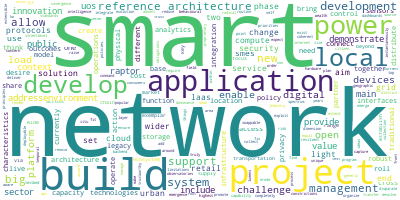

In [239]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(list(Cisco_Projects_2013['Public_Description'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')# Generate a word cloud
wordcloud.generate(long_string)

# Visualize the word cloud
wordcloud.to_image()

#### 5.3.1.3 Fit LDA model

In [481]:
# Load the library with the CountVectorizer method
# from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA # Load the LDA model from sk-learn
import warnings

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Initialise the count vectorizer with the English stop words
tfidf_vectorizer = TfidfVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True)

# Fit and transform Public_Description
dtm_tfidf  = tfidf_vectorizer.fit_transform(Cisco_Projects_2013['Public_Description'])

# Tweak parameters below for number of topics and words per topic
number_topics = 3
number_words = 10

# Create and fit the LDA model
lda = LDA(n_components=number_topics)
lda.fit(dtm_tfidf)

# Print the topics found by the LDA model
print("Topics found via LDA:")
print_topics(lda, tfidf_vectorizer, number_words)

Topics found via LDA:

Topic #0:
power network architecture reference smart load new big management local

Topic #1:
raptor environment platform development uos support allow urban sectors smes

Topic #2:
digital smart new address project build develop open devices innovation


#### 5.3.1.4 Results of LDA model

In [443]:
# tf_feature_names tells us what word each column in the matric represents
tf_feature_names = tfidf_vectorizer.get_feature_names()

# Display main words for each topic and their weight
no_top_words = 10
display_topics(lda, tf_feature_names, no_top_words)

,Topic 0 words,Topic 0 weights,Topic 1 words,Topic 1 weights,Topic 2 words,Topic 2 weights
0,power,0.9,architecture,0.7,environment,0.6
1,load,0.6,reference,0.6,raptor,0.6
2,new,0.6,local,0.6,platform,0.6
3,network,0.6,big,0.5,development,0.6
4,smart,0.6,management,0.5,uos,0.5
5,laas,0.5,network,0.5,support,0.5
6,protocols,0.5,security,0.5,allow,0.5
7,policy,0.5,compute,0.5,retail,0.5
8,grids,0.5,aim,0.5,sectors,0.5
9,light,0.4,phase,0.5,urban,0.5


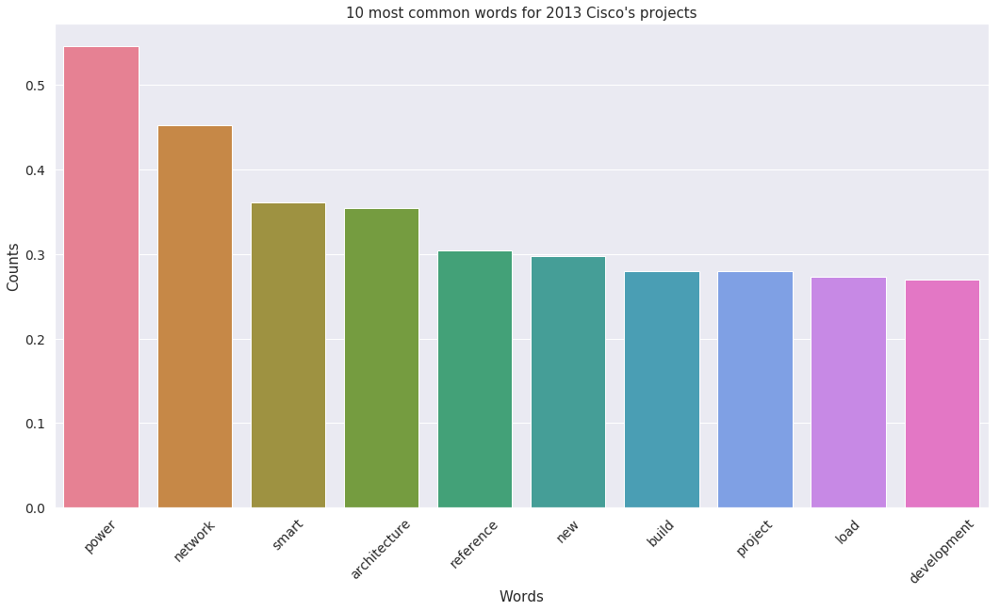

In [482]:
# Visualise the 10 most common words within Public_Description
plot_10_most_common_words(dtm_tfidf, tfidf_vectorizer, '10 most common words for 2013 Cisco\'s projects')

##### Interactive visualisations of the results of the LDA model:

The following interactive visualisations can be viewed in the jupyter notebook named "Interactive_visualisations".

In [253]:
import warnings
import pyLDAvis
import pyLDAvis.sklearn

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Enable HTML visualsiation in jupyter
pyLDAvis.enable_notebook()

# Create visualisation
p = pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer)

# Save visualisation
pyLDAvis.save_html(p, '/project/content/nlp/lda_Cisco2013.html')

# Display
p

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x    y  topics  cluster       Freq
topic                                           
1      0.001664 -0.0       1        1  93.021241
2     -0.000832 -0.0       2        1   3.489380
0     -0.000832 -0.0       3        1   3.489379, topic_info=    Category      Freq          Term     Total  loglift  logprob
231  Default  0.000000         power  0.000000  30.0000  30.0000
193  Default  0.000000       network  0.000000  29.0000  29.0000
287  Default  0.000000         smart  0.000000  28.0000  28.0000
17   Default  0.000000  architecture  0.000000  27.0000  27.0000
253  Default  0.000000     reference  0.000000  26.0000  26.0000
194  Default  0.000000           new  0.000000  25.0000  25.0000
28   Default  0.000000         build  0.000000  24.0000  24.0000
237  Default  0.000000       project  0.000000  23.0000  23.0000
174  Default  0.000000          load  0.000000  22.0000  22.0000
86   Default  0.000000   development  0.000000  21.0000  21.0000
176  Default  0.000000         local  0.000000  20.0000  20.0000
224  Default  0.000000      platform  0.000000  19.0000  19.0000
109  Default  0.000000   environment  0.000000  18.0000  18.0000
26   Default  0.000000           big  0.000000  17.0000  17.0000
184  Default  0.000000    management  0.000000  16.0000  16.0000
300  Default  0.000000       support  0.000000  15.0000  15.0000
10   Default  0.000000         allow  0.000000  14.0000  14.0000
90   Default  0.000000       digital  0.000000  13.0000  13.0000
84   Default  0.000000       develop  0.000000  12.0000  12.0000
250  Default  0.000000        raptor  0.000000  11.0000  11.0000
325  Default  0.000000           uos  0.000000  10.0000  10.0000
240  Default  0.000000     protocols  0.000000   9.0000   9.0000
166  Default  0.000000          laas  0.000000   8.0000   8.0000
14   Default  0.000000  applications  0.000000   7.0000   7.0000
35   Default  0.000000     challenge  0.000000   6.0000   6.0000
6    Default  0.000000       address  0.000000   5.0000   5.0000
78   Default  0.000000   demonstrate  0.000000   4.0000   4.0000
244  Default  0.000000        public  0.000000   3.0000   3.0000
87   Default  0.000000       devices  0.000000   2.0000   2.0000
202  Default  0.000000          open  0.000000   1.0000   1.0000
..       ...       ...           ...       ...      ...      ...
307   Topic3  0.002949          test  0.081372   0.0379  -5.8198
171   Topic3  0.002949   limitations  0.081372   0.0379  -5.8198
309   Topic3  0.002949        things  0.081372   0.0379  -5.8198
183   Topic3  0.002949        manage  0.081372   0.0379  -5.8198
174   Topic3  0.002951          load  0.119826  -0.3486  -5.8192
240   Topic3  0.002950     protocols  0.106991  -0.2354  -5.8193
166   Topic3  0.002950          laas  0.106991  -0.2354  -5.8193
231   Topic3  0.002950         power  0.171190  -0.7054  -5.8193
194   Topic3  0.002950           new  0.124672  -0.3883  -5.8193
145   Topic3  0.002950         grids  0.094166  -0.1078  -5.8194
228   Topic3  0.002950        policy  0.094166  -0.1078  -5.8194
287   Topic3  0.002950         smart  0.136619  -0.4800  -5.8194
193   Topic3  0.002950       network  0.153314  -0.5953  -5.8195
170   Topic3  0.002950         light  0.095230  -0.1192  -5.8195
6     Topic3  0.002950       address  0.102775  -0.1954  -5.8195
244   Topic3  0.002950        public  0.102429  -0.1921  -5.8195
78    Topic3  0.002950   demonstrate  0.102429  -0.1921  -5.8195
90    Topic3  0.002950       digital  0.110148  -0.2647  -5.8195
202   Topic3  0.002949          open  0.100717  -0.1753  -5.8196
87    Topic3  0.002949       devices  0.100717  -0.1753  -5.8196
102   Topic3  0.002949        enable  0.100582  -0.1739  -5.8196
154   Topic3  0.002949    innovation  0.100400  -0.1722  -5.8197
26    Topic3  0.002949           big  0.114278  -0.3017  -5.8197
184   Topic3  0.002949    management  0.114278  -0.3017  -5.8197
84    Topic3  0.002949       develop  0.110051  -0.2640  -5.8197
104   T

### 5.3.2 Cisco's network until 2018

#### 5.3.2.1 Projects for Cisco until 2018

Get the descriptions of all of Cisco's projects until 2018 and clean the text with function created in section 5.1.1.

In [483]:
Cisco_Projects_2018 = df[(df["Participant_Name"].str.contains(r'Cisco')) & (df['Competition_Year']<=2018)]

# Remove projects with no descriptions
noDescriptions = ['No abstract available.',
                     'Awaiting Public Project Summary', 
                     'Awaiting Public Summary',
                     'Awaiting Public Description']

Cisco_Projects_2018 = Cisco_Projects_2018[~Cisco_Projects_2018.Public_Description.isin(noDescriptions)]

#Remove duplicates Public_Description
Cisco_Projects_2018.drop_duplicates(subset ="Public_Description", 
                     keep = False, inplace = True) 

# Prepare the descriptions for the topic modelling
clean_words(Cisco_Projects_2018, 'Public_Description')


Cisco_Projects_2018.shape

100%|██████████| 13/13 [00:00<00:00, 26741.52it/s]


(13, 11)

#### 5.3.2.2 Exploratory analysis

Most repeated words in descriptions of projects.

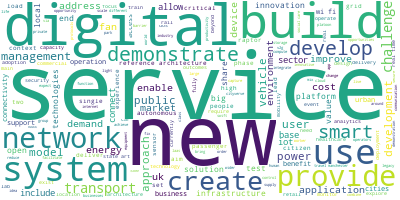

In [244]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(list(Cisco_Projects_2018['Public_Description'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')# Generate a word cloud
wordcloud.generate(long_string)

# Visualize the word cloud
wordcloud.to_image()

#### 5.3.2.3 Fit LDA model

In [484]:
# Load the library with the CountVectorizer method
# from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA # Load the LDA model from sk-learn
import warnings

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Initialise the count vectorizer with the English stop words
tfidf_vectorizer = TfidfVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True)

# Fit and transform Public_Description
dtm_tfidf  = tfidf_vectorizer.fit_transform(Cisco_Projects_2018['Public_Description'])

# Tweak parameters below for number of topics and words per topic
number_topics = 3
number_words = 10

# Create and fit the LDA model
lda = LDA(n_components=number_topics)
lda.fit(dtm_tfidf)

# Print the topics found by the LDA model
print("Topics found via LDA:")
print_topics(lda, tfidf_vectorizer, number_words)

Topics found via LDA:

Topic #0:
demand transport explore test world achieve event flood multi workflow

Topic #1:
energy market cityverve healthcare provide human equipment raptor v2g vehicle

Topic #2:
iot power digital fan architecture network public smart develop technologies


#### 5.3.2.4 Results of LDA model

In [255]:
# tf_feature_names tells us what word each column in the matric represents
tf_feature_names = tfidf_vectorizer.get_feature_names()

# Display main words for each topic and their weight
no_top_words = 10
display_topics(lda, tf_feature_names, no_top_words)

,Topic 0 words,Topic 0 weights,Topic 1 words,Topic 1 weights,Topic 2 words,Topic 2 weights
0,fan,0.8,iot,0.9,digital,0.9
1,cityverve,0.7,explore,0.7,demand,0.9
2,wi,0.7,test,0.7,power,0.9
3,fi,0.7,raptor,0.6,service,0.8
4,train,0.6,class,0.6,public,0.8
5,rail,0.6,development,0.6,new,0.7
6,healthcare,0.6,devices,0.6,network,0.7
7,architecture,0.6,approach,0.6,users,0.7
8,reference,0.6,develop,0.6,vehicles,0.7
9,provide,0.6,single,0.6,market,0.7


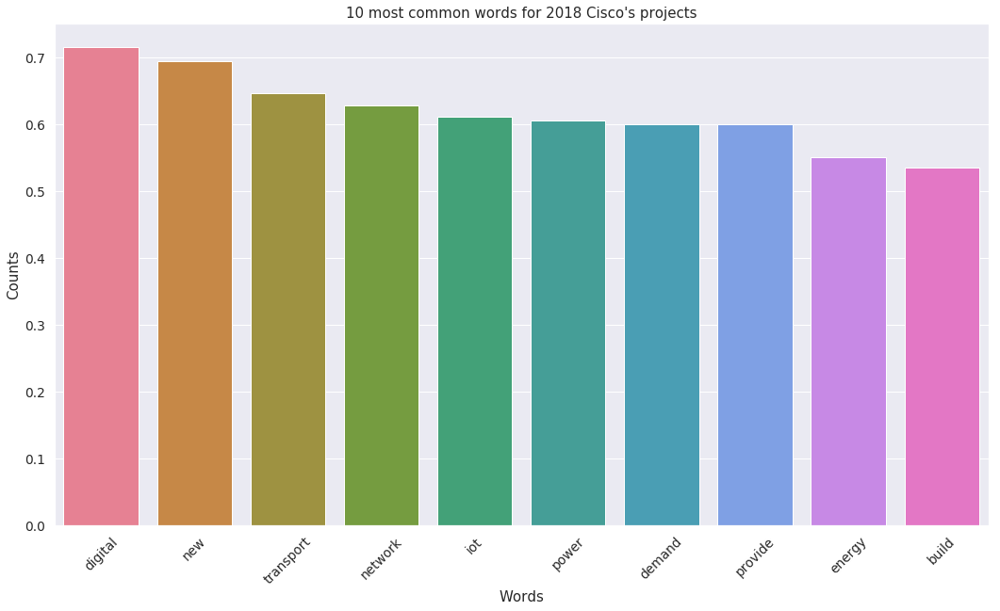

In [485]:
# Visualise the 10 most common words within Public_Description
plot_10_most_common_words(dtm_tfidf, tfidf_vectorizer, '10 most common words for 2018 Cisco\'s projects')

##### Interactive visualisations of the results of the LDA model:

The following interactive visualisations can be viewed in the jupyter notebook named "Interactive_visualisations".

In [256]:
import warnings
import pyLDAvis
import pyLDAvis.sklearn

# Ignore warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Enable HTML visualsiation in jupyter
pyLDAvis.enable_notebook()

# Create visualisation
p = pyLDAvis.sklearn.prepare(lda, dtm_tfidf, tfidf_vectorizer)

# Save visualisation
pyLDAvis.save_html(p, '/project/content/nlp/lda_Cisco2018.html')

# Display
p

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.005183 -0.000116       1        1  50.521485
1     -0.002760 -0.002612       2        1  25.290802
0     -0.002423  0.002728       3        1  24.187713, topic_info=    Category      Freq           Term     Total  loglift  logprob
369  Default  0.000000            iot  0.000000  30.0000  30.0000
273  Default  0.000000            fan  0.000000  29.0000  29.0000
264  Default  0.000000        explore  0.000000  28.0000  28.0000
107  Default  0.000000      cityverve  0.000000  27.0000  27.0000
42   Default  0.000000   architecture  0.000000  26.0000  26.0000
687  Default  0.000000          train  0.000000  25.0000  25.0000
547  Default  0.000000           rail  0.000000  24.0000  24.0000
559  Default  0.000000      reference  0.000000  23.0000  23.0000
275  Default  0.000000             fi  0.000000  22.0000  22.0000
742  Default  0.000000             wi  0.000000  21.0000  21.0000
461  Default  0.000000  opportunities  0.000000  20.0000  20.0000
552  Default  0.000000         raptor  0.000000  19.0000  19.0000
322  Default  0.000000     healthcare  0.000000  18.0000  18.0000
108  Default  0.000000          class  0.000000  17.0000  17.0000
699  Default  0.000000             uk  0.000000  16.0000  16.0000
397  Default  0.000000          local  0.000000  15.0000  15.0000
309  Default  0.000000        greater  0.000000  14.0000  14.0000
662  Default  0.000000          swift  0.000000  13.0000  13.0000
191  Default  0.000000    development  0.000000  12.0000  12.0000
675  Default  0.000000           test  0.000000  11.0000  11.0000
606  Default  0.000000         sector  0.000000  10.0000  10.0000
708  Default  0.000000            uos  0.000000   9.0000   9.0000
66   Default  0.000000            big  0.000000   8.0000   8.0000
626  Default  0.000000         single  0.000000   7.0000   7.0000
287  Default  0.000000          focus  0.000000   6.0000   6.0000
619  Default  0.000000            set  0.000000   5.0000   5.0000
360  Default  0.000000    interaction  0.000000   4.0000   4.0000
38   Default  0.000000   applications  0.000000   3.0000   3.0000
483  Default  0.000000         people  0.000000   2.0000   2.0000
193  Default  0.000000        devices  0.000000   1.0000   1.0000
..       ...       ...            ...       ...      ...      ...
129   Topic3  0.044286        compute  0.135210   0.3032  -6.3659
415   Topic3  0.050111     manchester  0.155460   0.2872  -6.2424
711   Topic3  0.042078         urgent  0.133024   0.2683  -6.4171
3     Topic3  0.042078        ability  0.133024   0.2683  -6.4171
220   Topic3  0.042078      efficient  0.133024   0.2683  -6.4171
321   Topic3  0.042078         health  0.133024   0.2683  -6.4171
251   Topic3  0.042078       everyday  0.133024   0.2683  -6.4171
22    Topic3  0.042078         agenda  0.133024   0.2683  -6.4171
447   Topic3  0.042078         object  0.133024   0.2683  -6.4171
562   Topic3  0.042078         region  0.133024   0.2683  -6.4171
194   Topic3  0.042078     devolution  0.133024   0.2683  -6.4171
304   Topic3  0.042078         global  0.133024   0.2683  -6.4171
219   Topic3  0.042078      effective  0.133024   0.2683  -6.4171
699   Topic3  0.054638             uk  0.173361   0.2647  -6.1559
262   Topic3  0.047952     experience  0.152079   0.2651  -6.2864
734   Topic3  0.042078            way  0.133024   0.2683  -6.4171
475   Topic3  0.042078     particular  0.133024   0.2683  -6.4171
67    Topic3  0.042078      blueprint  0.133024   0.2683  -6.4171
303   Topic3  0.042078   geographical  0.133024   0.2683  -6.4171
735   Topic3  0.042078           ways  0.133024   0.2683  -6.4171
665   Topic3  0.047854        systems  0.153938   0.2509  -6.2884
414   Topic3  0.054251     management  0.183907   0.1985  -6.1630
535   Topic3  0.056911        provide  0.197150   0.1769  -6.1151
176   Topic3  0.045430        deliver  0.149321   0.2294 

# 6. Conclusions

This jupyter noteebok as well as the notebook named "Interactive_Visualisation" accompany the dissertation for the MSc Business Analytics (with specialisation in management science). So, all the conclusions about the network analysis and topic modelling carry in this jupyter nootebook fit a cohesive narrative in the dissertation document submitted alongside this jupyter notebook.

### Save current session

The library dill facilitates to save the session or all the information loaded in memory (dataframes, models, etc.).

In [24]:
#Save current session
import dill
dill.dump_session('/project/content/dissertation.db')

Load the saved session:

In [16]:
import dill
dill.load_session('/project/content/dissertation.db')